<a href="https://colab.research.google.com/github/Sara-Moushier/Candy-Cruch/blob/master/43_Final__Augmented_All_v2_trained_model_efficientDet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install TensorFlow2 Object Detection Dependencies

In [1]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3327, done.
remote: Counting objects: 100% (3327/3327), done.
remote: Compressing objects: 100% (2749/2749), done.
remote: Total 3327 (delta 883), reused 1391 (delta 528), pack-reused 0
Receiving objects: 100% (3327/3327), 34.30 MiB | 21.25 MiB/s, done.
Resolving deltas: 100% (883/883), done.


In [2]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1690985 sha256=202bb161ac8c1ac8ba7eb7330b5db89b94e914e843e0304bce33c6776dcf913e
  Stored in directory: /tmp/pip-ephem-wheel-cache-fzbx8ibs/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=2205e2438243f6fa571310fb1189da73cad148cd965f00233578bf0af7a131ba
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=c0aa38e2422a33b3fd6b3053c8900e409972ed4c8847773f5ee3064da52765e4
  Stored in directory: /root/.cache/pip/wheels/a4/61/fd/c57e374e580aa78a45ed78d5859b3a44436af17e22ca53284f
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44010 sha256=ccfe944e6ac72c00ab4e29f2e26a4776c3d1126d90847b06b8

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [3]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

In [4]:
#run model builder test
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py


Running tests under Python 3.7.13: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2022-04-18 08:29:32.743932: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0418 08:29:33.196697 139968875693952 model_builder.py:1102] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 4.26s
I0418 08:29:33.948676 139968875693952 test_util.py:2374] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 4.26s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 1.12s
I0418 08:29:35.073614 139968875693952 test

In [5]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

# Prepare Tensorflow 2 Object Detection Training Data


Roboflow automatically creates our TFRecord and label_map files that we need!

**Generating your own TFRecords the only step you need to change for your own custom dataset.**

Because we need one TFRecord file for our training data, and one TFRecord file for our test data, we'll create two separate datasets in Roboflow and generate one set of TFRecords for each.

To create a dataset in Roboflow and generate TFRecords, follow [this step-by-step guide](https://blog.roboflow.ai/getting-started-with-roboflow/).




![](https://i.imgur.com/ZwMdcbY.png)

In [6]:
#follow the link below to get your download code from from Roboflow
!pip install "opencv-python-headless<4.3"
!pip install -q roboflow
from roboflow import Roboflow
rf = Roboflow(model_format="tfrecord", notebook="roboflow-tf2-od")

     |████████████████████████████████| 21.6 MB 1.2 MB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.5.5.64
    Uninstalling opencv-python-headless-4.5.5.64:
      Successfully uninstalled opencv-python-headless-4.5.5.64
     |████████████████████████████████| 145 kB 52.7 MB/s 
     |████████████████████████████████| 178 kB 68.4 MB/s 
     |████████████████████████████████| 1.1 MB 51.4 MB/s 
     |████████████████████████████████| 67 kB 7.4 MB/s 
     |████████████████████████████████| 54 kB 3.5 MB/s 
     |████████████████████████████████| 138 kB 74.9 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albument

In [7]:
#Downloading data from Roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="SgKbdi7OYSZXOlRJpnVF")
project = rf.workspace("sara-moushier").project("gp-v3")
dataset = project.version(1).download("tfrecord")


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to GP-v3-1 in tfrecord:: 100%|██████████| 11/11 [00:00<00:00, 18.33it/s]


In [8]:
# NOTE: Update these TFRecord names from "cells" and "cells_label_map" to your files!
test_record_fname = dataset.location + '/valid/Lesion.tfrecord'
train_record_fname = dataset.location + '/train/Lesion.tfrecord'
label_map_pbtxt_fname = dataset.location + '/train/Lesion_label_map.pbtxt'

# Configure Custom TensorFlow2 Object Detection Training Configuration




> In this section you can specify any model in the [TF2 OD model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md) and set up your training configuration.



In [9]:
##change chosen model to deploy different models available in the TF2 object detection zoo
MODELS_CONFIG = {
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d1': {
        'model_name': 'efficientdet_d1_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d1_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d2': {
        'model_name': 'efficientdet_d2_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d2_768x768_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d2_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
        'efficientdet-d3': {
        'model_name': 'efficientdet_d3_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d3_896x896_coco17_tpu-32.config',
        'pretrained_checkpoint': 'efficientdet_d3_coco17_tpu-32.tar.gz',
        'batch_size': 16
    }
}

#in this tutorial we implement the lightweight, smallest state of the art efficientdet model
#if you want to scale up tot larger efficientdet models you will likely need more compute!
chosen_model = 'efficientdet-d0'

num_steps = 4100 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. 
num_eval_steps = 125 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] #if you can fit a large batch in memory, it may speed up your training

In [10]:
#download pretrained weights
%mkdir /content/models/research/deploy/
%cd /content/models/research/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

/content/models/research/deploy
--2022-04-18 08:30:38--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.251.33.208, 2607:f8b0:4004:c09::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.251.33.208|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz’

efficientdet_d0_coc 100%[===================>]  29.31M  --.-KB/s    in 0.1s    

2022-04-18 08:30:39 (208 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz’ saved [30736482/30736482]



In [11]:
#download base training configuration file
%cd /content/models/research/deploy
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/content/models/research/deploy
--2022-04-18 08:30:41--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2022-04-18 08:30:41 (69.3 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’ saved [4630/4630]



In [12]:
#prepare
pipeline_fname = '/content/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=30, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    print(label_map)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print(num_classes)


item {
  name: "Annular disc relaxation"
  id: 1
  display_name: "Annular disc relaxation"
}
item {
  name: "Annular tearrotation"
  id: 2
  display_name: "Annular tearrotation"
}
item {
  name: "Degenerated Disc"
  id: 3
  display_name: "Degenerated Disc"
}
item {
  name: "Demyelinating plaquesrotation"
  id: 4
  display_name: "Demyelinating plaquesrotation"
}
item {
  name: "Disc Bulge"
  id: 5
  display_name: "Disc Bulge"
}
item {
  name: "Disc Herniation"
  id: 6
  display_name: "Disc Herniation"
}
item {
  name: "Disc Protrusion"
  id: 7
  display_name: "Disc Protrusion"
}
item {
  name: "Disc Relaxation"
  id: 8
  display_name: "Disc Relaxation"
}
item {
  name: "Fracturerotation"
  id: 9
  display_name: "Fracturerotation"
}
item {
  name: "Hemangiomatarotation"
  id: 10
  display_name: "Hemangiomatarotation"
}
item {
  name: "Osteophytes"
  id: 11
  display_name: "Osteophytes"
}

11


In [13]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re

%cd /content/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    
    #fine-tune checkpoint type
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)
        
    f.write(s)



/content/models/research/deploy
writing custom configuration file


In [14]:
%cat /content/models/research/deploy/pipeline_file.config

 # SSD with EfficientNet-b0 + BiFPN feature extractor,
# shared box predictor and focal loss (a.k.a EfficientDet-d0).
# See EfficientDet, Tan et al, https://arxiv.org/abs/1911.09070
# See Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from an EfficientNet-b0 checkpoint.
#
# Train on TPU-8

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 11
    add_background_class: false
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      

In [15]:
pipeline_file = '/content/models/research/deploy/pipeline_file.config'
model_dir = '/content/training/'

# Train Custom TF2 Object Detector

* pipeline_file: defined above in writing custom training configuration
* model_dir: the location tensorboard logs and saved model checkpoints will save to
* num_train_steps: how long to train for
* num_eval_steps: perform eval on validation set after this many steps







In [16]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2022-04-18 08:30:48.551437: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0418 08:30:48.570136 140670380017536 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 4100
I0418 08:30:48.576366 140670380017536 config_util.py:552] Maybe overwriting train_steps: 4100
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0418 08:30:48.576548 140670380017536 config_util.py:552] Maybe overwriting use_bfloat16: False
I0418 08:30:48.592126 140670380017536 ssd_efficientnet_bifpn_feature_extractor.py:146] EfficientDet EfficientNet backbone version: efficientnet-b0
I0418 08:30:48.592268 140670380017536 ssd_efficientnet_bifpn_feature_extractor.py:147] 

In [17]:
#run model evaluation to obtain performance metrics
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir} \
#Not yet implemented for EfficientDet

W0418 09:57:30.746034 139685404686208 model_lib_v2.py:1090] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0418 09:57:30.746259 139685404686208 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0418 09:57:30.746351 139685404686208 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0418 09:57:30.746448 139685404686208 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0418 09:57:30.746568 139685404686208 model_lib_v2.py:1111] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2022-04-18 09:57:31.489153: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

In [18]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

## Exporting a Trained Inference Graph
Still to come for TF2 models, we will be updating this Colab notebook accordingly as the functionality is added. 

In [19]:
#see where our model saved weights
%ls '/content/training/'

checkpoint                  ckpt-3.data-00000-of-00001  ckpt-5.index
ckpt-1.data-00000-of-00001  ckpt-3.index                eval/
ckpt-1.index                ckpt-4.data-00000-of-00001  train/
ckpt-2.data-00000-of-00001  ckpt-4.index
ckpt-2.index                ckpt-5.data-00000-of-00001


In [20]:
#run conversion script
import re
import numpy as np

output_directory = '/content/fine_tuned_model'

#place the model weights you would like to export here
last_model_path = '/content/training/'
print(last_model_path)
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/content/training/
2022-04-18 11:02:49.944747: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
I0418 11:02:49.953004 140695436691328 ssd_efficientnet_bifpn_feature_extractor.py:146] EfficientDet EfficientNet backbone version: efficientnet-b0
I0418 11:02:49.953215 140695436691328 ssd_efficientnet_bifpn_feature_extractor.py:147] EfficientDet BiFPN num filters: 64
I0418 11:02:49.953290 140695436691328 ssd_efficientnet_bifpn_feature_extractor.py:149] EfficientDet BiFPN num iterations: 3
I0418 11:02:49.956836 140695436691328 efficientnet_model.py:144] round_filter input=32 output=32
I0418 11:02:49.978507 140695436691328 efficientnet_model.py:144] round_filter input=32 output=32
I0418 11:02:49.978608 140695436691328 efficientnet_model.py:144] round_filter input=16 output=16
I0418 11:02:50.034328 140695436691328 efficientnet_model.py:144] round_filter i

In [21]:
%ls '/content/fine_tuned_model/saved_model/'

assets/  saved_model.pb  variables/


# Run Inference on Test Images with Custom TensorFlow2 Object Detector

In [22]:
#downloading test images from Roboflow
#export dataset above with format COCO JSON
#or import your test images via other means. 
%mkdir /content/test/
%cd /content/test/
#!curl -L "[YOUR LINK HERE]" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
#!curl -L "https://app.roboflow.com/ds/NlUNxmVoT6?key=35tbE1NvFJ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
!curl -L "https://app.roboflow.com/ds/cqiiDIYTOM?key=lPjaiCwoIP" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/test
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   2152      0 --:--:-- --:--:-- --:--:--  2147
100 45.2M  100 45.2M    0     0  61.2M      0 --:--:-- --:--:-- --:--:-- 61.2M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/-11-_1_jpg.rf.38791e67db02112158718bee83a6a4bc.jpg  
 extracting: test/-11-_jpg.rf.7606b158423013f3dce6ba48b0c7e10b.jpg  
 extracting: test/-20-_1_jpg.rf.fced33210f113efab3d117976f1eb114.jpg  
 extracting: test/-22-_jpg.rf.6467fb89b76f9408bf437894fffa8568.jpg  
 extracting: test/-54-_jpg.rf.13e91ab740a706f3a9ea831a0e8d524a.jpg  
 extracting: test/-65-_jpg.rf.73520ca007c7ed2007f13a7e6ffc42b2.jpg  
 extracting: test/ABD-ALSALAM-YUSRY-MAHMOUD-ABO-SHADY-12-_jpg.rf.c2ac7b89390ad7f52b138ca997af603c.jpg  
 extracting: test/ABD-ALSALAM-

In [23]:
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

In [24]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [25]:
%ls '/content/training/'

checkpoint                  ckpt-3.data-00000-of-00001  ckpt-5.index
ckpt-1.data-00000-of-00001  ckpt-3.index                eval/
ckpt-1.index                ckpt-4.data-00000-of-00001  train/
ckpt-2.data-00000-of-00001  ckpt-4.index
ckpt-2.index                ckpt-5.data-00000-of-00001


In [26]:
import pathlib

filenames = list(pathlib.Path('/content/training/').glob('*.index'))

filenames.sort()
print(filenames)

#recover our saved model
pipeline_config = pipeline_file
#generally you want to put the last ckpt from training in here
model_dir = str(filenames[-1]).replace('.index','')
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/content/training/ckpt-1.index'), PosixPath('/content/training/ckpt-2.index'), PosixPath('/content/training/ckpt-3.index'), PosixPath('/content/training/ckpt-4.index'), PosixPath('/content/training/ckpt-5.index')]


In [27]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

/content/test/test/MONA-MAHMOUD-HASAN-MOHAMED-SHAABAN--14-_jpg.rf.7e58a8e37e8e881982a087d33383a7b6.jpg


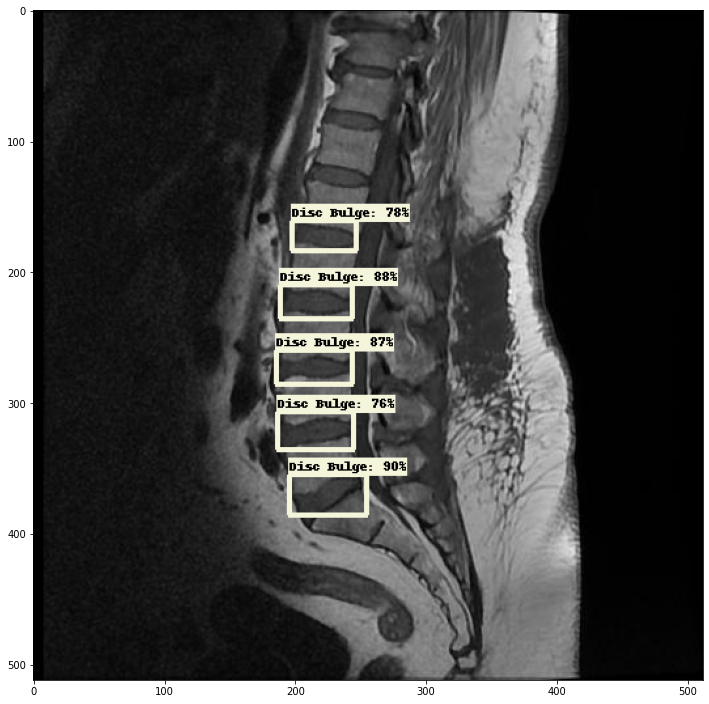

In [28]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
import random

TEST_IMAGE_PATHS = glob.glob('/content/test/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)
print(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32) 
detections, predictions_dict, shapes = detect_fn(input_tensor)  
label_id_offset = 1 
image_np_with_detections = image_np.copy()  
# Use keypoints if available in detections 
keypoints, keypoint_scores = None, None 
if 'detection_keypoints' in detections:
   keypoints = detections['detection_keypoints'][0].numpy()
   keypoint_scores = detections['detection_keypoint_scores'][0].numpy()
viz_utils.visualize_boxes_and_labels_on_image_array(
       image_np_with_detections,
       detections['detection_boxes'][0].numpy(),
       (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
       detections['detection_scores'][0].numpy(),
       category_index,
       use_normalized_coordinates=True,
       max_boxes_to_draw=200,
       min_score_thresh=.30,
       agnostic_mode=False,
       keypoints=keypoints,
       keypoint_scores=keypoint_scores,
       #keypoint_edges=get_keypoint_tuples(configs['eval_config'])
       )
plt.figure(figsize=(12,16)) 
plt.imshow(image_np_with_detections) 
plt.show()



## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)


In [38]:
# mount drive
from google.colab import drive
drive.mount('/content/gdrive')
import cv2

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


SpondylodegenerativeChanges-Unknown10Unknown10--24-_jpg.rf.82e2ef3da35ec7331c5e3d9d8352e7dc.jpg


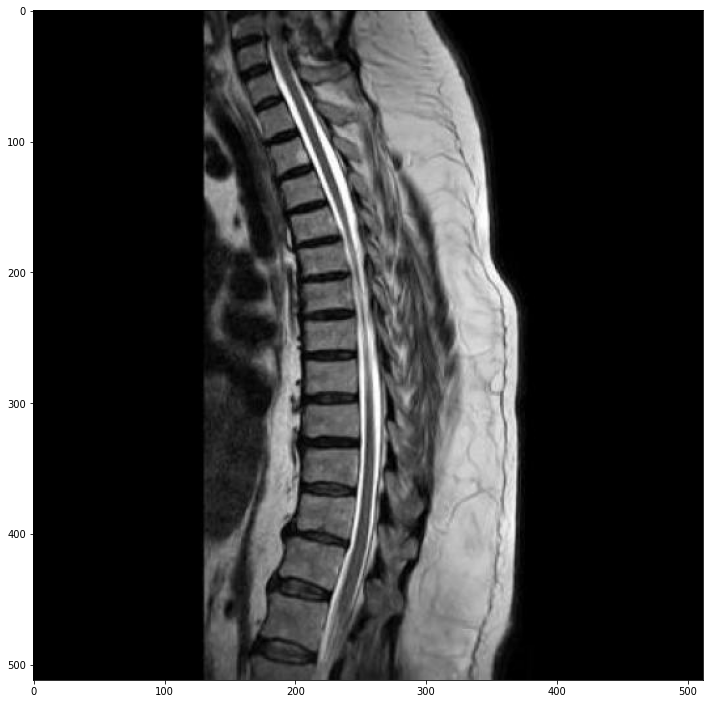

CervicalDegenerativeDiscDisease-Unknown2--24-_jpg.rf.ff8e4d045df2d52df645efa8e2be3ca4.jpg


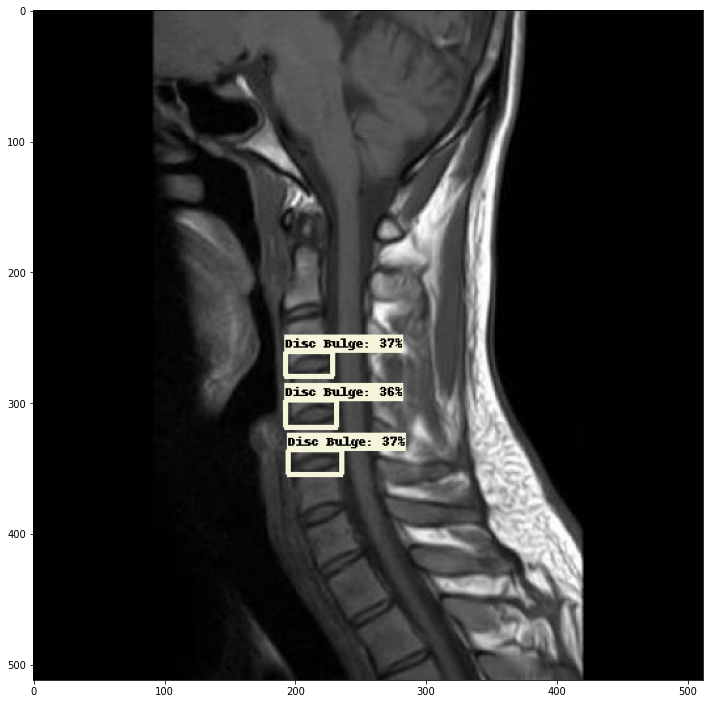

ABD-ALSALAM-YUSRY-MAHMOUD-ABO-SHADY-6-_jpg.rf.78c07f56b6208bb80264c2b5882ec021.jpg


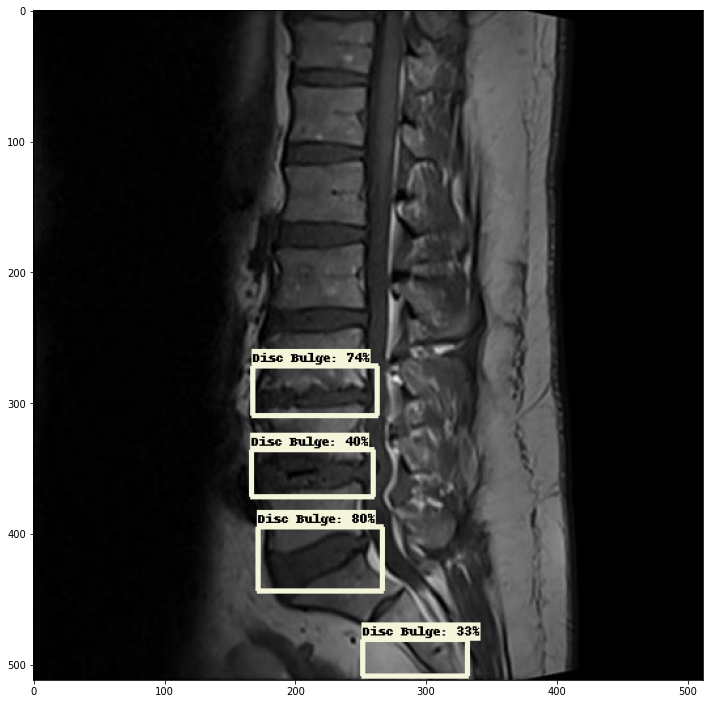

-65-_jpg.rf.73520ca007c7ed2007f13a7e6ffc42b2.jpg


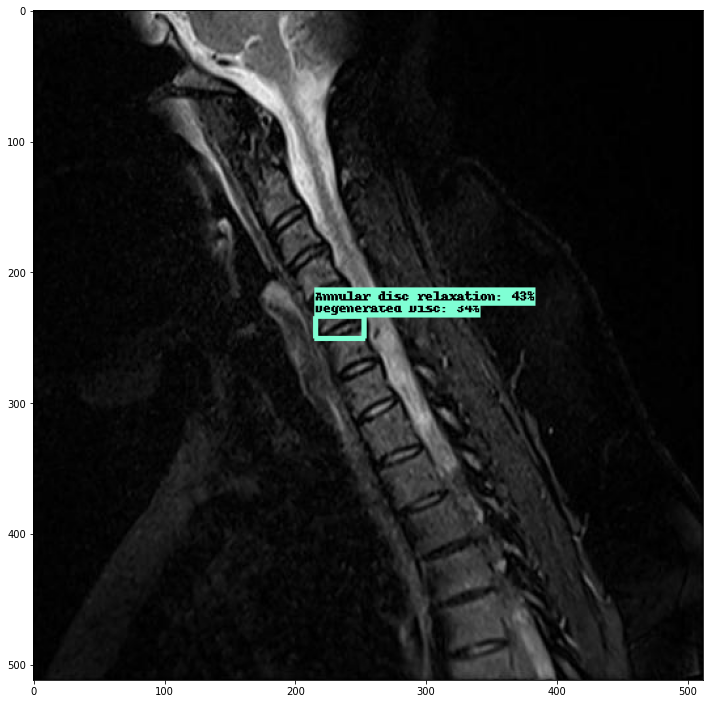

CervicalMultilevelDegenerativeDiscDisease-MAGDA-AHMAD-ALSAYED--2-_jpg.rf.c3ca2a82cde0dfb75fc97c7e3ea7b2f6.jpg


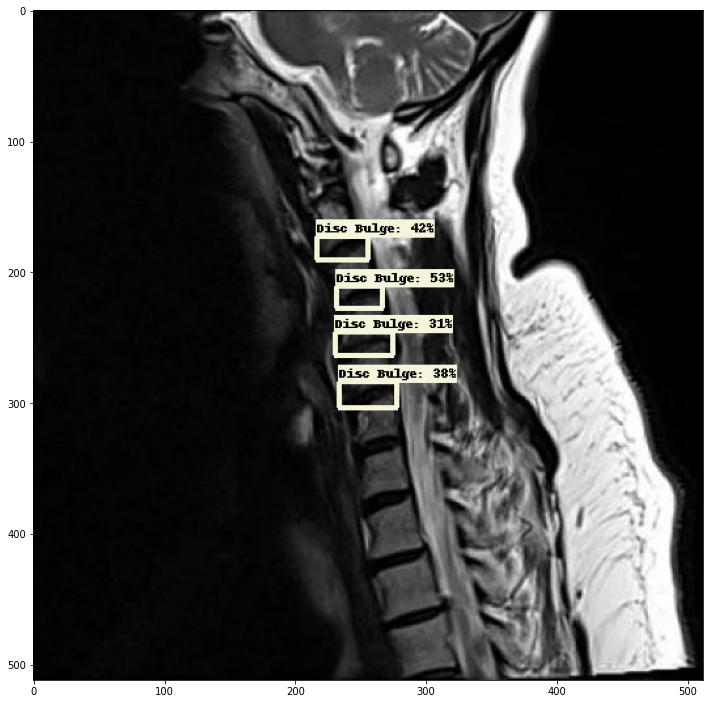

Unknown13--8-_jpg.rf.25829d54b57410aaa2f3e1fbbdf746b5.jpg


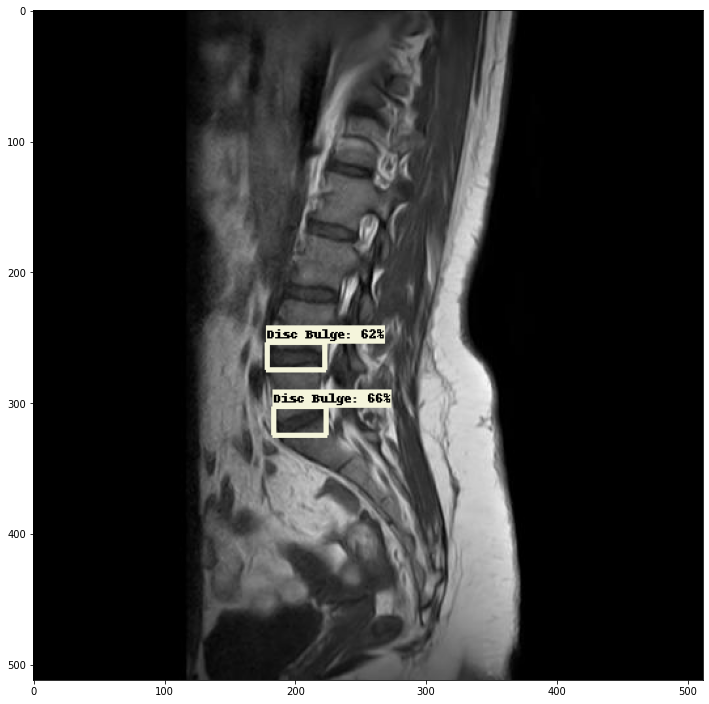

CervicalDiffuseDiscBulges-Unknown8--14-_jpg.rf.67289501dfeedc1cfb76daa0cd574e99.jpg


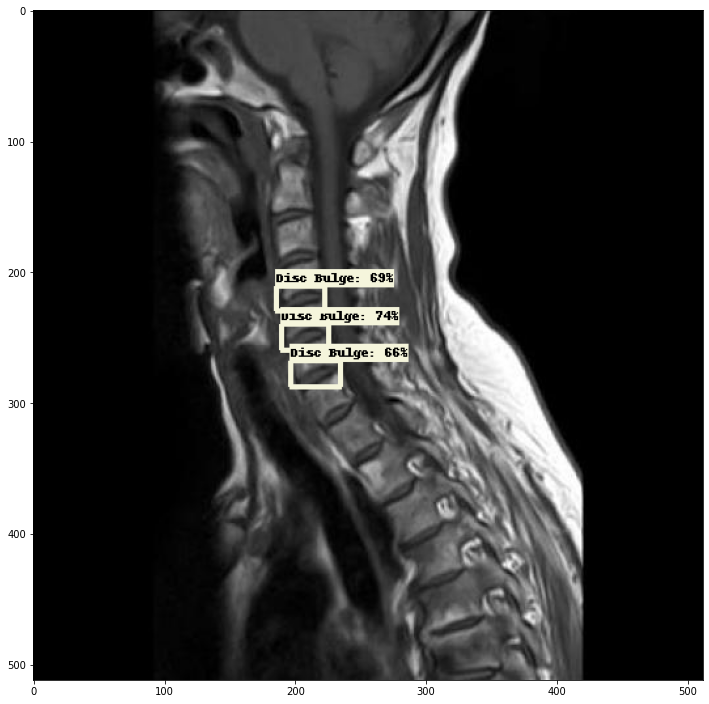

DiscProtrusion-Unknown5Unknown5--26-_jpg.rf.ade2516bb92ad19d1034466803f41457.jpg


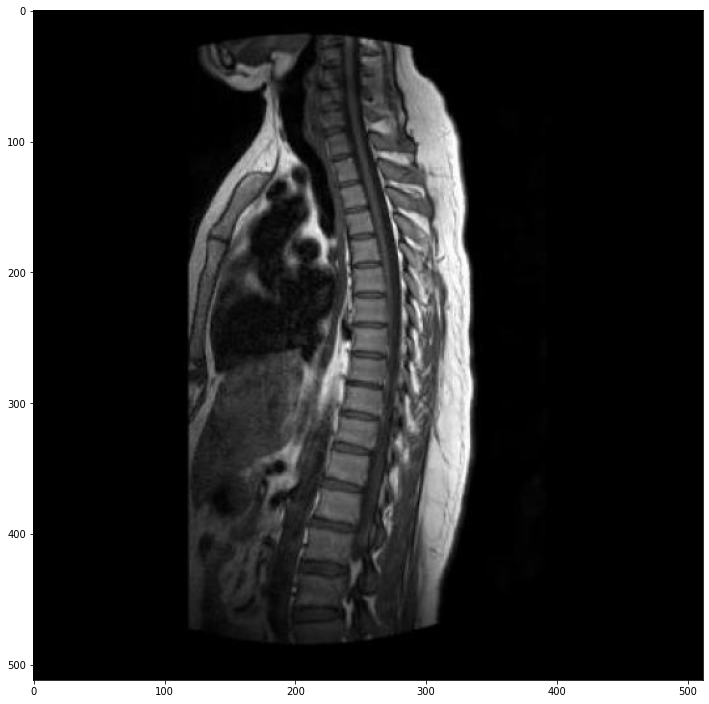

Multilevel-Degenerative-Disc-Disease-Unknown3--197-_jpg.rf.33c1fd26ecb903dc358b2d4d41b7207b.jpg


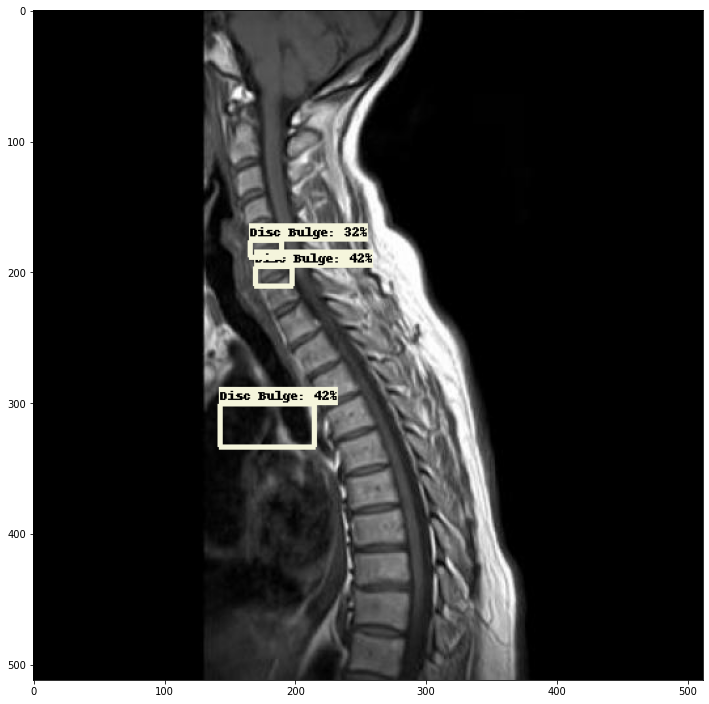

ASHRAF-SAYED-ABD-alal-BAKHEET-13-_jpg.rf.13134da53c4455c6e46bc34ae485337a.jpg


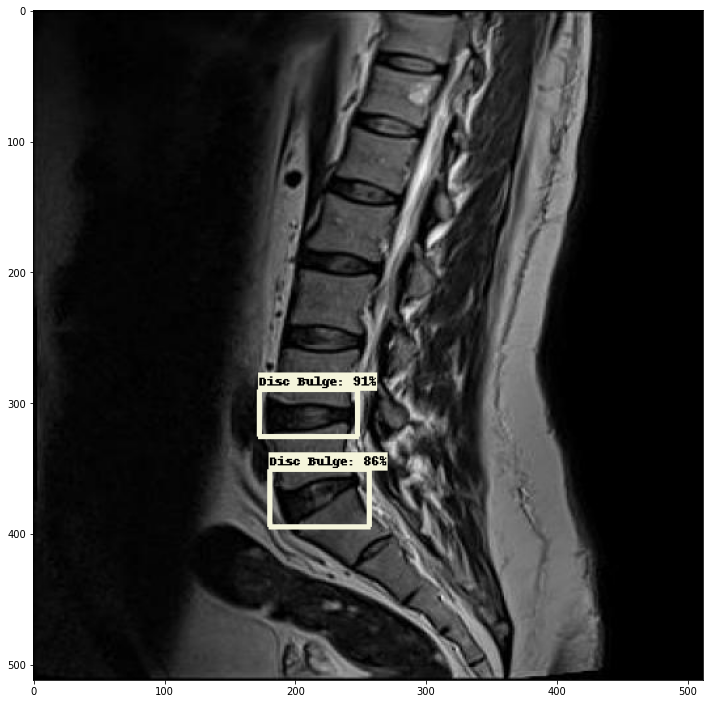

Multilevel-Degenerative-Disc-Disease-Unknown6--461-_jpg.rf.952238869118f985346515d936bd8549.jpg


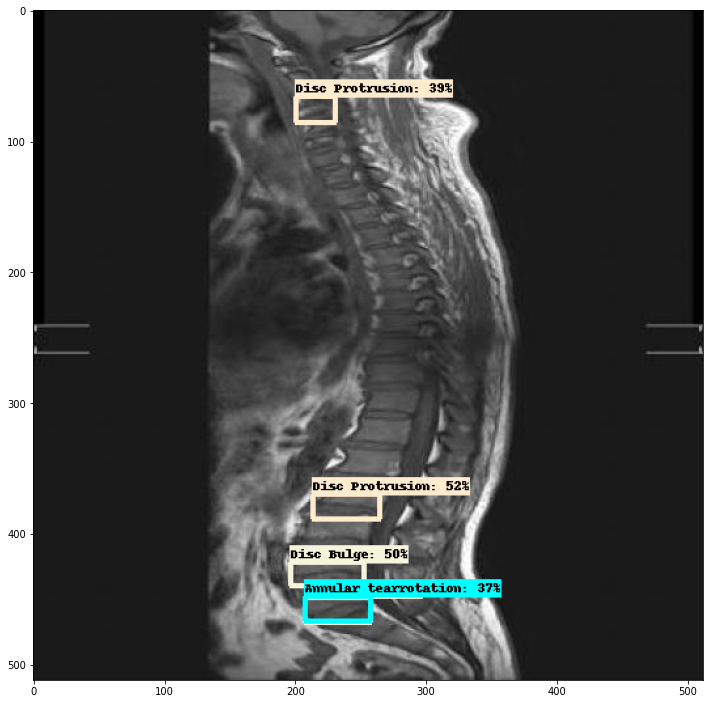

AYMAN-HESSIEN-ABD-alal-ABD-alal-7-_jpg.rf.fec2f3f5a24728a1fd5f666ac845ddff.jpg


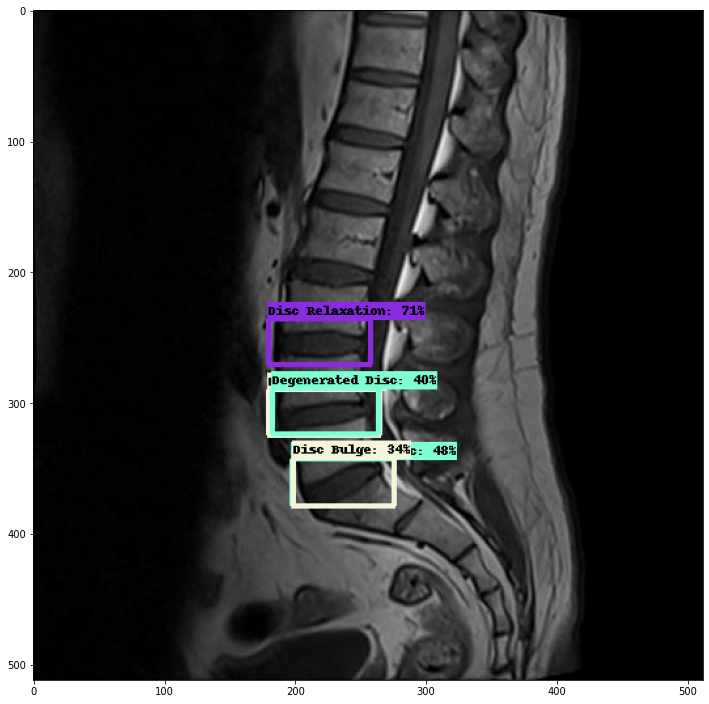

Unknown13--7-_jpg.rf.eaee7ab39b0b3869996978ffffa19ce5.jpg


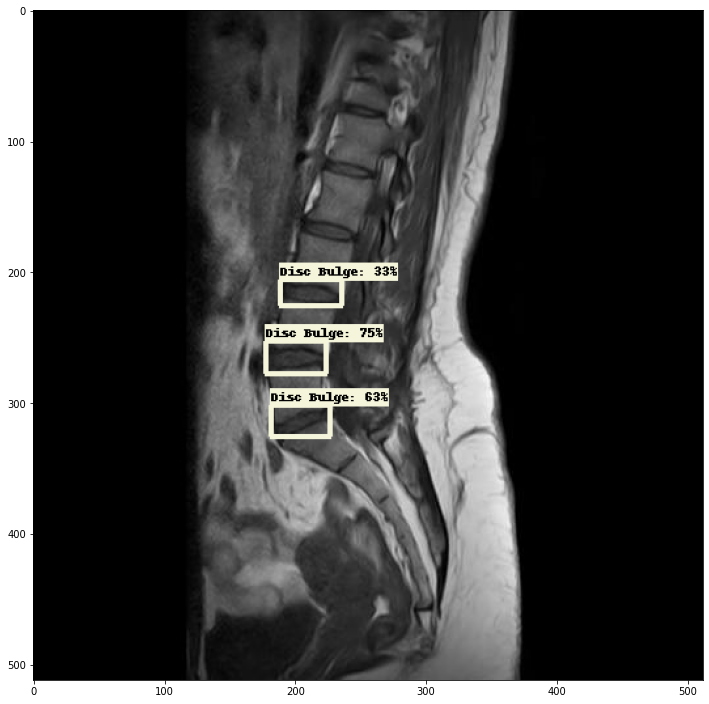

DiscProtrusion-Unknown5Unknown5--1-_jpg.rf.a8a9e4a61043584c0ff4ccaa890cf500.jpg


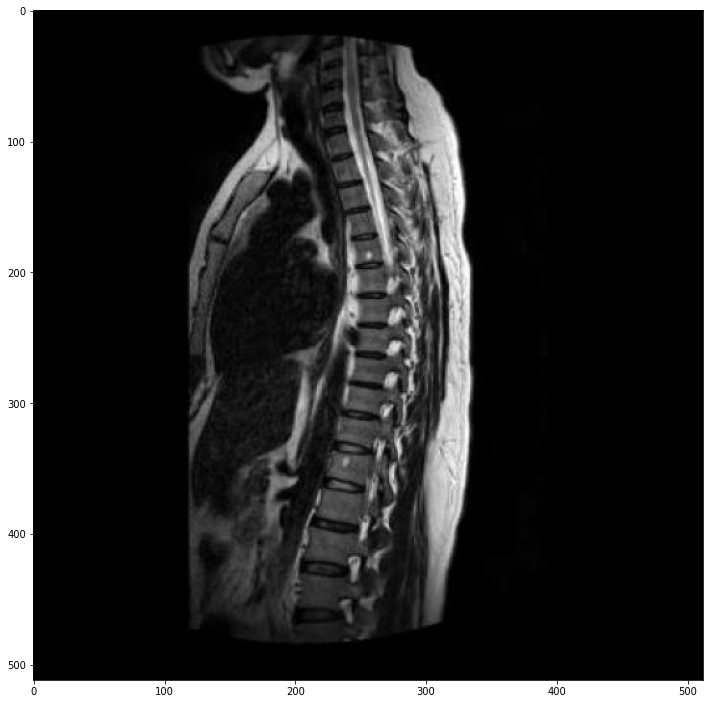

JAMAH-FATEHI-ALDISOUQI-KHODIR-9-_jpg.rf.718fd742b2de5fe74c0eb699a55d68f1.jpg


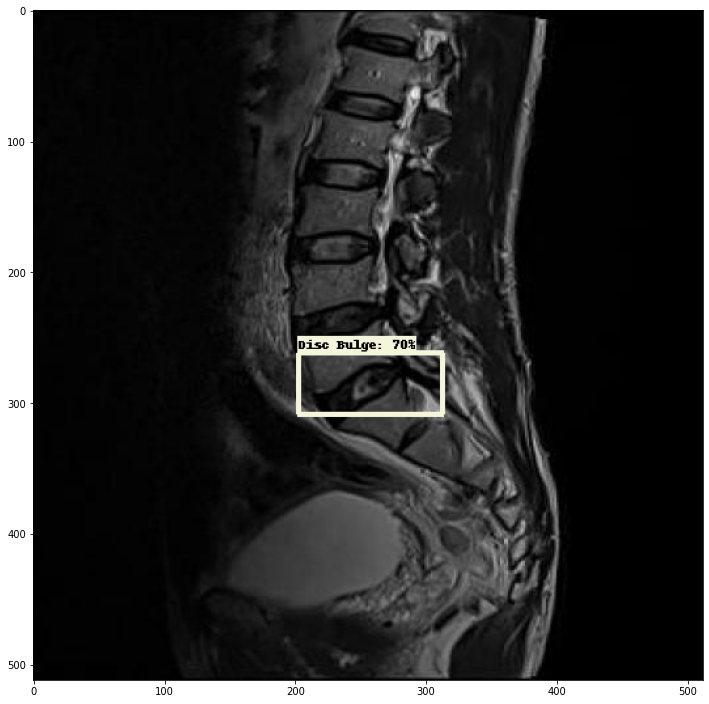

Multilevel-Degenerative-Disc-Disease-Unknown3--1-_jpg.rf.98264f2c35e097f11e1798e1fd5e9886.jpg


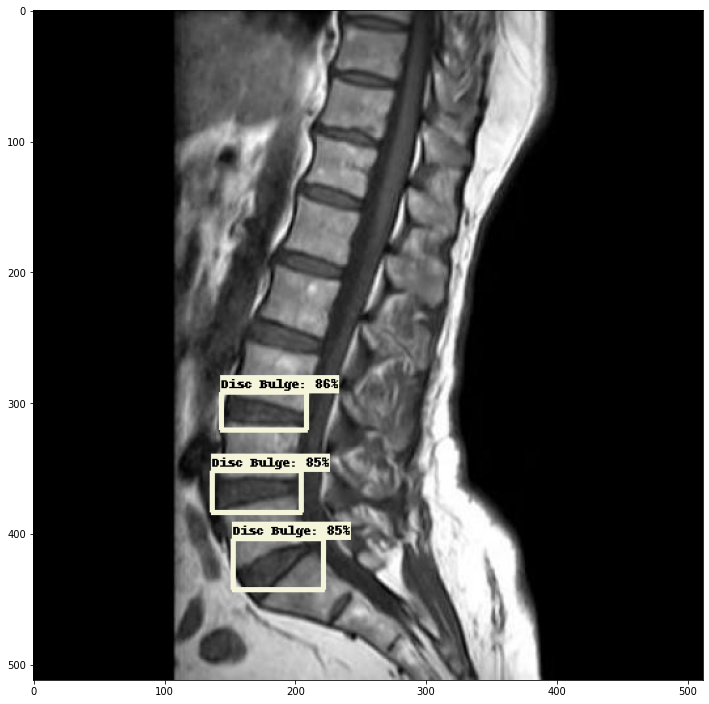

CervicalSpondylodegenerativeChanges-TAHNI-MOHAMED-YOUSIF-SOLAIMAN--57-_jpg.rf.0fdf1e05a4582b6f3a0d7ef81cb11c3a.jpg


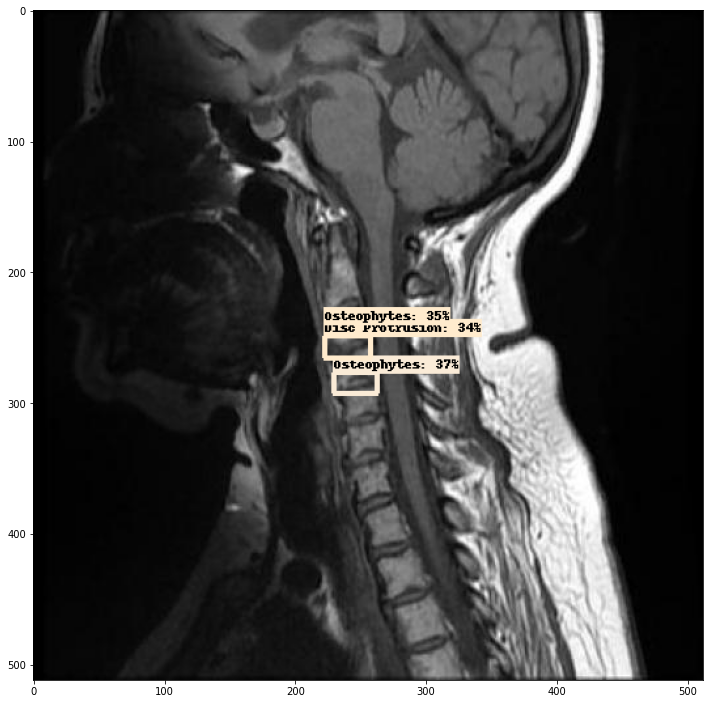

CervicalDiffuseDiscBulges-AHMAD-MOHAMED-KAMAL-ABD-AL-AZIZ--13-_jpg.rf.424e7531066c6a551ac0cf6da39c26b0.jpg


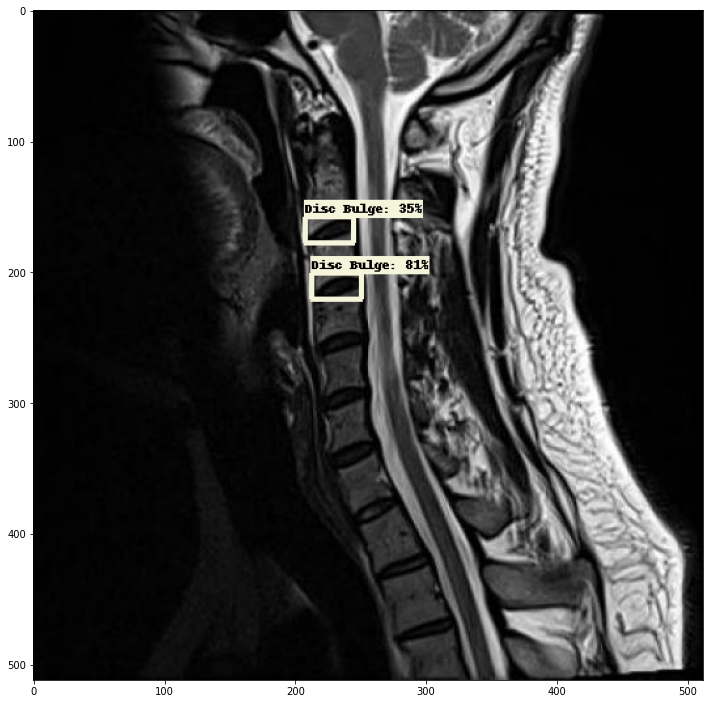

CervicalDiffuseDiscBulges-Unknown7--5-_jpg.rf.ede8eced7a825da98390fed20a7777d5.jpg


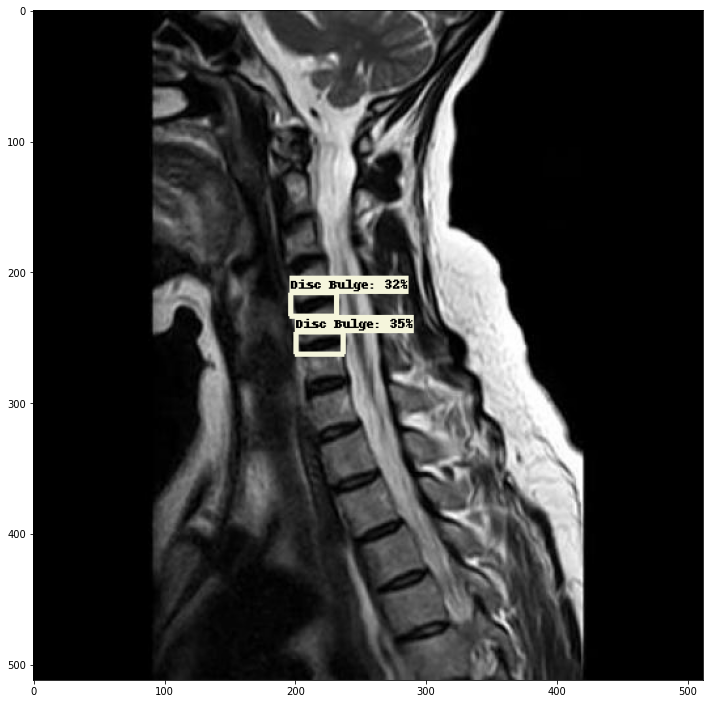

SpondylodegenerativeChanges-HESSIEN-HASAN-ABD-alkadr--5-_jpg.rf.f7ced1c0cb8bf7980429a959875c495a.jpg


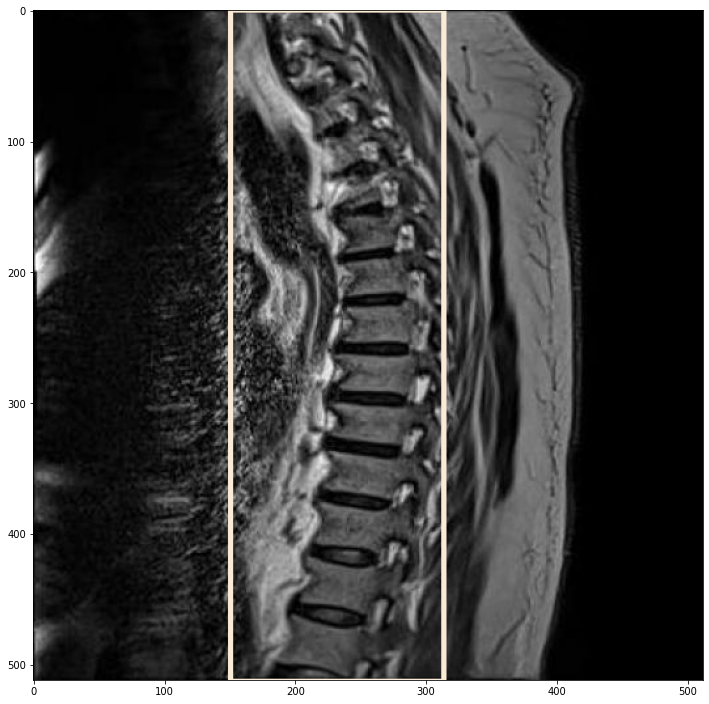

CervicalDiffuseDiscBulges-AHMAD-MOHAMED-ABD-ALRAHMAN--17-_jpg.rf.4393432e284c7de9a593051833eaf77d.jpg


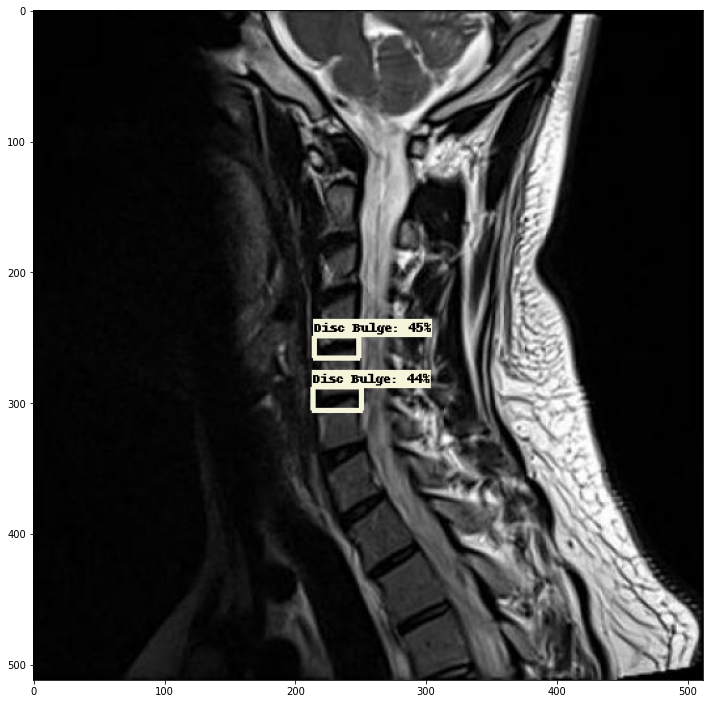

Diffuse-Disc-Bulge-Unknown2--47-_jpg.rf.82f35aeef482745dbd8d5f00657dd72b.jpg


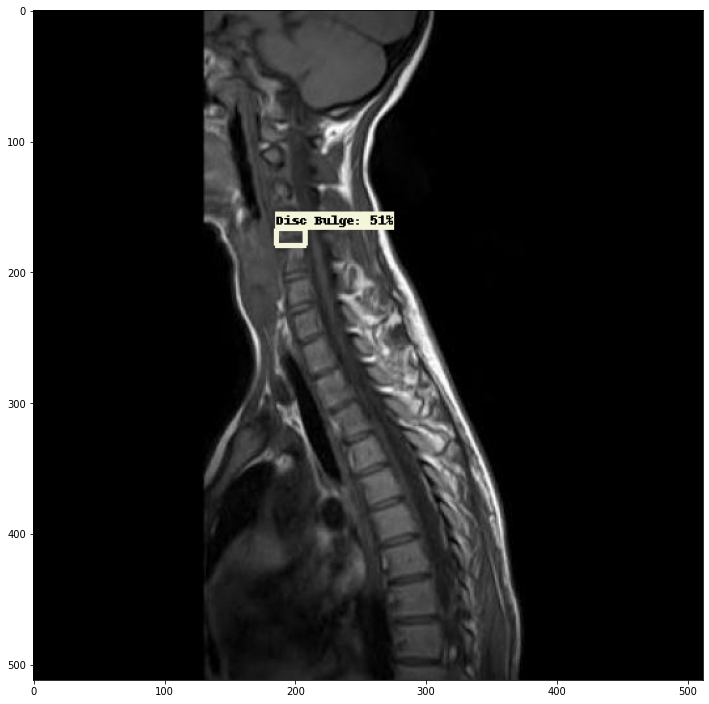

SpondylodegenerativeChanges-Unknown10Unknown10--22-_jpg.rf.755488d2c8edaf901bdfaef578003f75.jpg


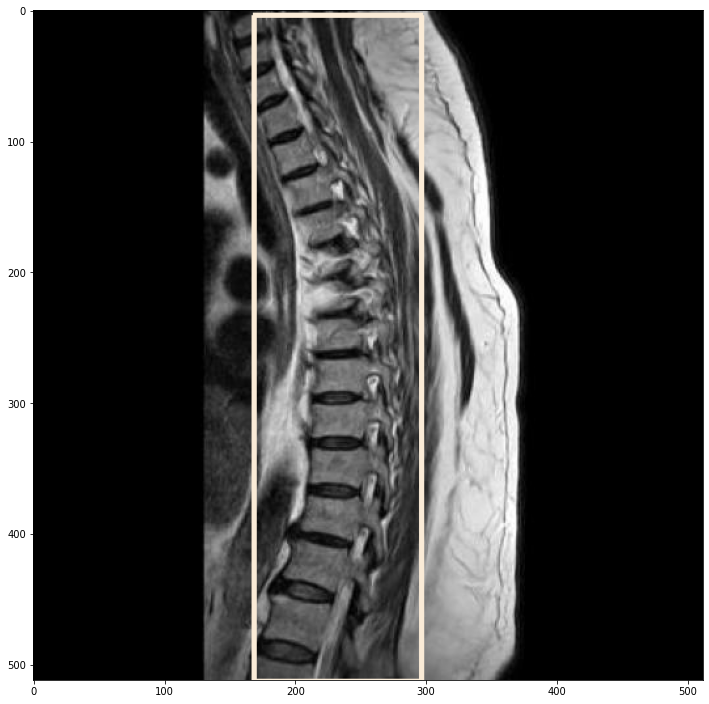

CervicalDiffuseDiscBulges-AHMAD-MOHAMED-KAMAL-ABD-AL-AZIZ--24-_jpg.rf.4bbb50ad23f3e6160c5380423ebda55b.jpg


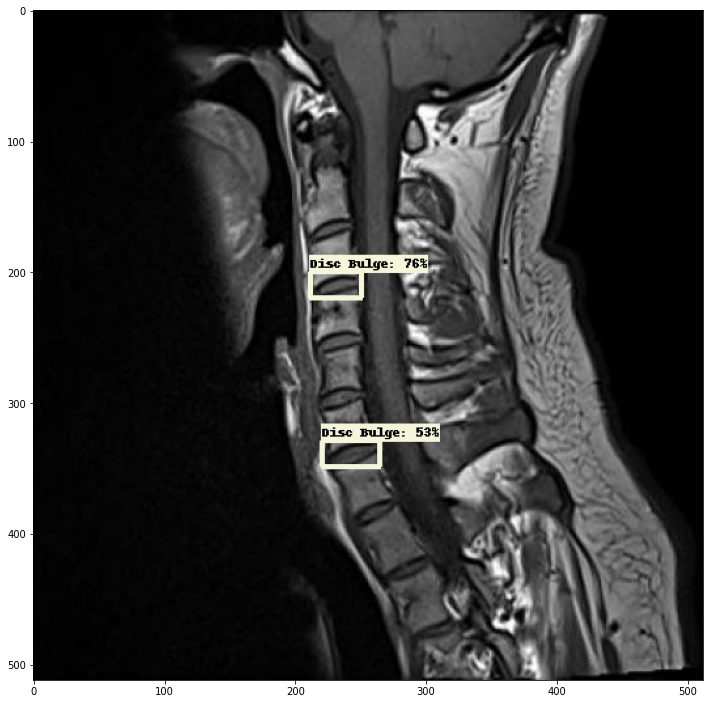

Unknown4--10-_jpg.rf.f27b52c730dd5dff7d23ca1ba252c91e.jpg


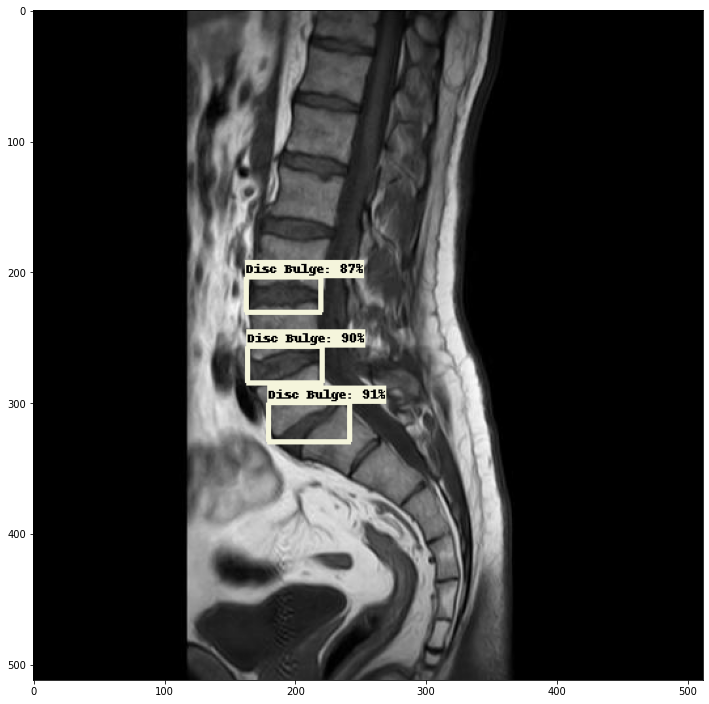

Unknown14-Unknown14-9-_jpg.rf.43c36275953d58be3af36e5fc3e27c1e.jpg


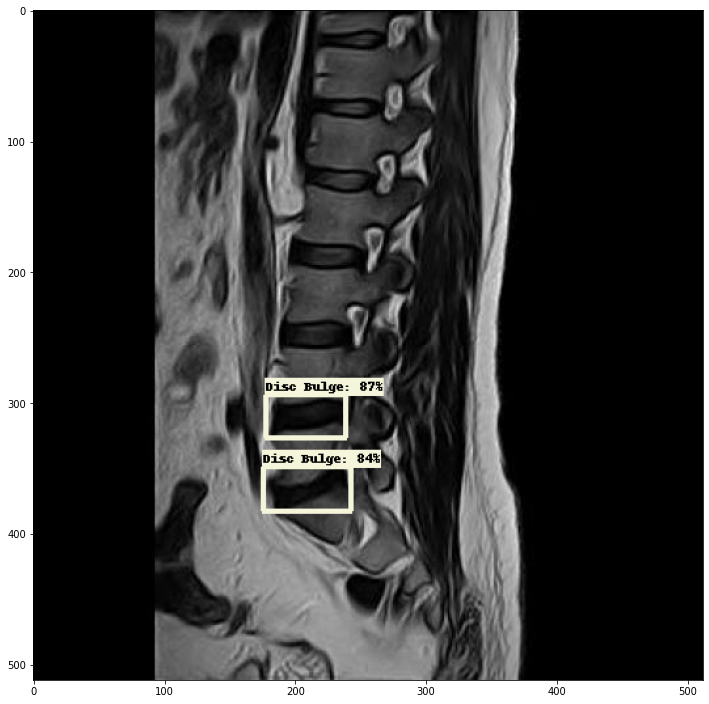

SALAH-ELDEEN-AHMAD--5-_jpg.rf.463600de7fddb3923df625d038dc16c8.jpg


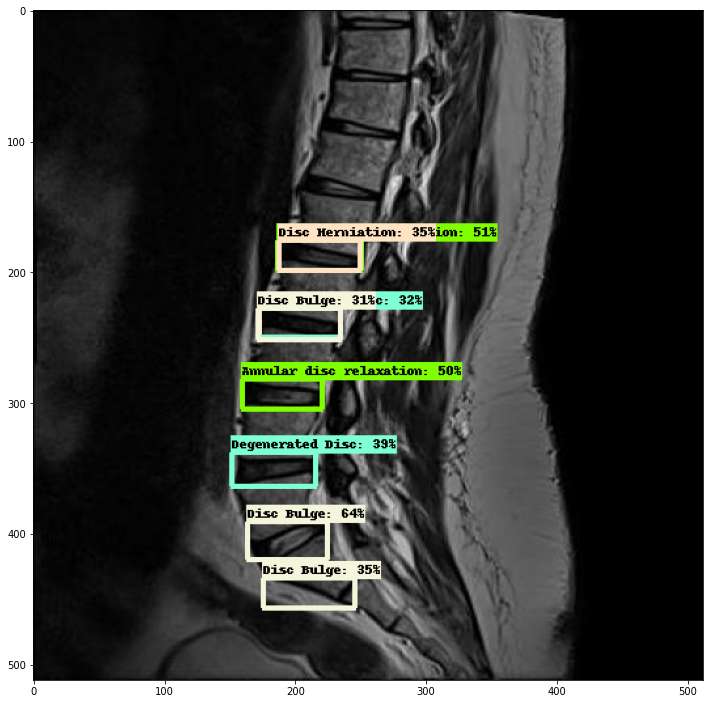

AMAL-RABEA-ALKELANY-IBRAHIM-SAKAR-9-_jpg.rf.2b0efca8be790d0147c6c904ed96e534.jpg


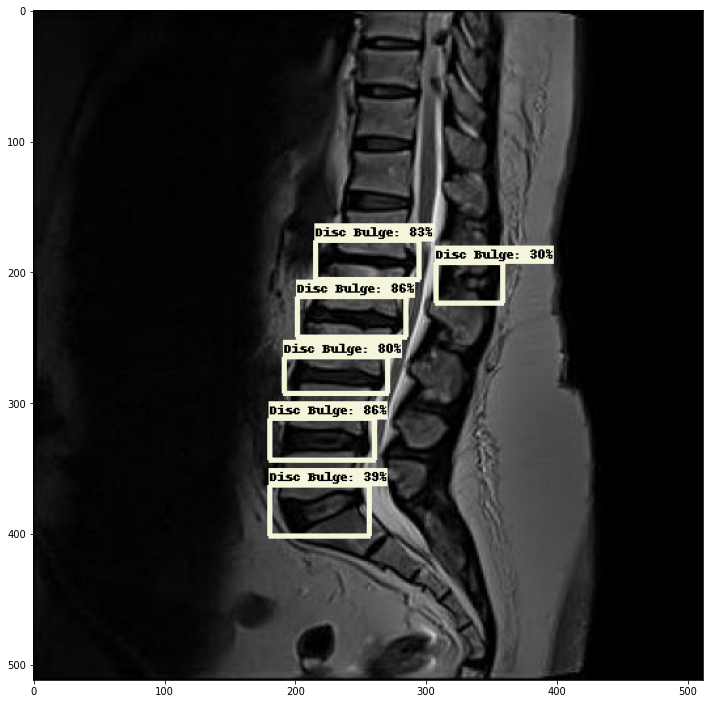

mroua-SALAH-ABD-alhmid-IBRAHIM--1-_jpg.rf.153086b9f22249ce3e6262b1a341feba.jpg


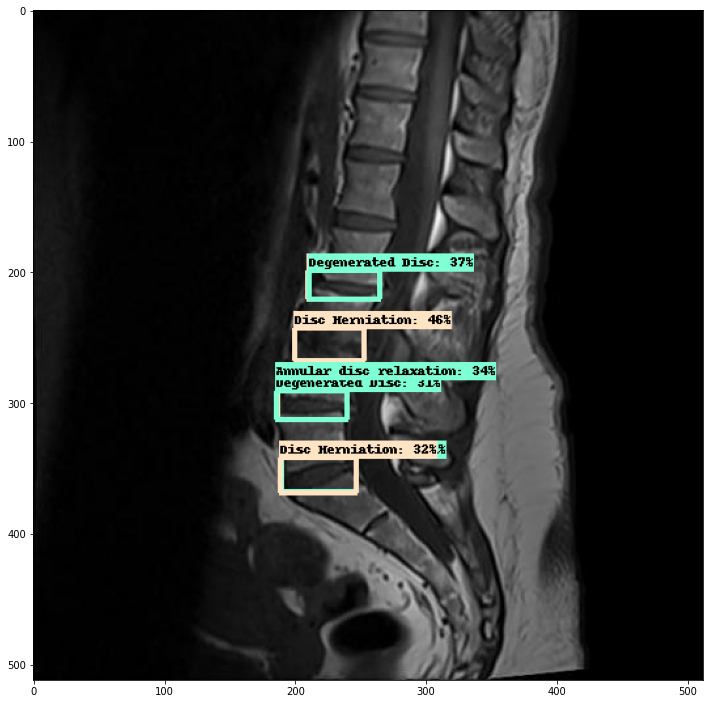

SpondylodegenerativeChanges-Unknown10Unknown10--1-_jpg.rf.0a2d13334dfbb7d1e35698ddf4951d2c.jpg


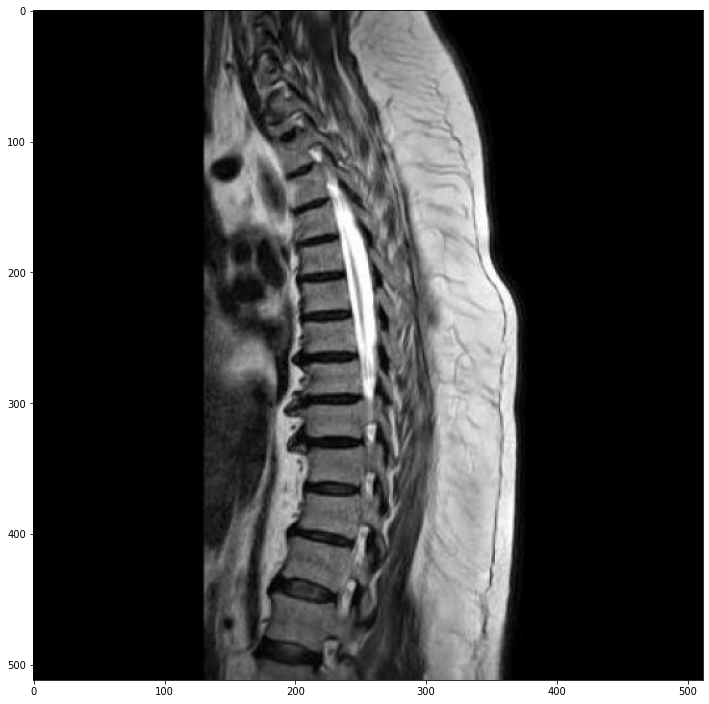

Diffuse-Disc-Bulge-Unknown2--133-_jpg.rf.12d6326cbf6e86a8e1edd03e4d199647.jpg


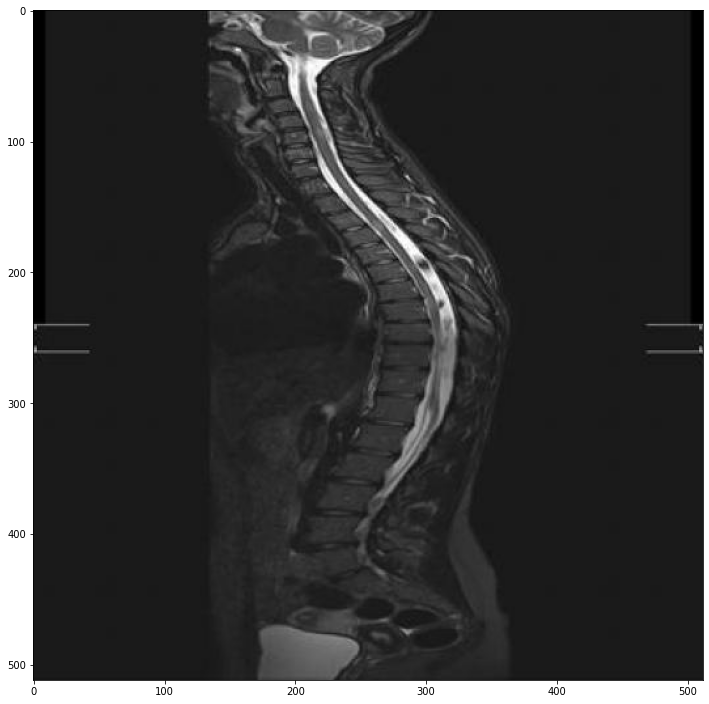

Unknown13--6-_jpg.rf.0736da273250225cf0b33ba6ffb0496a.jpg


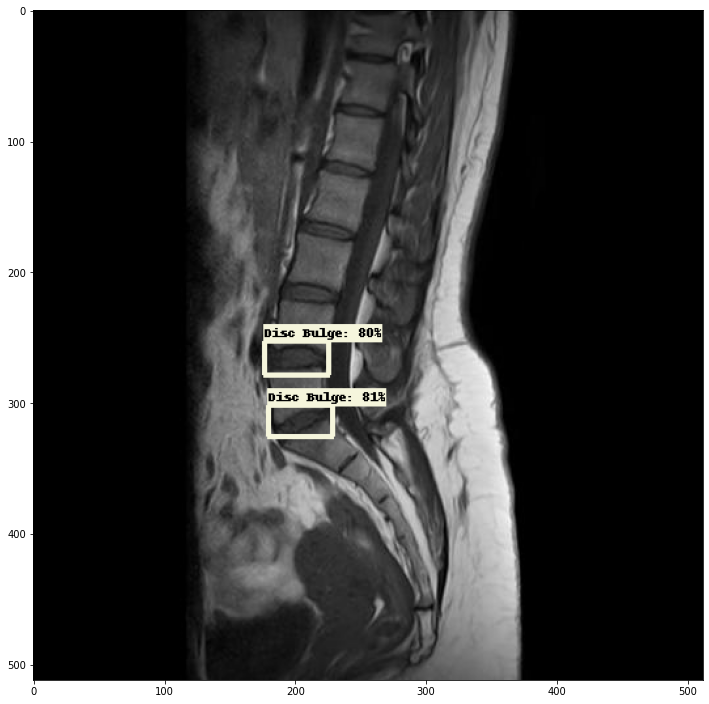

Unknown14-Unknown14-4-_jpg.rf.1d596be7124e47ef226d5ea9704a1b74.jpg


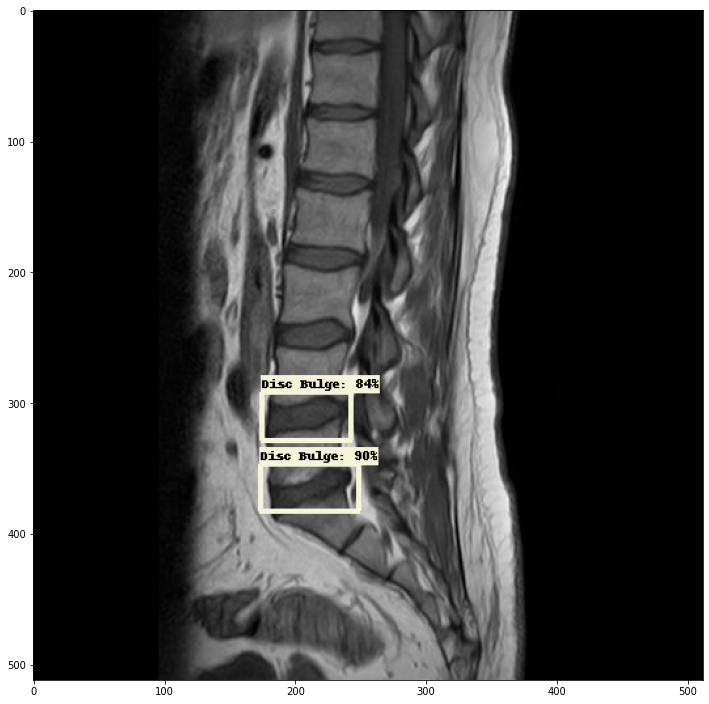

Unknown9--9-_jpg.rf.c17542206abe737a2d56fbc7db97ef1f.jpg


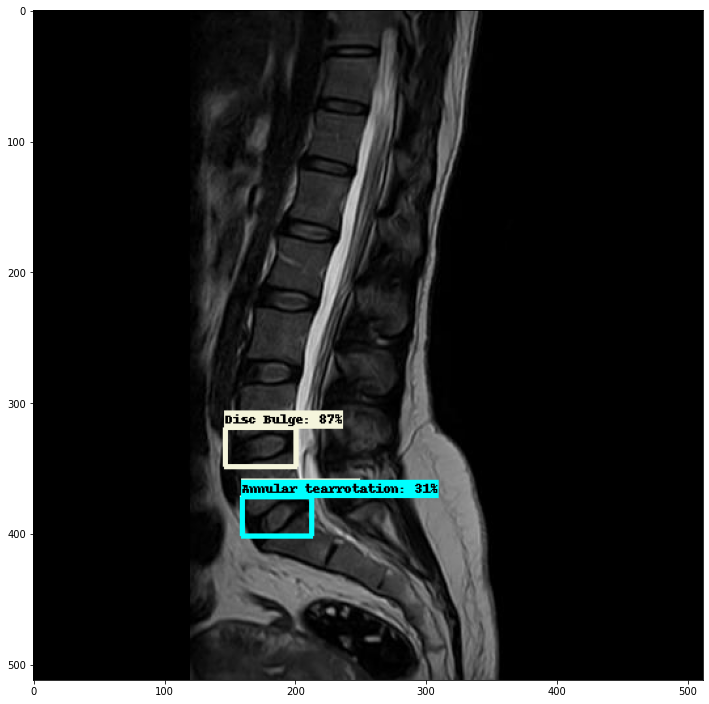

CervicalDegenerativeDiscDisease-Unknown5--8-_jpg.rf.0c69a7455732bbb308b9e7ac75021975.jpg


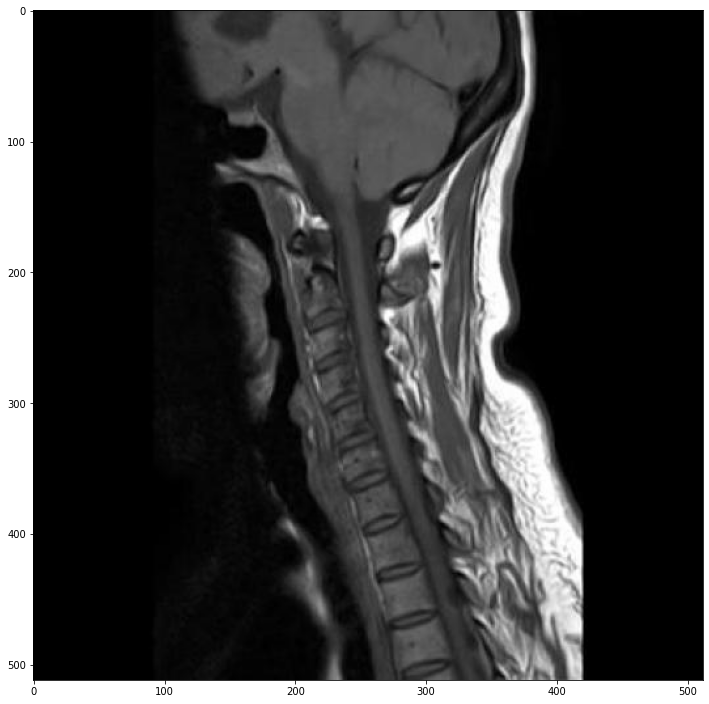

Unknown10--5-_jpg.rf.693824d3427329f667e3d46bbcde6d86.jpg


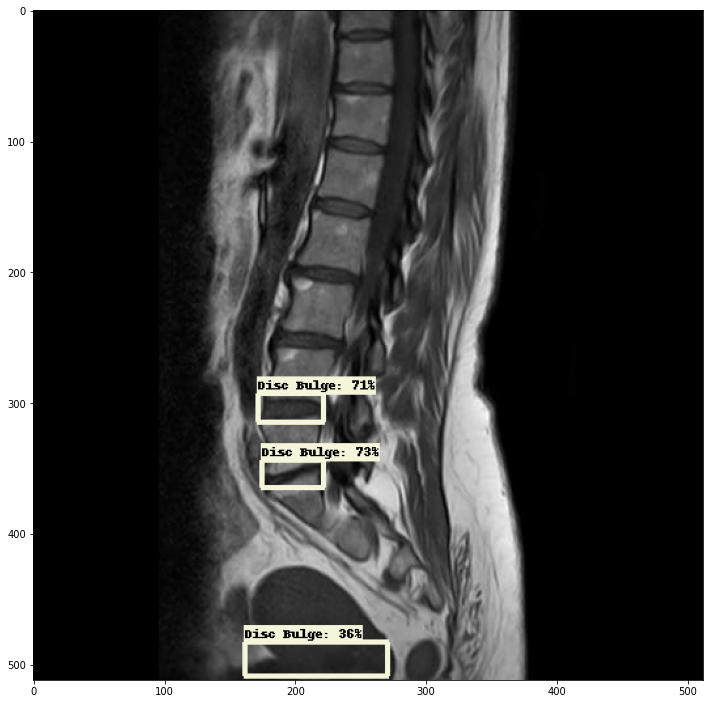

CervicalDiffuseDiscBulges-Unknown8--73-_jpg.rf.8941f5b5cfb5fe4e30ba740847812028.jpg


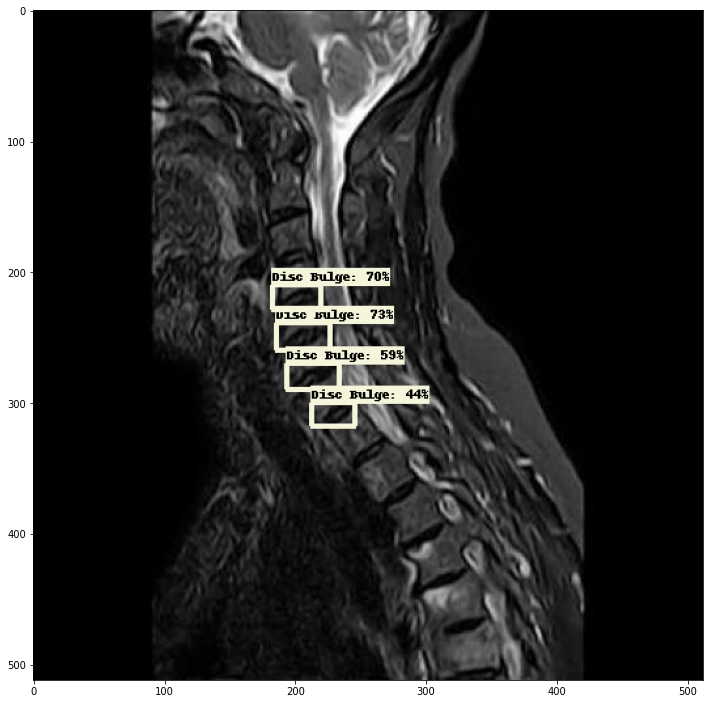

CervicalDiffuseDiscBulges-ATIYAT-ALSAYED-MOHAMED-HAMAAD--14-_jpg.rf.84488c39115f3dc8699d42b0f9ac6622.jpg


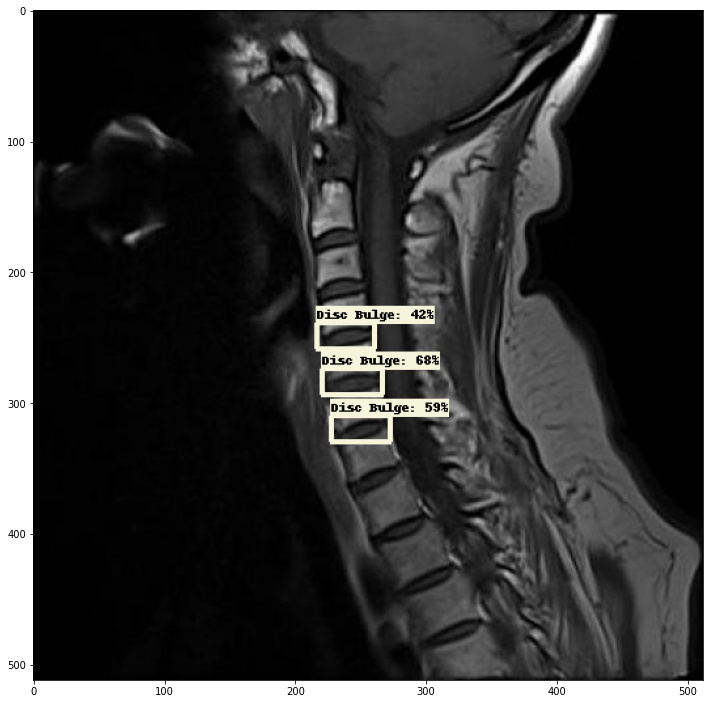

DiscProtrusion-Unknown5Unknown5--11-_jpg.rf.ad3a7ca8677b25cd3a8c1b6108a1a3ed.jpg


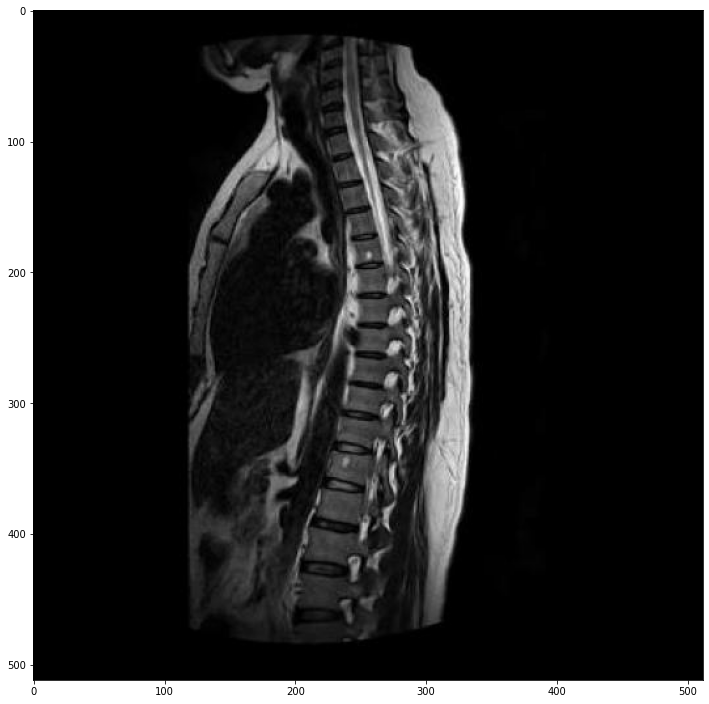

ABD-ALSALAM-YUSRY-MAHMOUD-ABO-SHADY-12-_jpg.rf.c2ac7b89390ad7f52b138ca997af603c.jpg


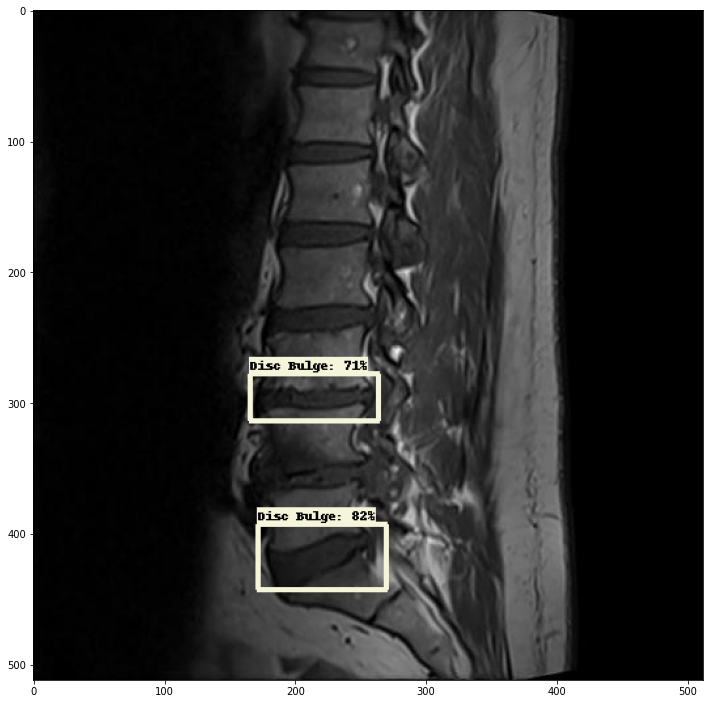

AEVON-EDUARDO-HABEAB-1-_jpg.rf.5346a9d23a31f015f4da35505500b317.jpg


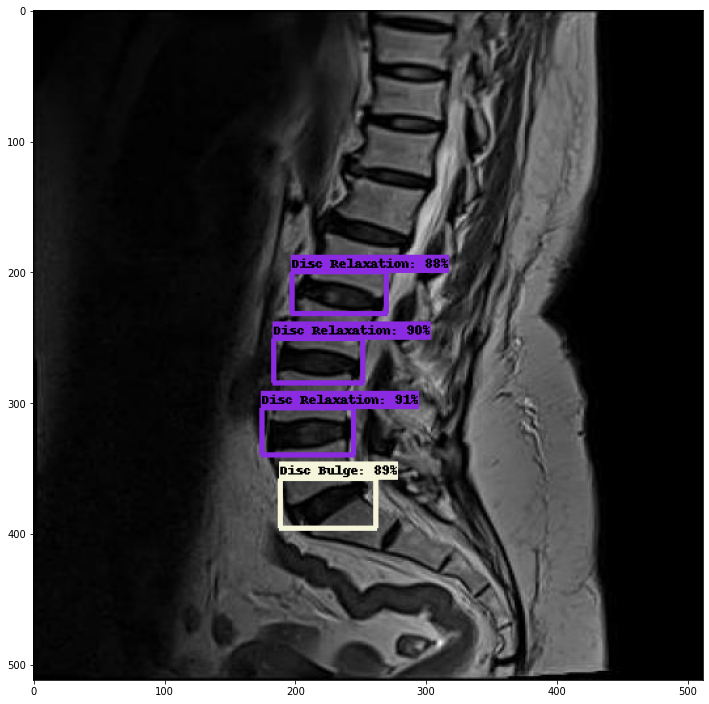

CervicalSpondylodegenerativeChanges-SAMMAH-MOSTAFA-KAMEL-MOHAMED--14-_jpg.rf.9a9d469e64636ea2216399faada273c6.jpg


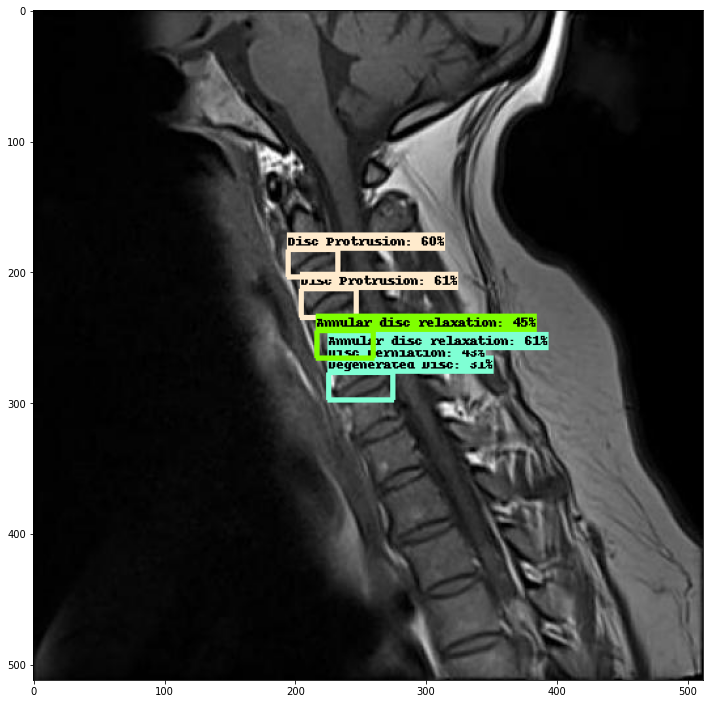

CervicalMultilevelDegenerativeDiscDisease-MONA-IBRAHIM-KHAMES-KHALAL--22-_jpg.rf.e35d5cb1c3c94908a698b841cadcb53c.jpg


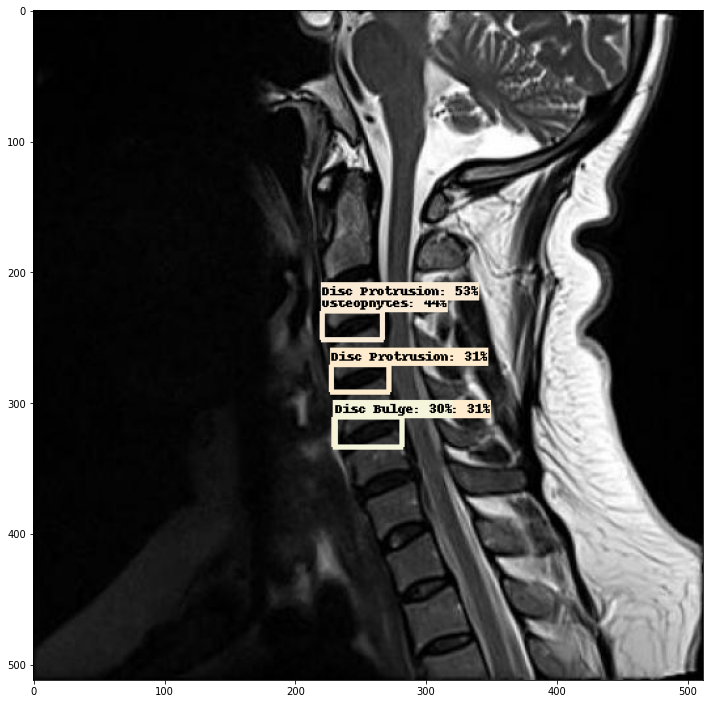

Multilevel-Degenerative-Disc-Disease-Unknown6--228-_jpg.rf.1b165bc825ae21d1b23597f95848436c.jpg


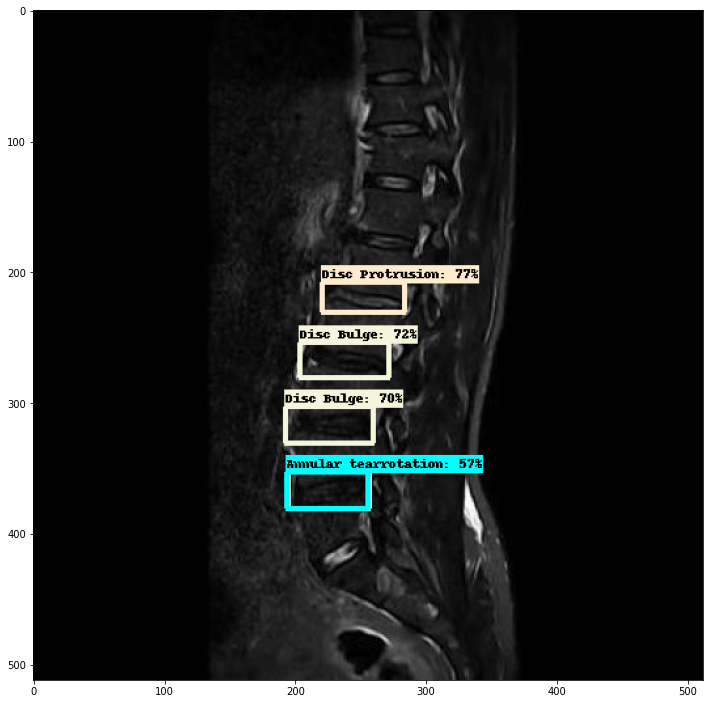

Unknown8--4-_jpg.rf.4804f52714cca5b6c57211eed91fd7c6.jpg


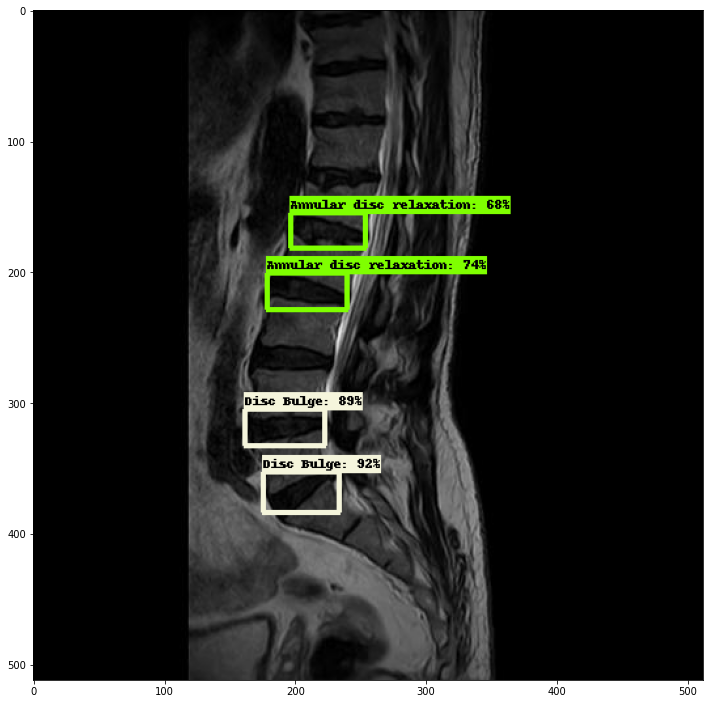

Unknown17-Unknown17-1-_jpg.rf.6383e98db1ebecf0a1bf3713bc9a6f4e.jpg


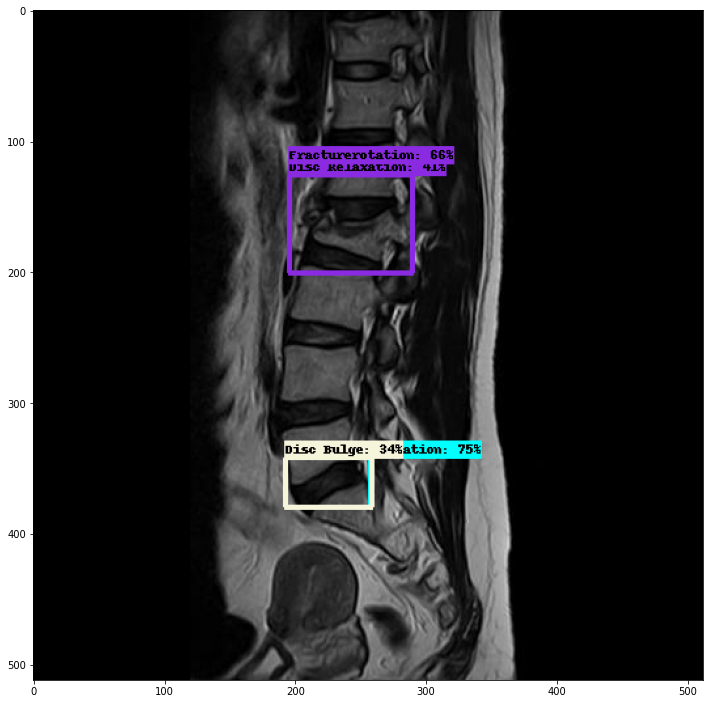

DiscProtrusion-Unknown5Unknown5--39-_jpg.rf.0a84d47daaad44116a67a9949c44786b.jpg


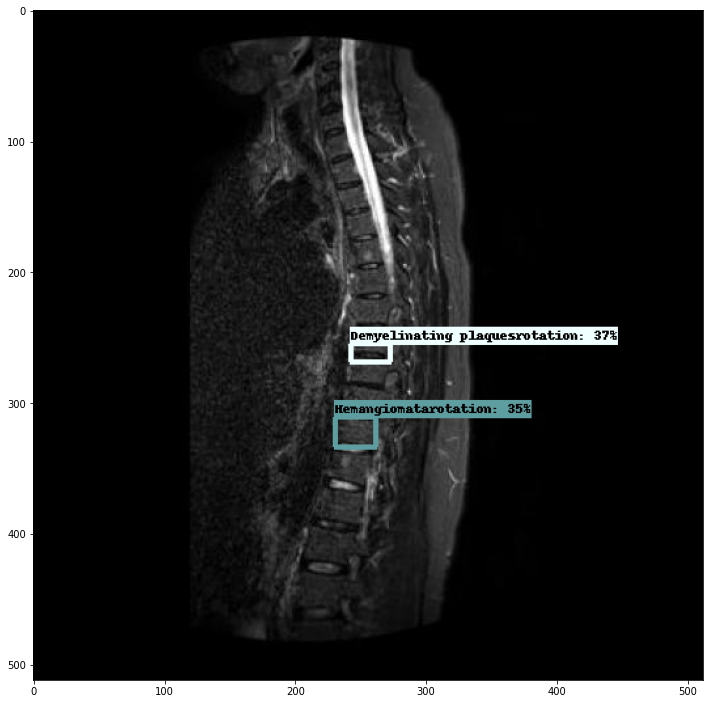

MONA-MAHMOUD-HASAN-MOHAMED-SHAABAN--5-_jpg.rf.918df763921387a53c563347745ce4f5.jpg


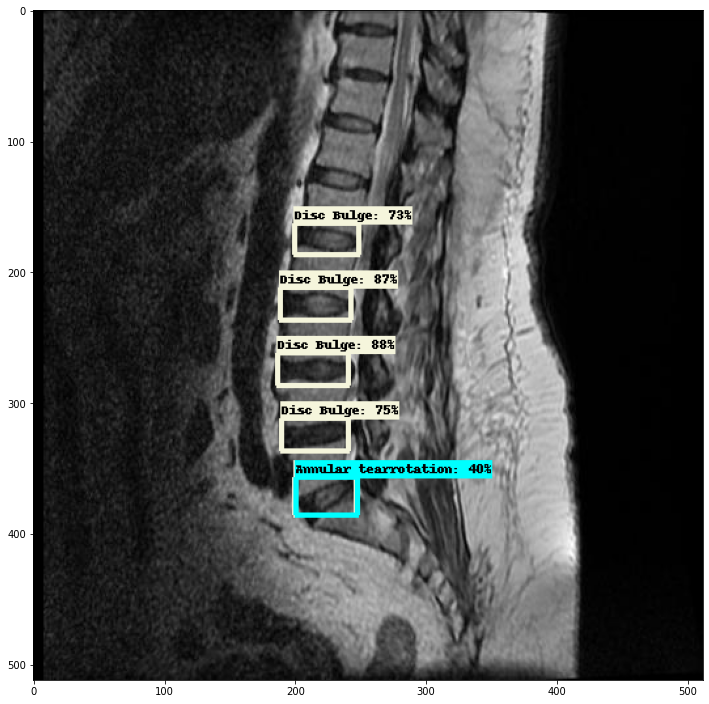

CervicalDegenerativeDiscDisease-EMAD-ABD-alhkm-ABD-ALHAKIM--4-_jpg.rf.2e953b532e92ce173cbef339d0944e9c.jpg


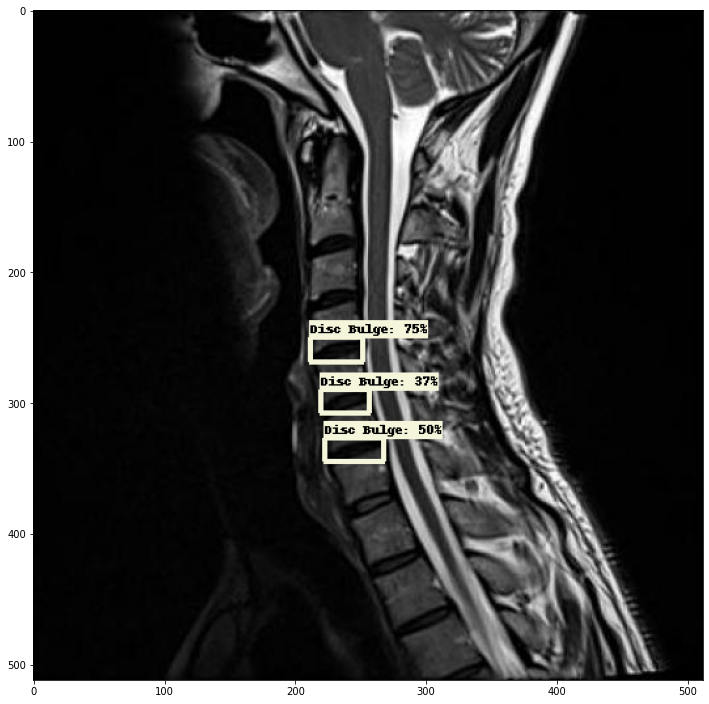

Unknown17-Unknown17-11-_jpg.rf.1149c285ecb0de8459948e2b4f69d098.jpg


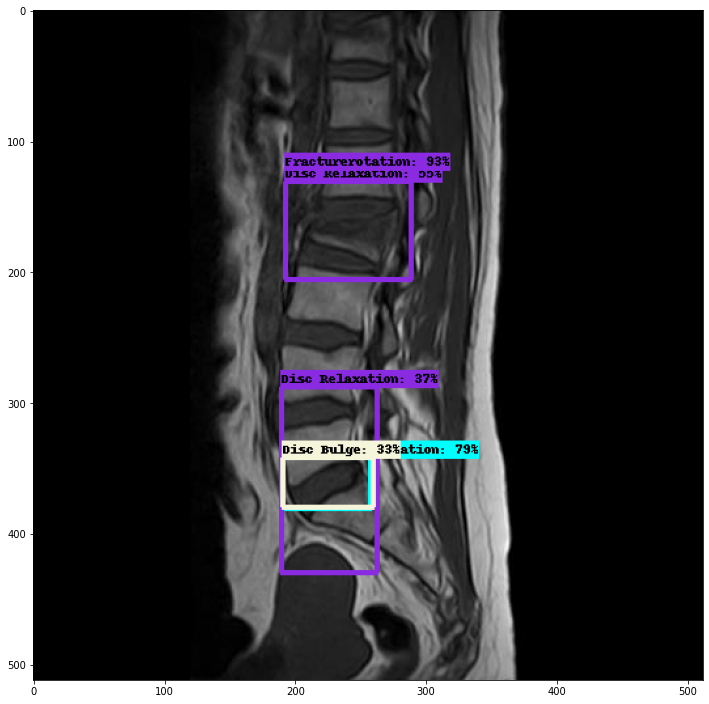

Diffuse-Disc-Bulge-Unknown2--89-_jpg.rf.0b2bc0d4a2875e602b68bf8841d54bac.jpg


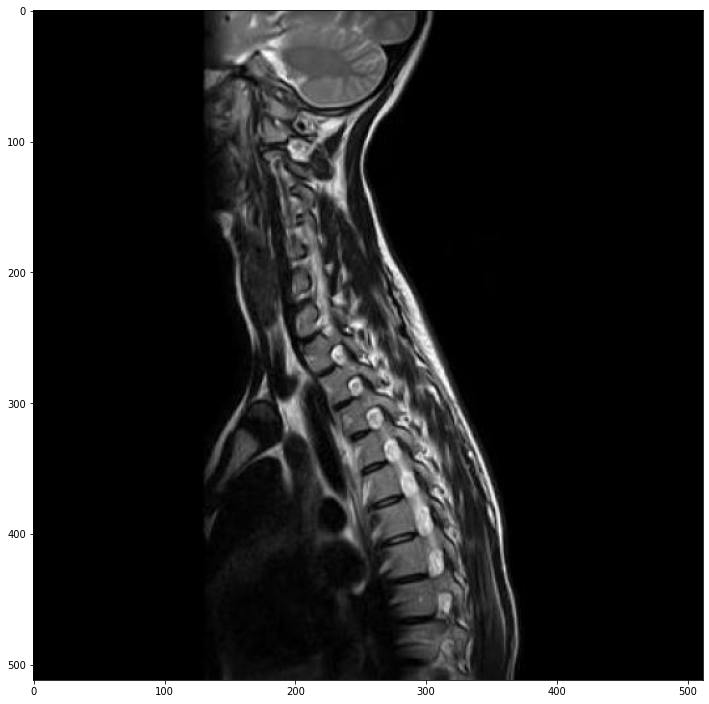

CervicalSpondylodegenerativeChanges-FWAKH-MOHAMED-METWALY-ALSAYED--16-_jpg.rf.4f0f166bdd3b423b68f38b358228350a.jpg


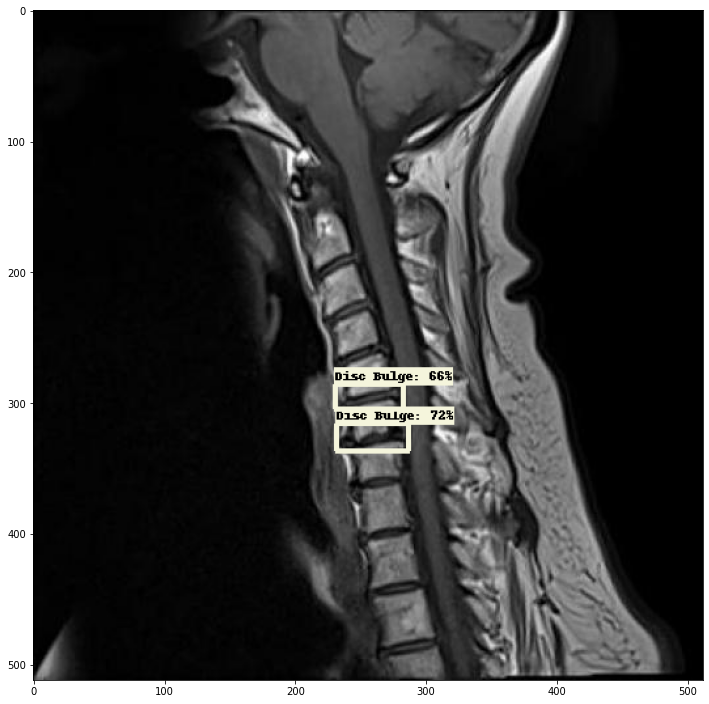

CervicalSpondylodegenerativeChanges-DOAA-HAMDE-ABD-AL-AZIZ-ALSAYED--20-_jpg.rf.fead96f2473e93268fd4c66a9f581bd4.jpg


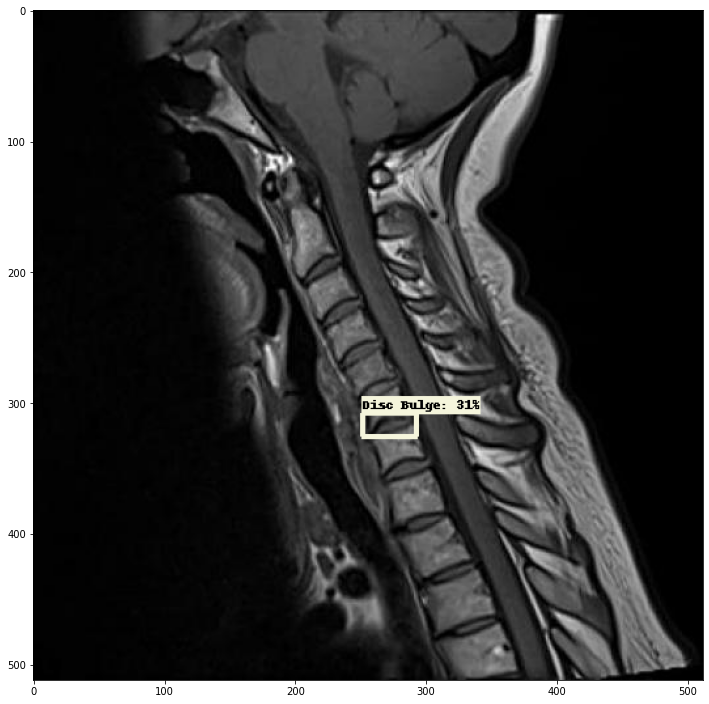

AMAL-RAGAB-ALSAMMAN-ALI-5-_jpg.rf.70704fb448082e2f1caed4434cf1914d.jpg


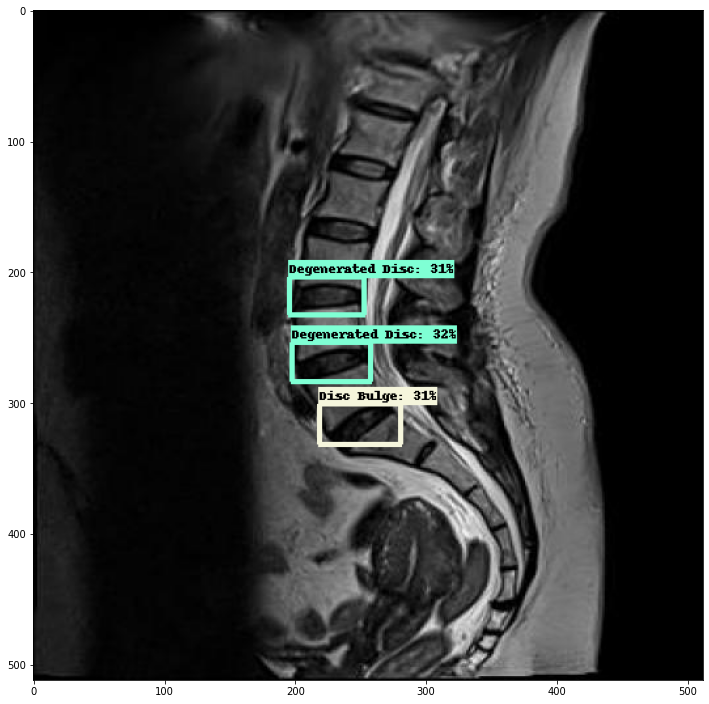

Diffuse-Disc-Bulge-Unknown2--122-_jpg.rf.5a9e8e7182a942626aba012af55ca44c.jpg


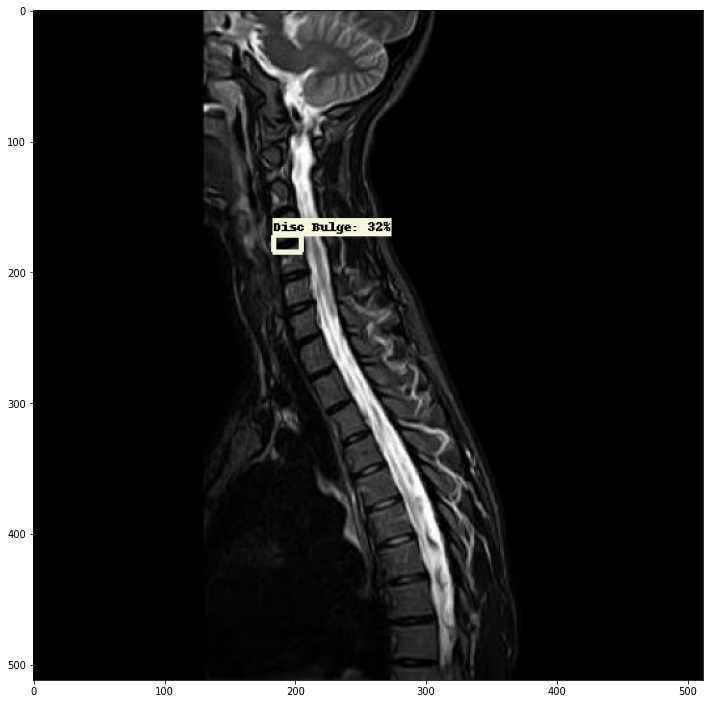

ABD-ALSALAM-YUSRY-MAHMOUD-ABO-SHADY-14-_jpg.rf.025f3e8f95584d6de3bac8633ee80d14.jpg


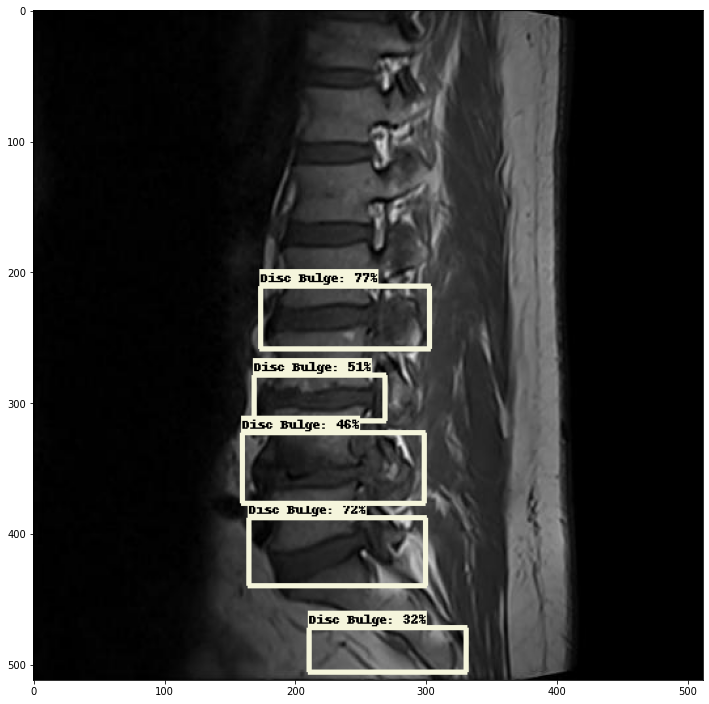

Unknown10--13-_jpg.rf.39e4b6266a66e5d102eabda9cd18a51a.jpg


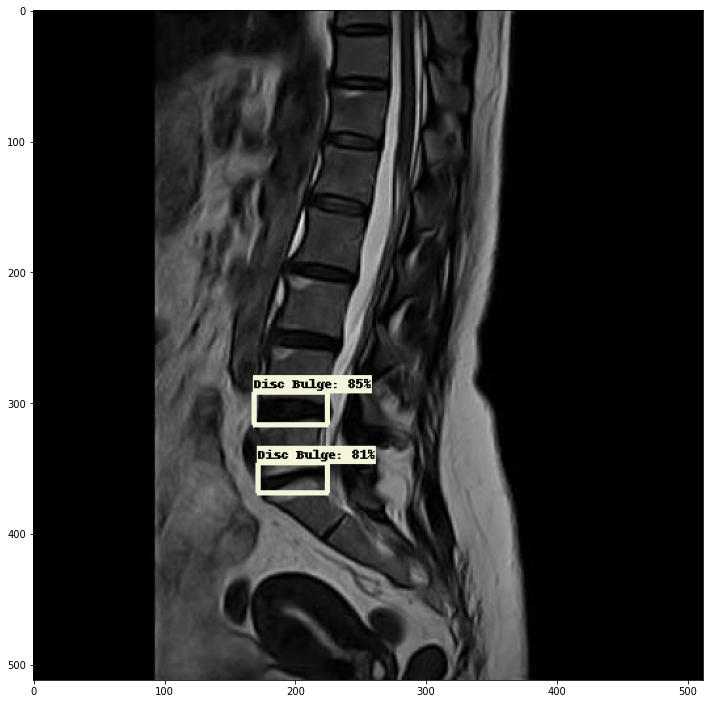

Unknown1--8-_jpg.rf.89b4f48a10e3a2219b56b04abe76e3e6.jpg


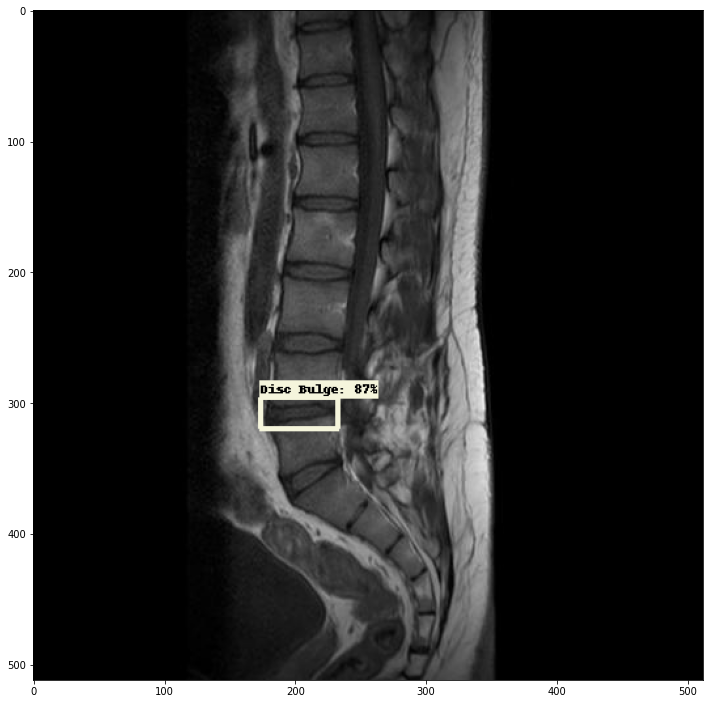

BAYAN-RASHEAD-AMR-1-_jpg.rf.e42bac81f25cf9d93d4f5e63d8ffa946.jpg


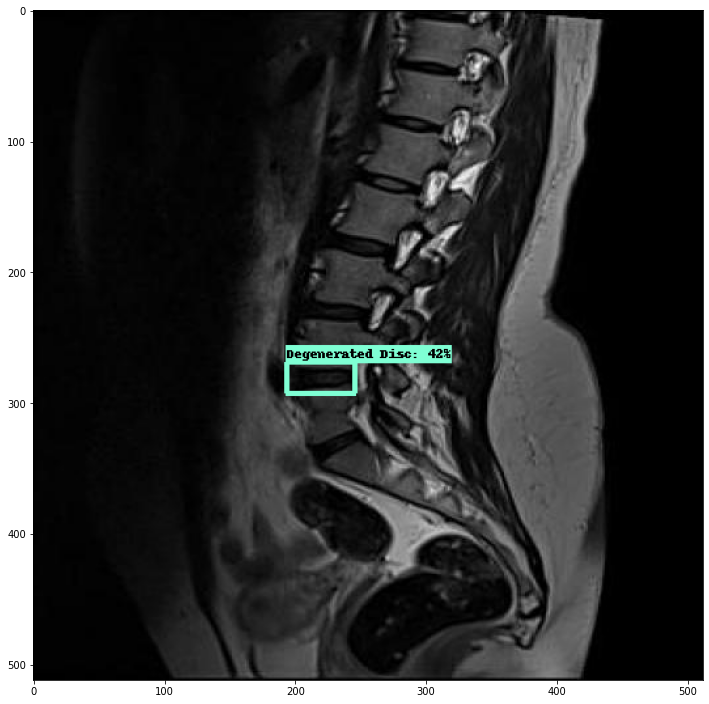

CervicalSpondylodegenerativeChanges-BUSAYNA-HESSIEN-MOHAMED-IBRAHIM--13-_jpg.rf.7796e288079906b73322e06526af710e.jpg


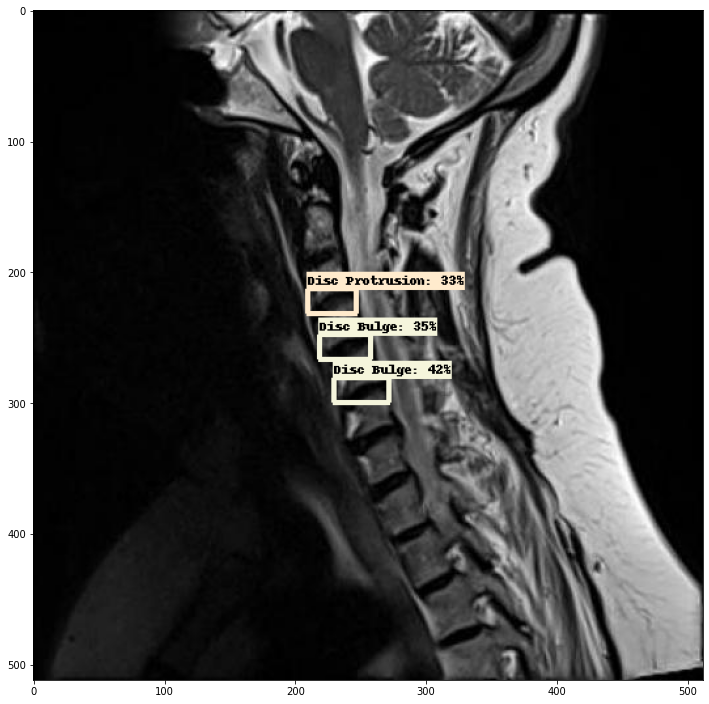

Diffuse-Disc-Bulge-Unknown2--26-_jpg.rf.2729fc3d374690cda18f0357d1ae5422.jpg


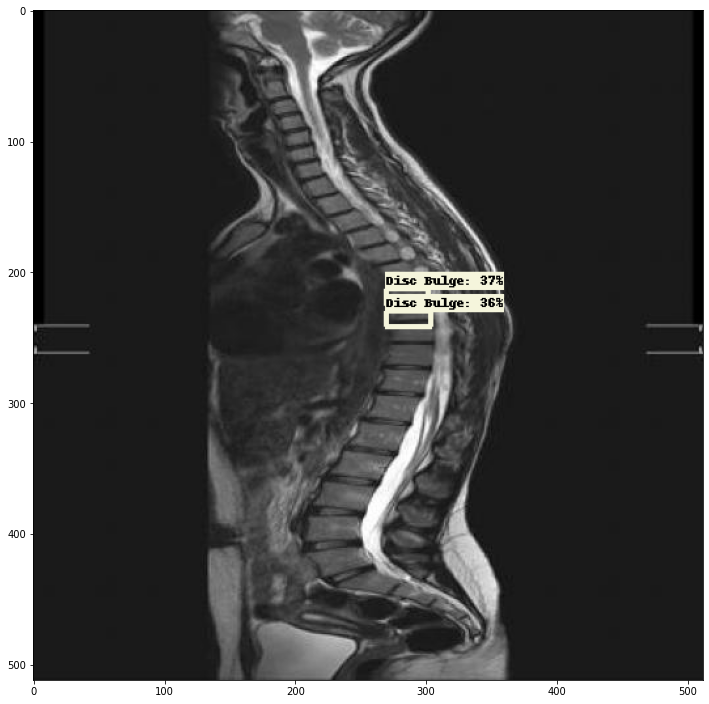

-11-_jpg.rf.7606b158423013f3dce6ba48b0c7e10b.jpg


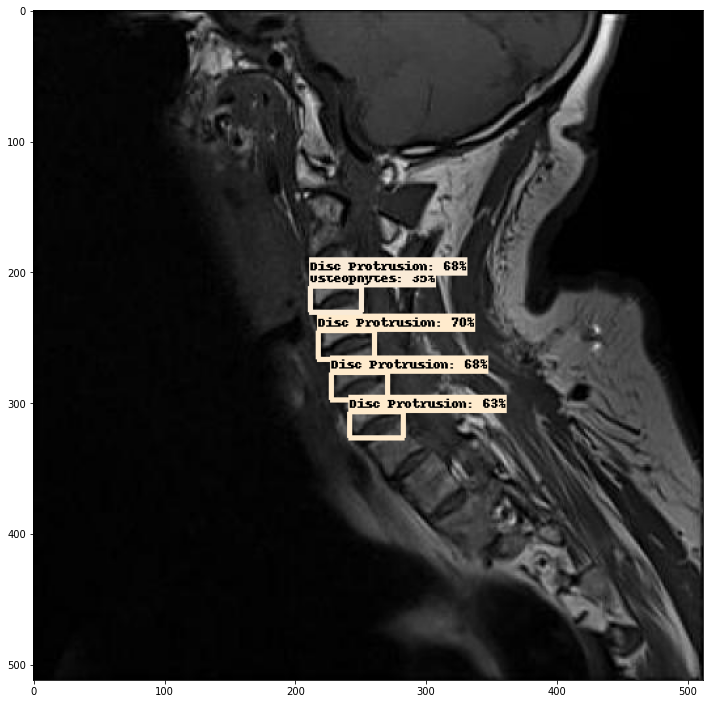

CervicalSpondylodegenerativeChanges-FWAKH-MOHAMED-METWALY-ALSAYED--18-_jpg.rf.558aa1e5b4495c6d0ad75233337e9c3e.jpg


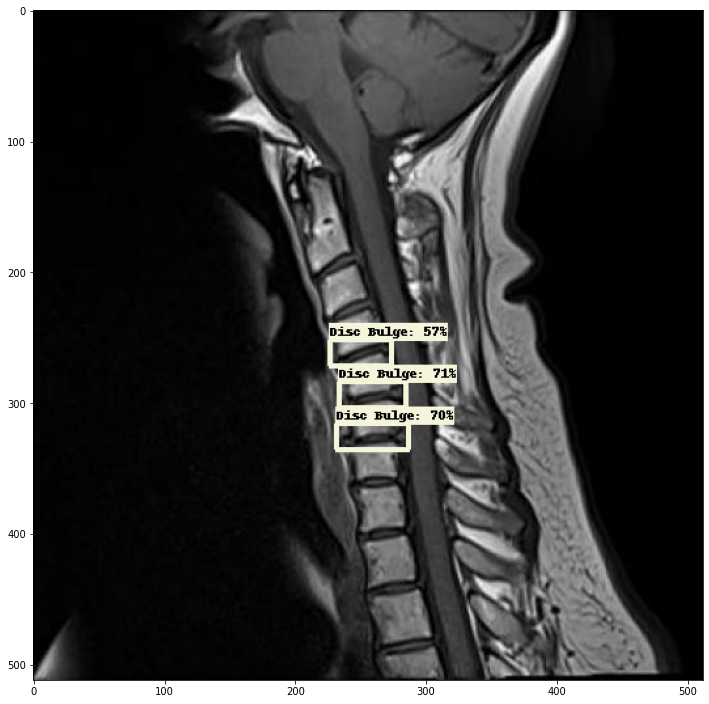

Unknown3--14-_jpg.rf.3706f3663b1ff5fa2cad80464e54ea86.jpg


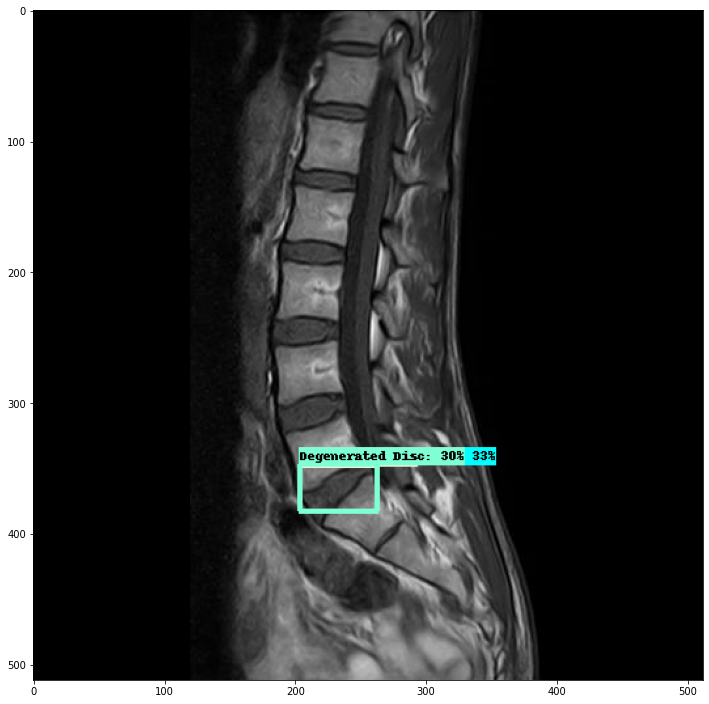

CervicalDiffuseDiscBulges-Unknown7--7-_jpg.rf.7eaa0a09628b6587b983855c57934ecf.jpg


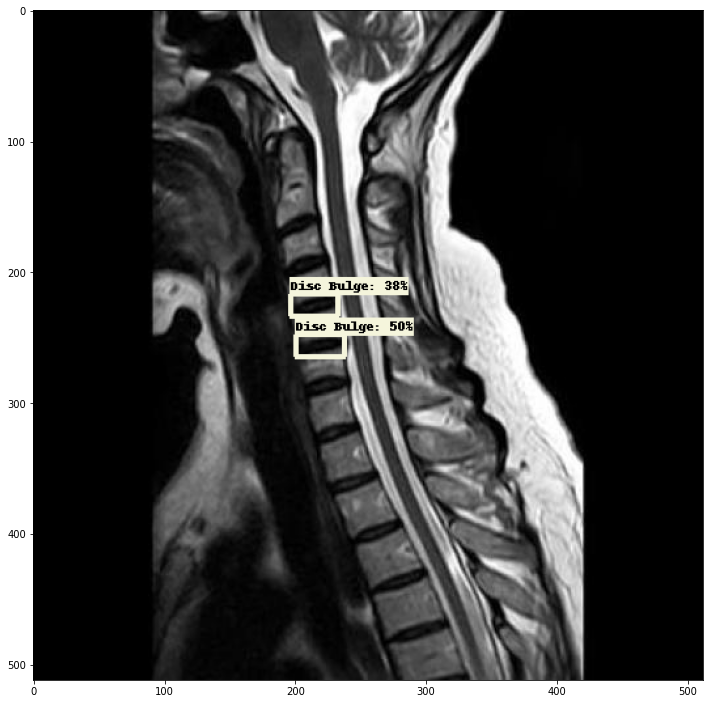

CervicalDegenerativeDiscDisease-Unknown2--23-_jpg.rf.15a44f657438f94a94dc0eae75765eab.jpg


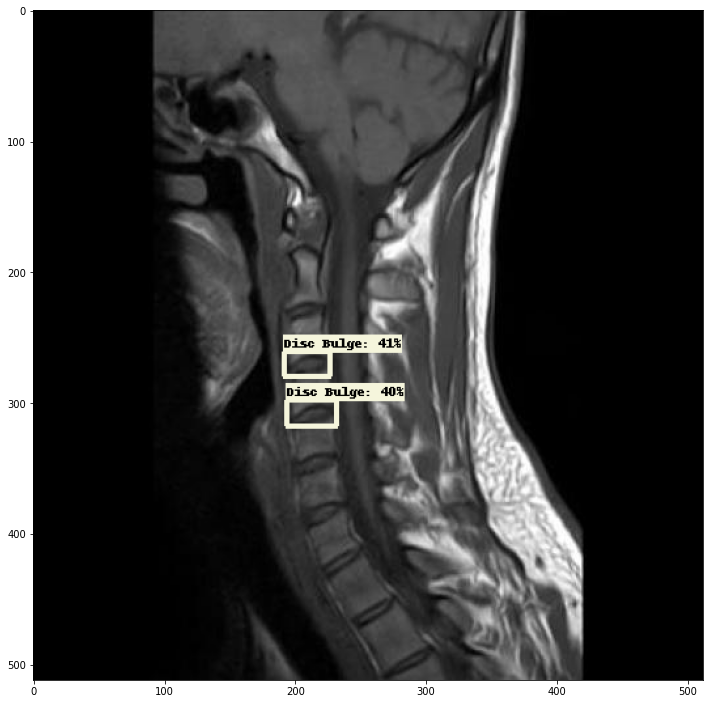

NADA-SAYED-ALH-GAD--8-_jpg.rf.6fe34df69b98fec9a01bcf464c0df1bb.jpg


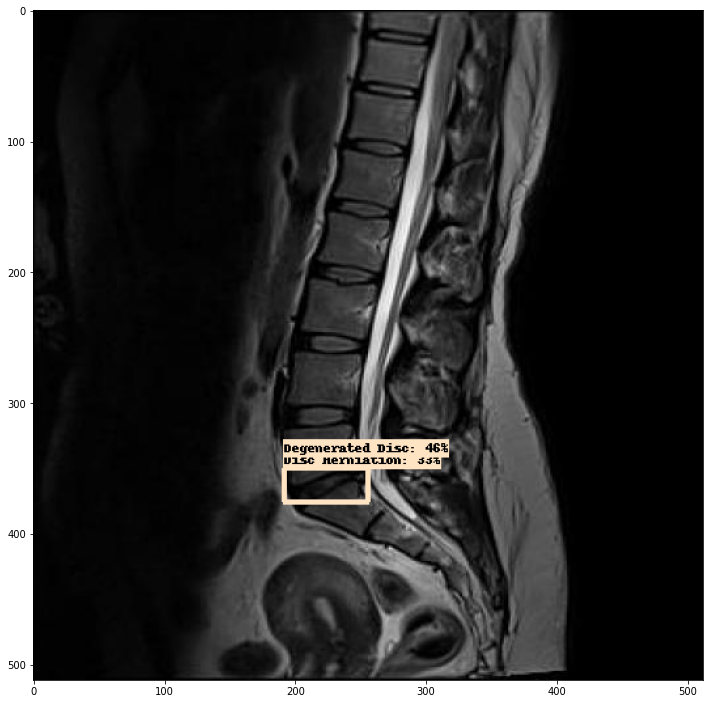

SALAH-ELDEEN-AHMAD--7-_jpg.rf.e92a4016f00c9abb75dcd7cb6d010de3.jpg


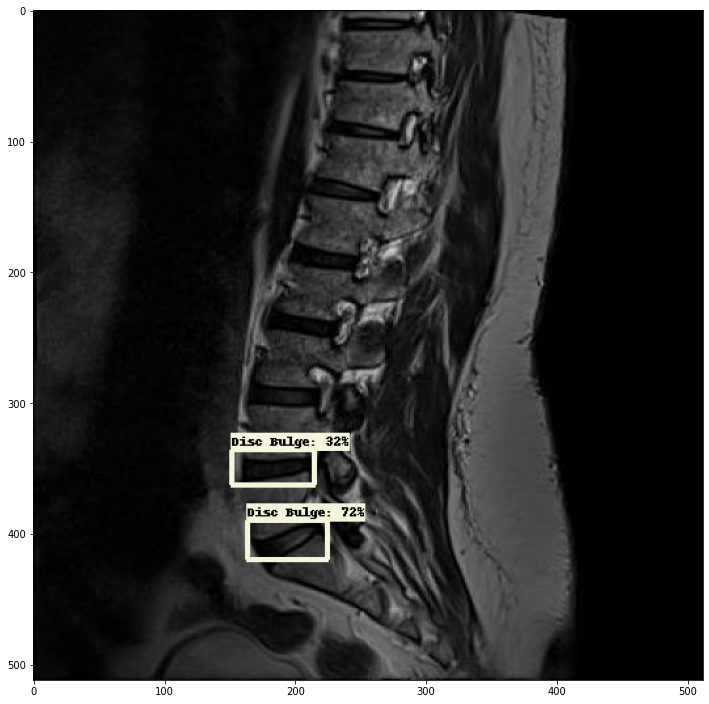

Unknown4--8-_jpg.rf.8fb5678854dbd173a93ff45d4f4cdca8.jpg


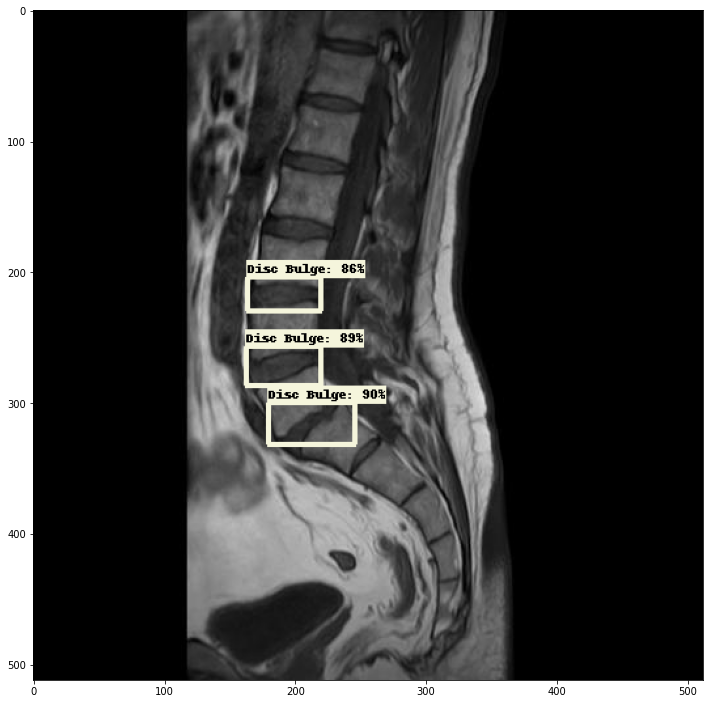

Unknown6--5-_jpg.rf.78ed673fe4f202b0fc3c0278ac1639d2.jpg


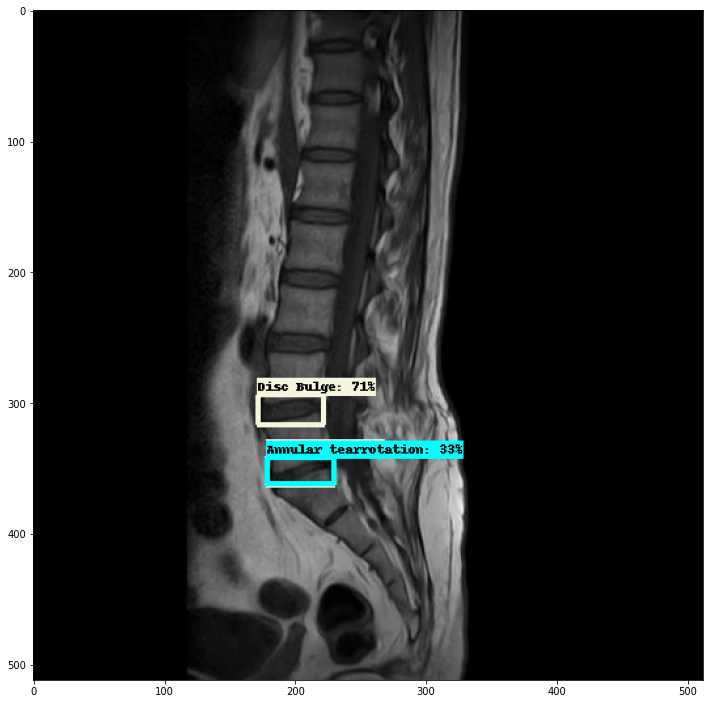

GAMAL-ABO-ELMAGD-HASANIN-ABD-alkadr-14-_jpg.rf.59adb22449b5021a965cf434cbbcbca9.jpg


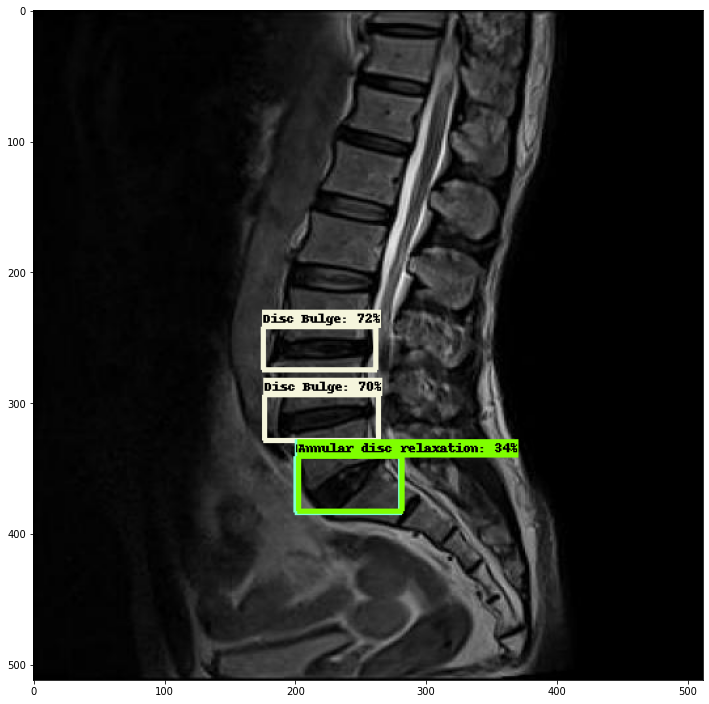

-11-_1_jpg.rf.38791e67db02112158718bee83a6a4bc.jpg


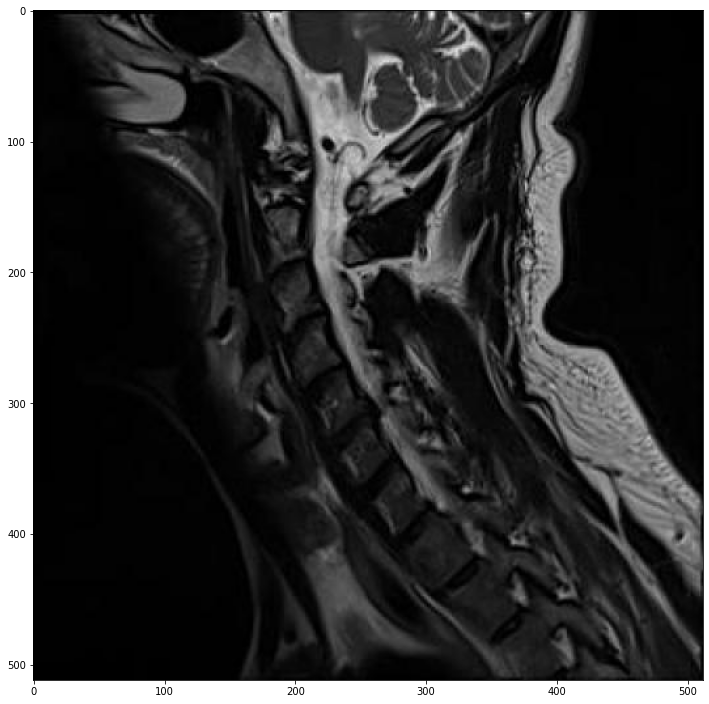

SpondylodegenerativeChanges-Unknown10Unknown10--15-_jpg.rf.0eeccfe77a8d7c9f8407c85e12d4fdcf.jpg


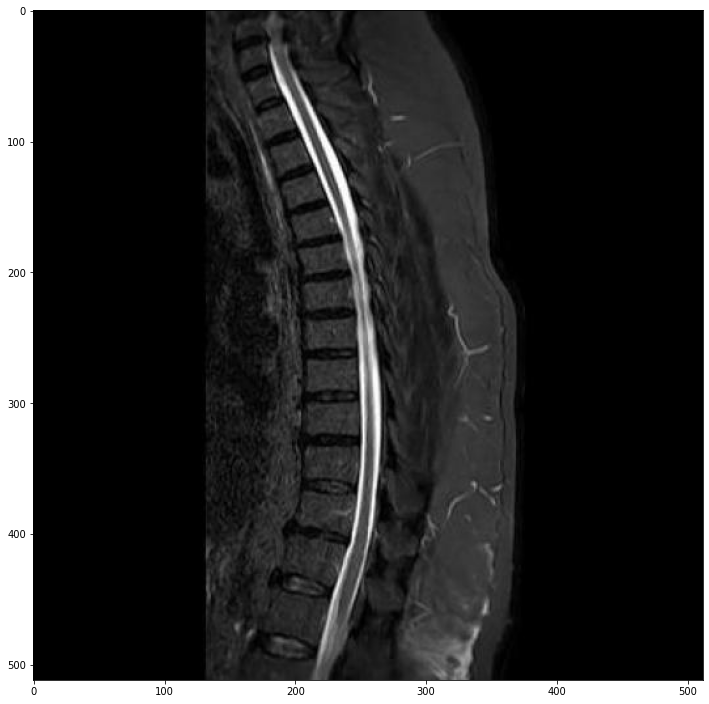

CervicalMultilevelDegenerativeDiscDisease-MAGDA-AHMAD-ALSAYED--6-_jpg.rf.028c0892f3387e34d39658d98ed93c6d.jpg


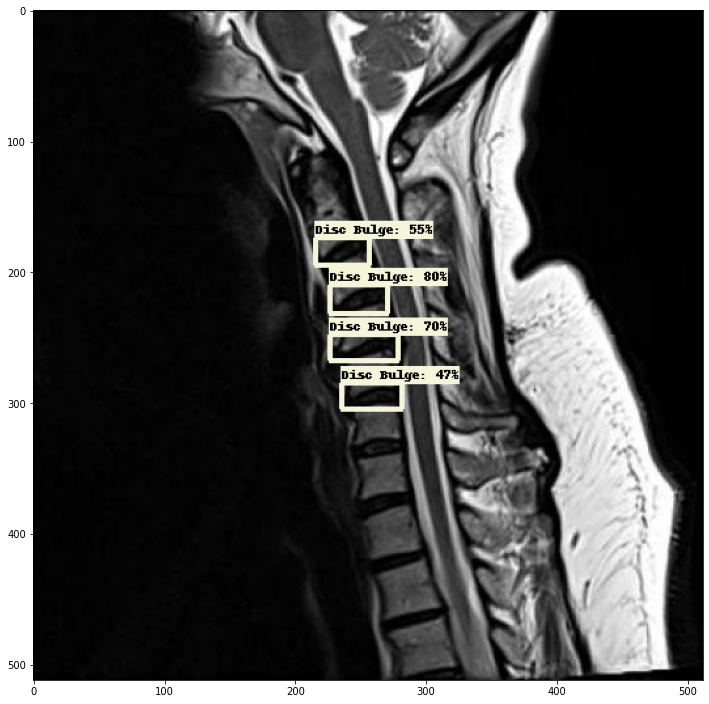

Multilevel-Degenerative-Disc-Disease-Unknown6--353-_jpg.rf.3e2ff9fed424e861afc33375cc1d00d6.jpg


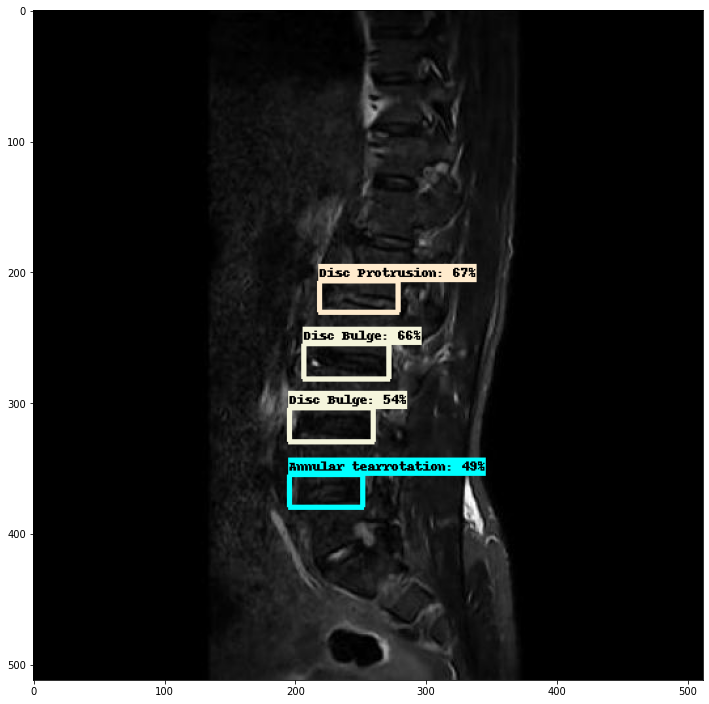

CervicalDiffuseDiscBulges-Unknown8--54-_jpg.rf.807eac45109ccb9897f032a563e2f3d6.jpg


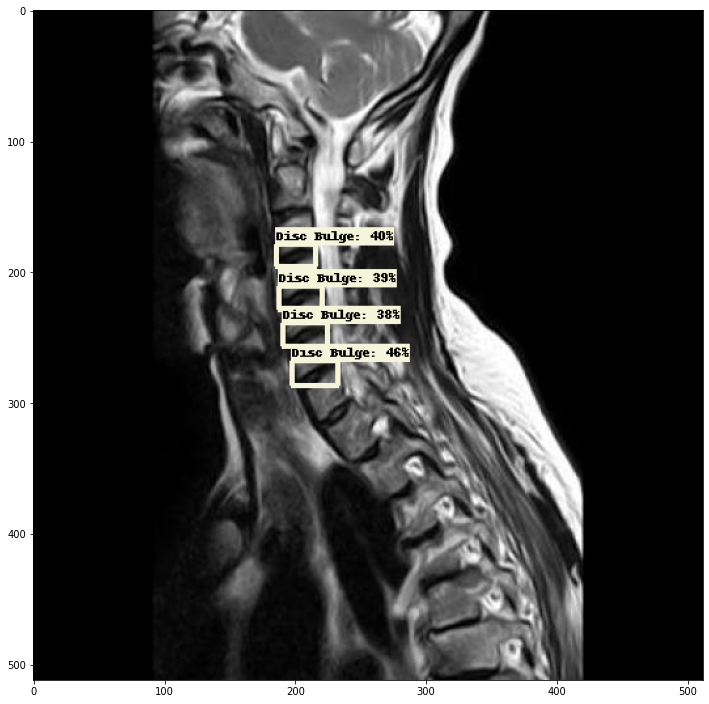

REDA-MOHAMED-ALSAYED-ATTEYEH-5-_jpg.rf.122e4d3267e0f3e61a4d0ba681febf5b.jpg


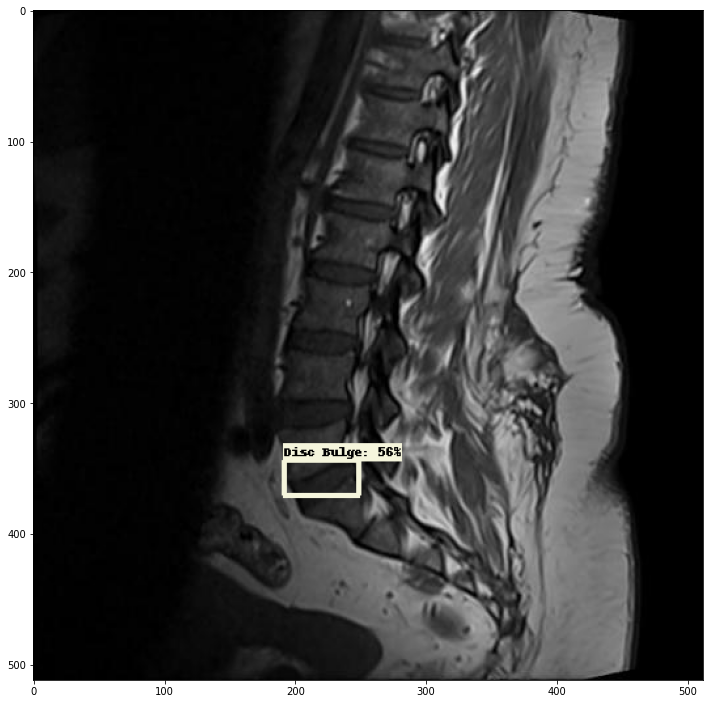

CervicalDiffuseDiscBulges-ABDALHLEM-MOHAMED-AHMAD-aboubasha--12-_jpg.rf.149ad7febf58bf2239588650a3174189.jpg


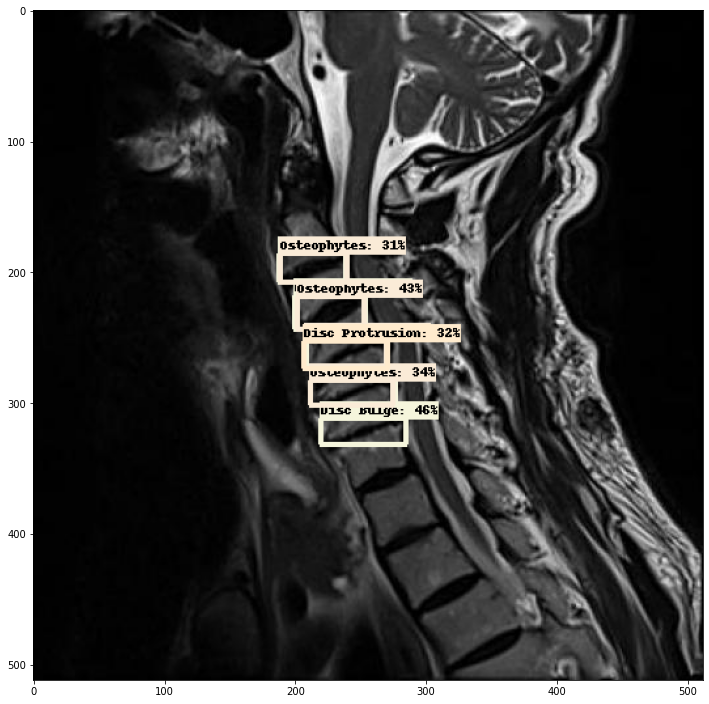

SpondylodegenerativeChanges-Unknown10Unknown10--10-_jpg.rf.6449aed7ae4ab63b751a51116eb4ee7d.jpg


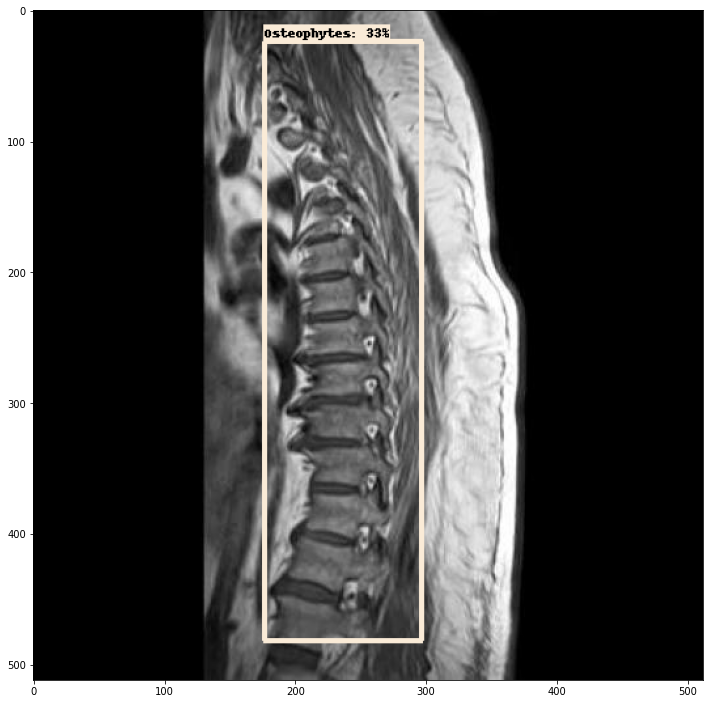

Unknown9--10-_jpg.rf.b09dcef8f53be1837568aa5fd31b5f0a.jpg


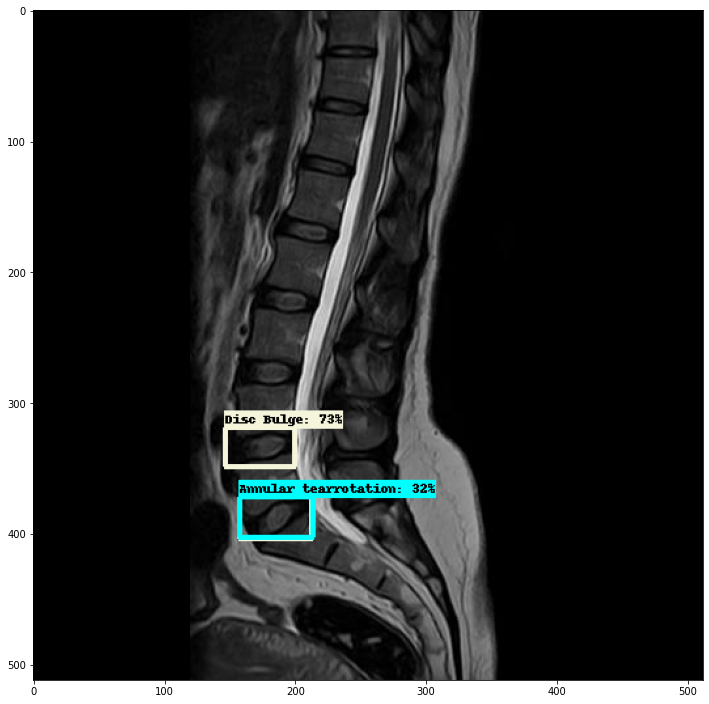

Diffuse-Disc-Bulge-Unknown2--45-_jpg.rf.854784548372a2bbec951c76016bafc2.jpg


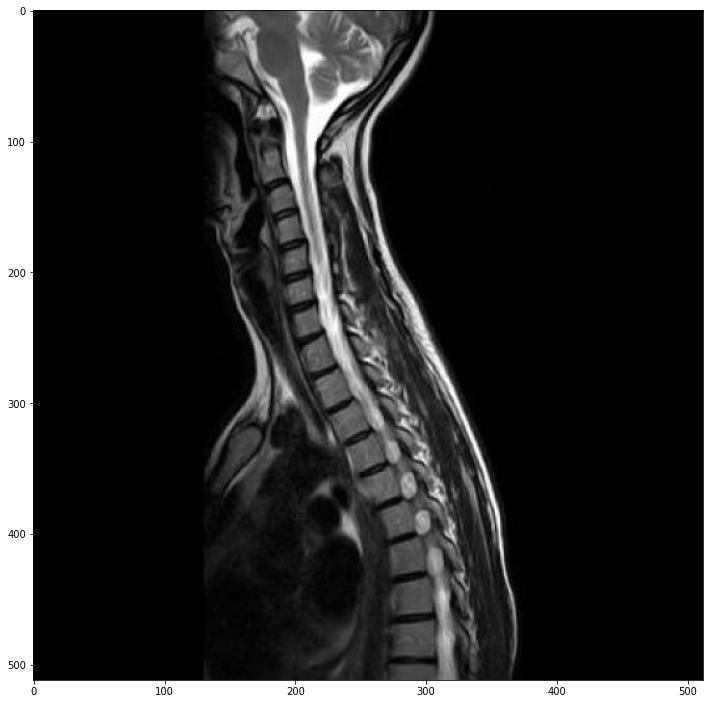

AYMAN-HESSIEN-ABD-alal-ABD-alal-5-_jpg.rf.c266191e553c311d97abb77c18405f02.jpg


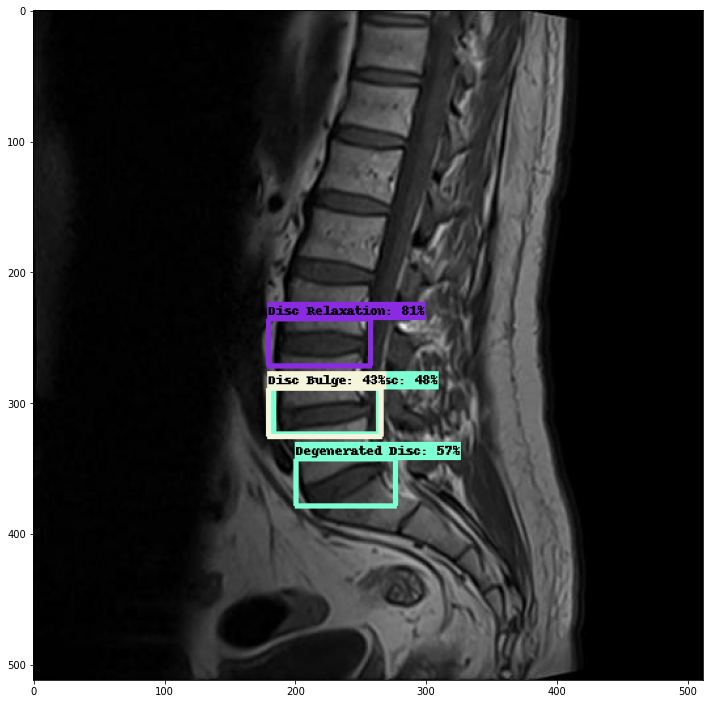

Unknown17-Unknown17-10-_jpg.rf.a9e328ad9f4f5c299d4f04a6f33348f5.jpg


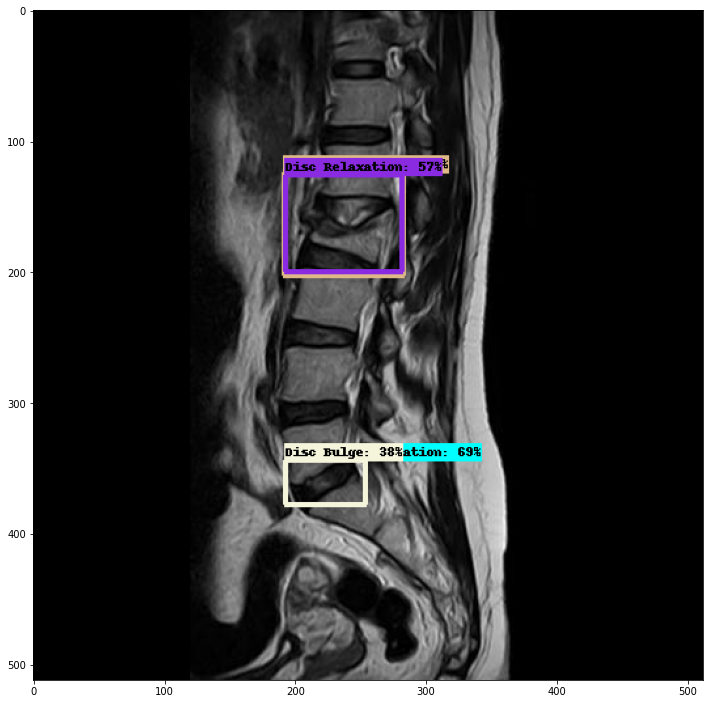

DiscProtrusion-Unknown5Unknown5--17-_jpg.rf.24f2ae96a9accb31f78c14e674a3b4c6.jpg


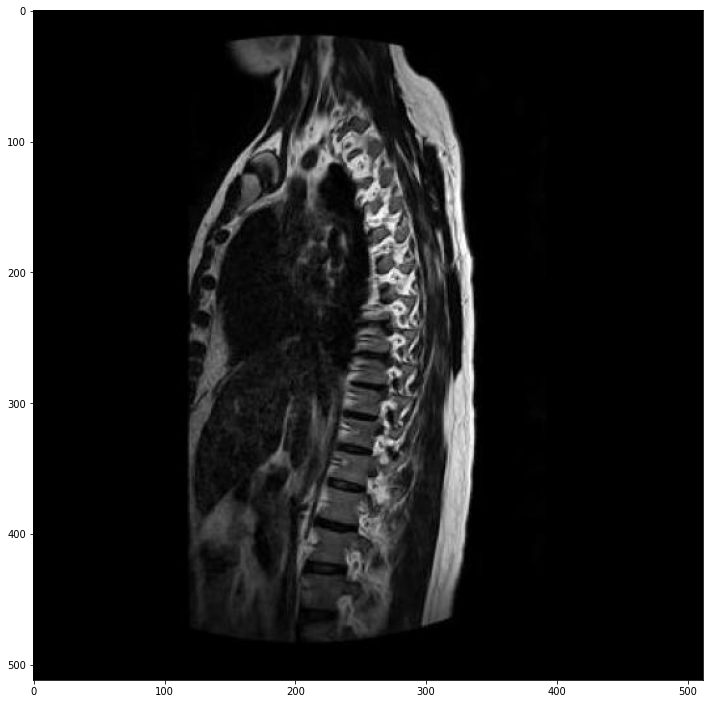

CervicalDiffuseDiscBulges-AHMAD-MOHAMED-KAMAL-ABD-AL-AZIZ--28-_jpg.rf.e934a8140a396edcd3706c5df026380a.jpg


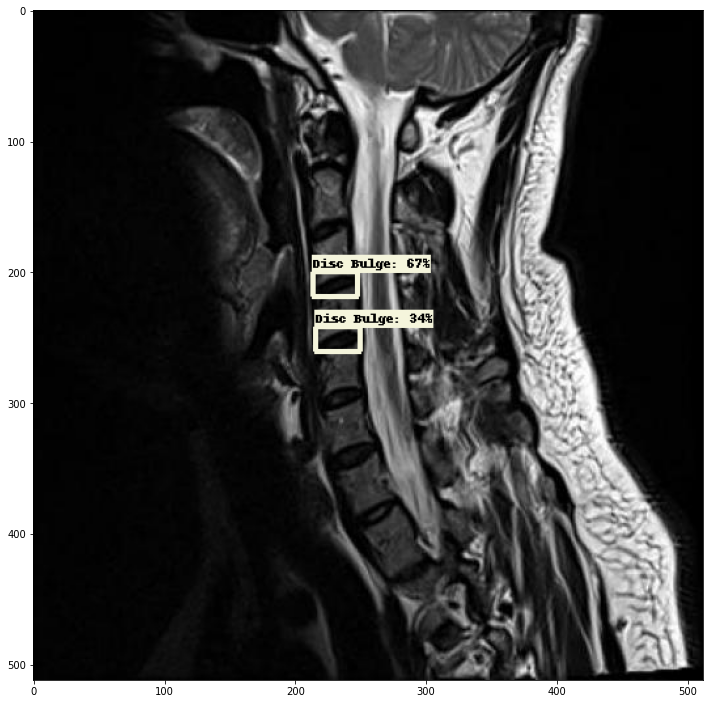

CervicalSpondylodegenerativeChanges-OSAMA-ALH-MAHMOUD-MOHAMED--41-_jpg.rf.84355c0d54262c931c7653102b27f47b.jpg


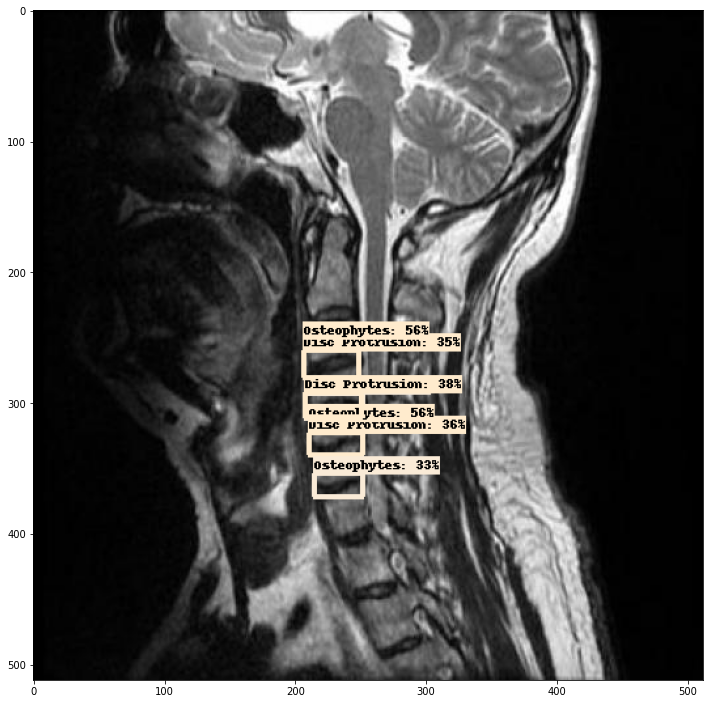

Diffuse-Disc-Bulge-Unknown2--136-_jpg.rf.deedb94cbf833e45606b2895fdbef5b8.jpg


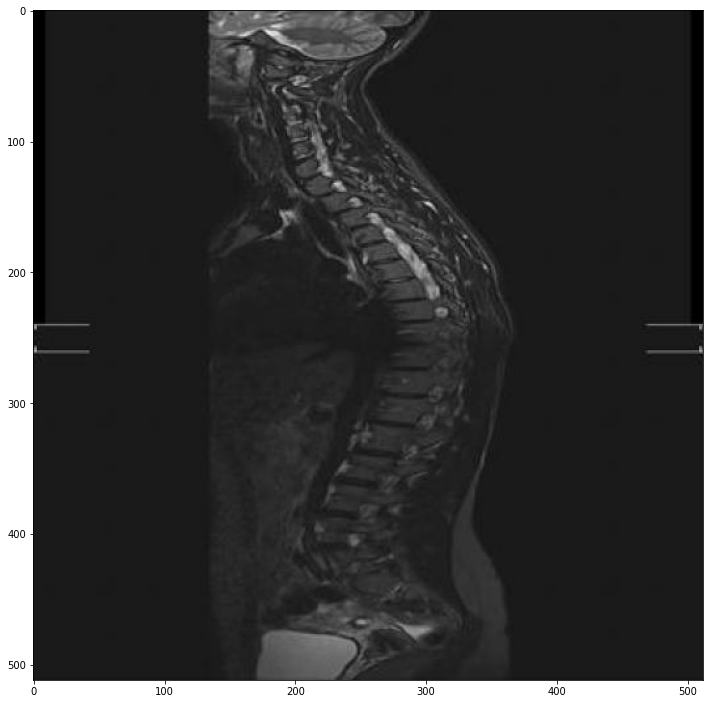

CervicalDegenerativeDiscDisease-Unknown11--14-_jpg.rf.cb625f71c0d8e33ed5dda59ccb41159d.jpg


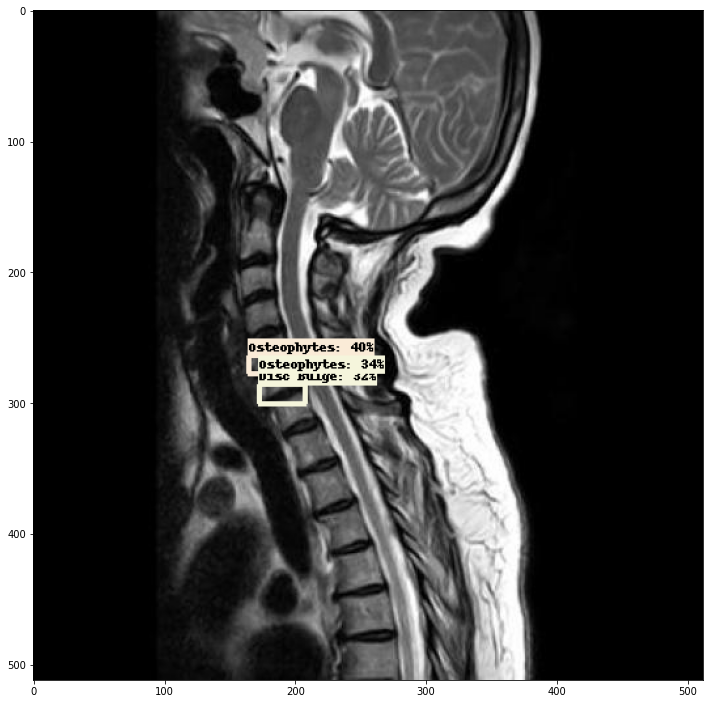

DegenerativeDiscDisease-Unknown1Unknown1--15-_jpg.rf.4cdd84a1a7a4f59480141a12436a3479.jpg


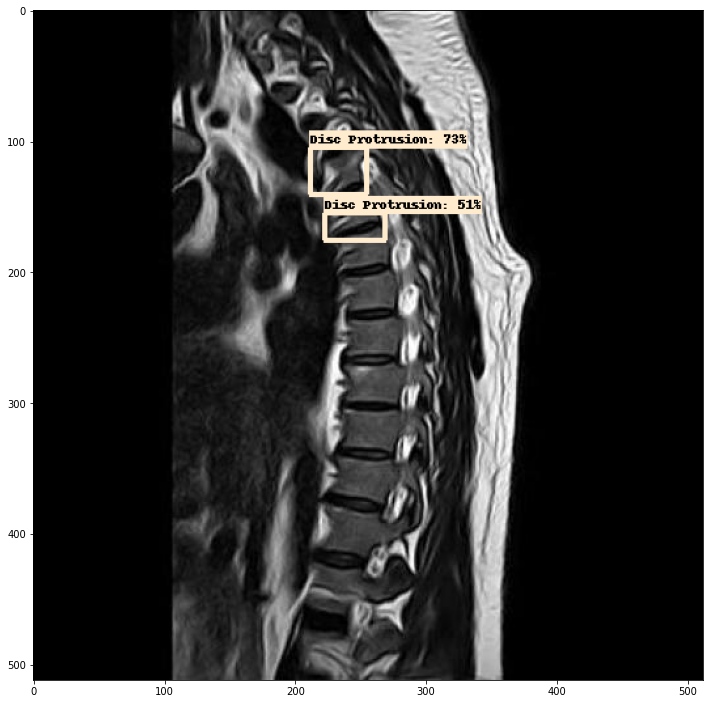

Unknown6--6-_jpg.rf.cfbc8c17bedfeeacee11afef68ae72ad.jpg


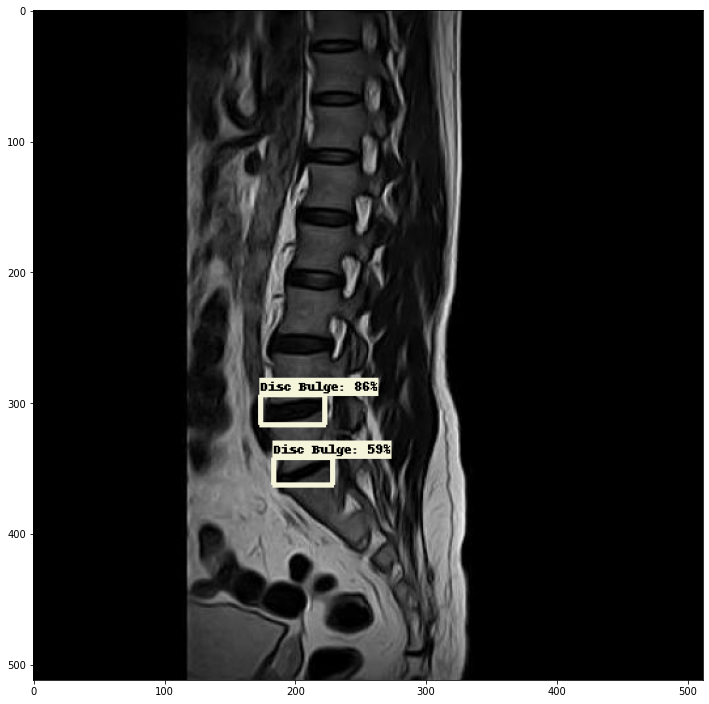

AMAL-RAGAB-ALSAMMAN-ALI-3-_jpg.rf.ad9e7feb509a1c2e5031b80c5cd4d04c.jpg


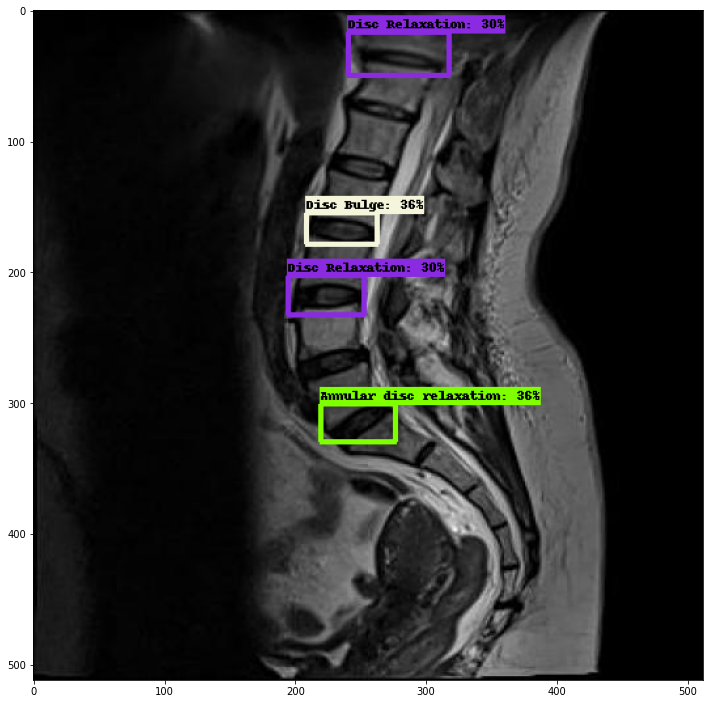

Unknown15-Unknown15-5-_jpg.rf.1c5a2737309f74d6ad03ab7ae3bf2d7d.jpg


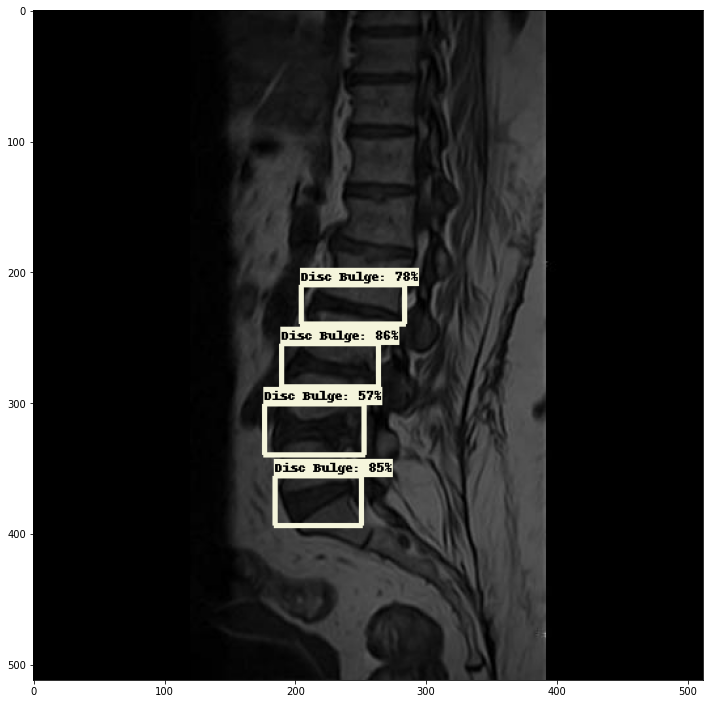

DegenerativeDiscDisease-Unknown1Unknown1--20-_jpg.rf.155dbf3257e261c6b853a6bb74733c1d.jpg


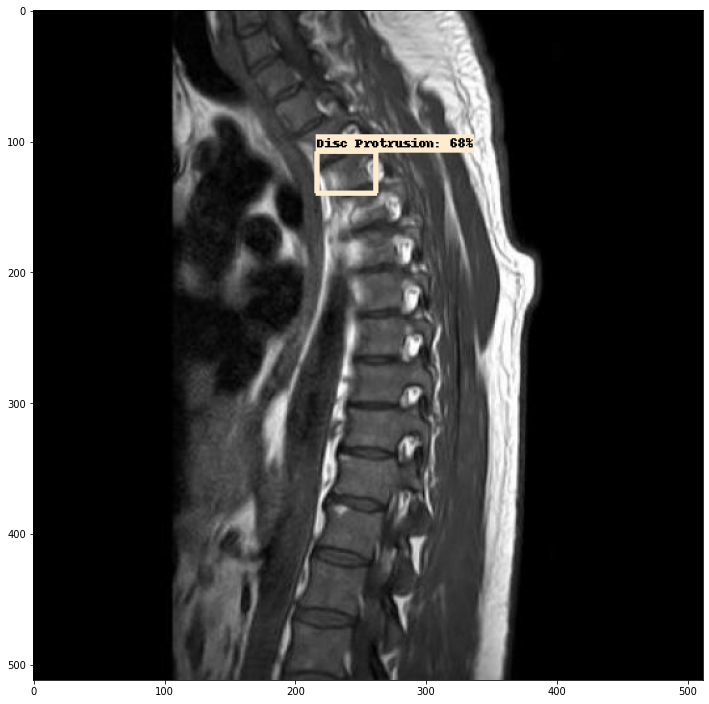

Unknown4--13-_jpg.rf.322930e567904c4bbd5b649fdb45cd73.jpg


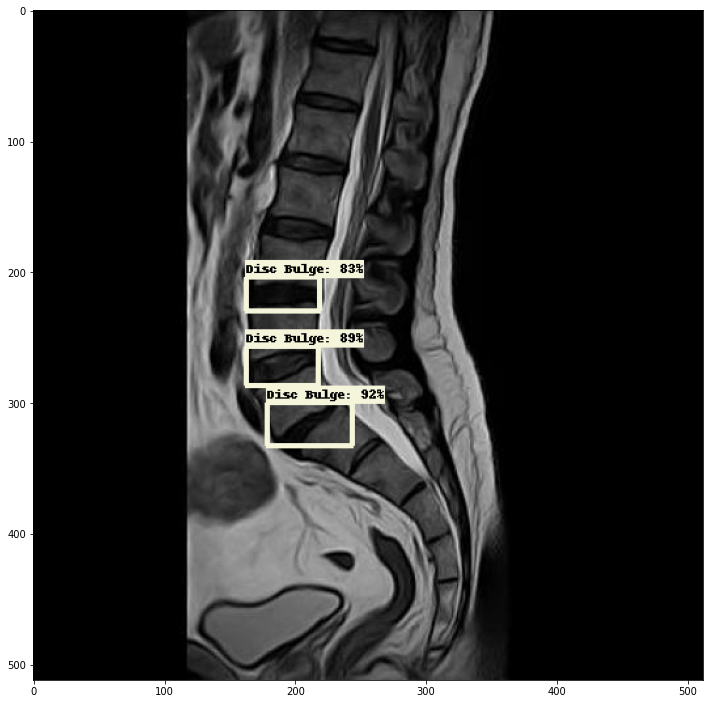

CervicalSpondylodegenerativeChanges-OSAMA-ALH-MAHMOUD-MOHAMED--51-_jpg.rf.07594c889a4cccaf0805d8641eba342c.jpg


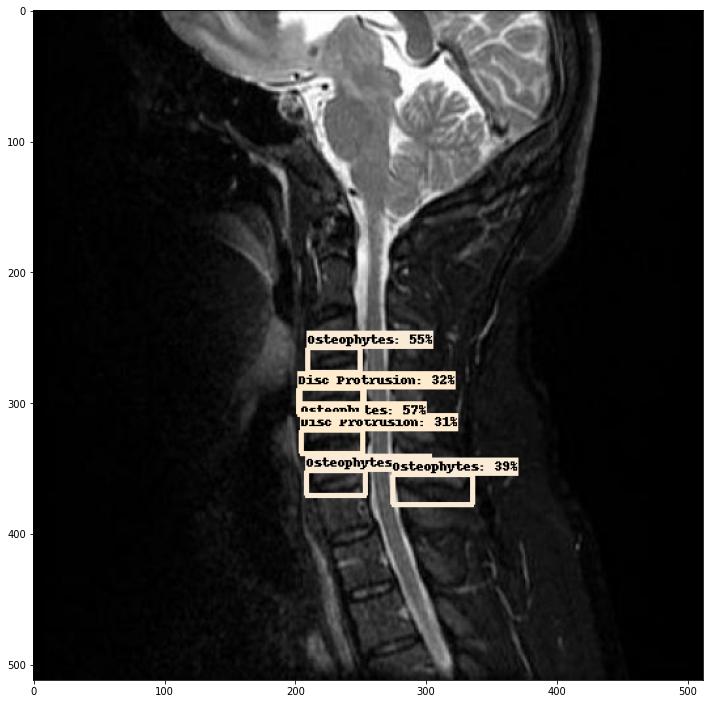

Unknown7--11-_jpg.rf.d189f5ae3f6ab8f87545049113e69674.jpg


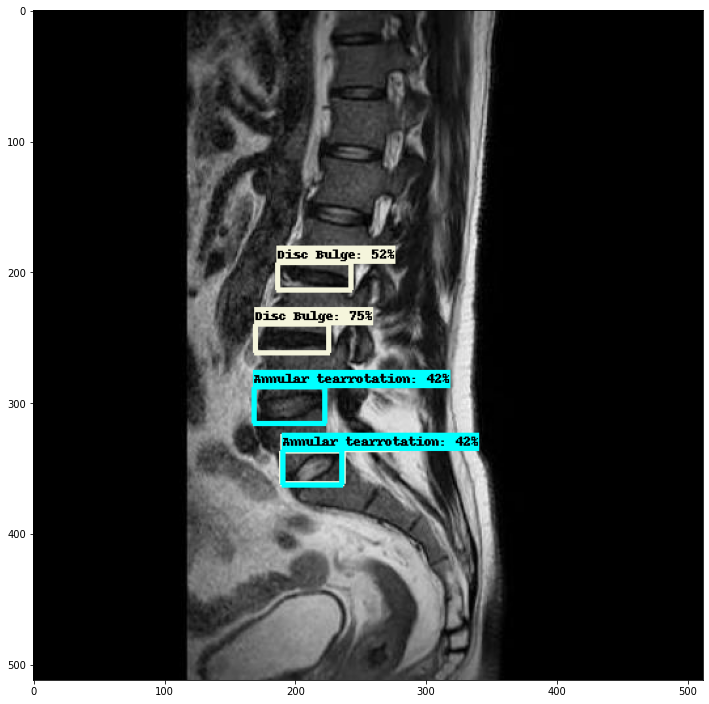

Unknown1--15-_jpg.rf.e2c3181de6589f58926d9cae69931458.jpg


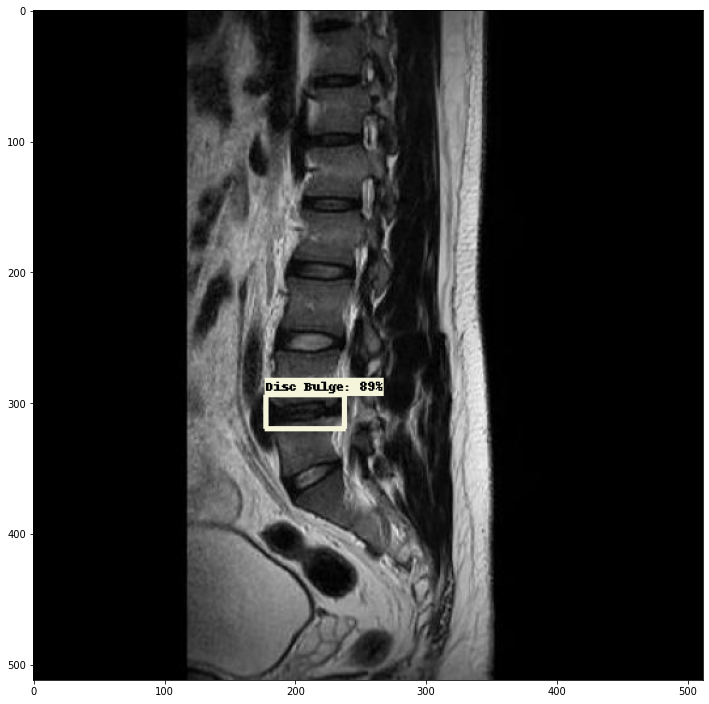

Multilevel-Degenerative-Disc-Disease-Unknown6--360-_jpg.rf.927c11b633db98cd892fa1f17dee7789.jpg


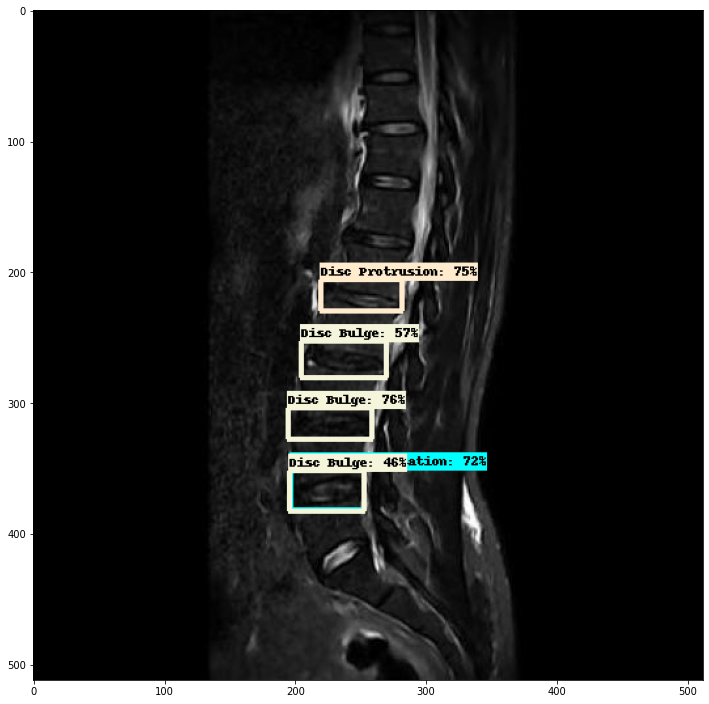

CervicalDiffuseDiscBulges-Unknown10--24-_jpg.rf.8c2e36965c6a0ee288c03d8fc78a99e4.jpg


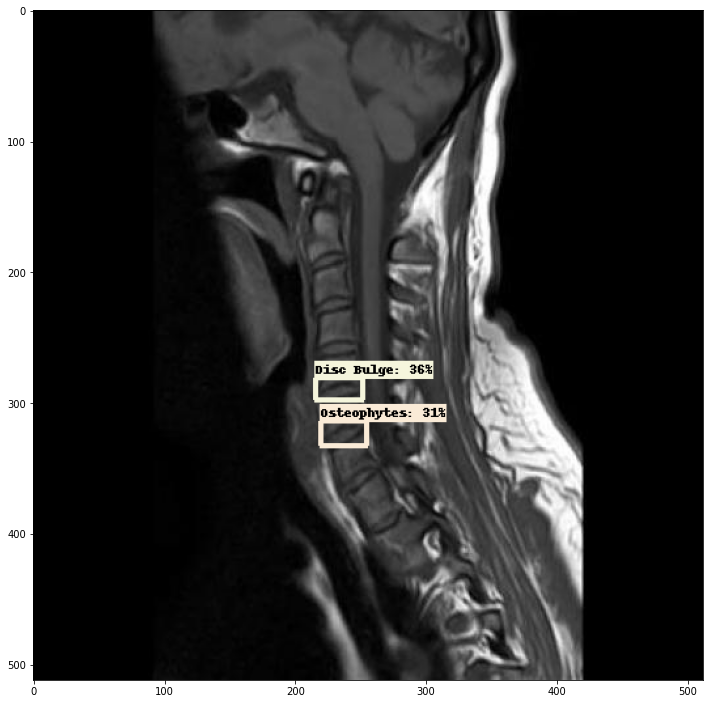

-20-_1_jpg.rf.fced33210f113efab3d117976f1eb114.jpg


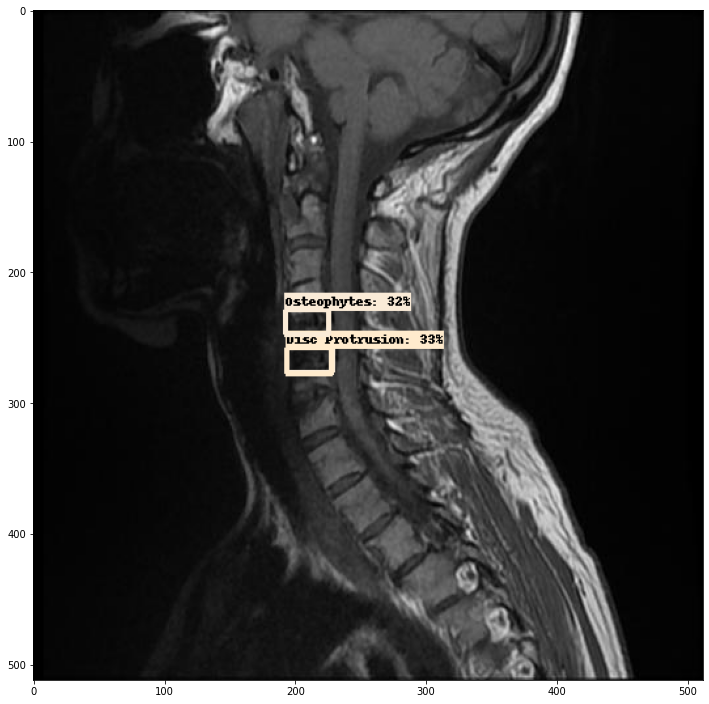

DiscProtrusion-Unknown5Unknown5--24-_jpg.rf.f3f3dfb0801fa722ac8e8c200be62bd2.jpg


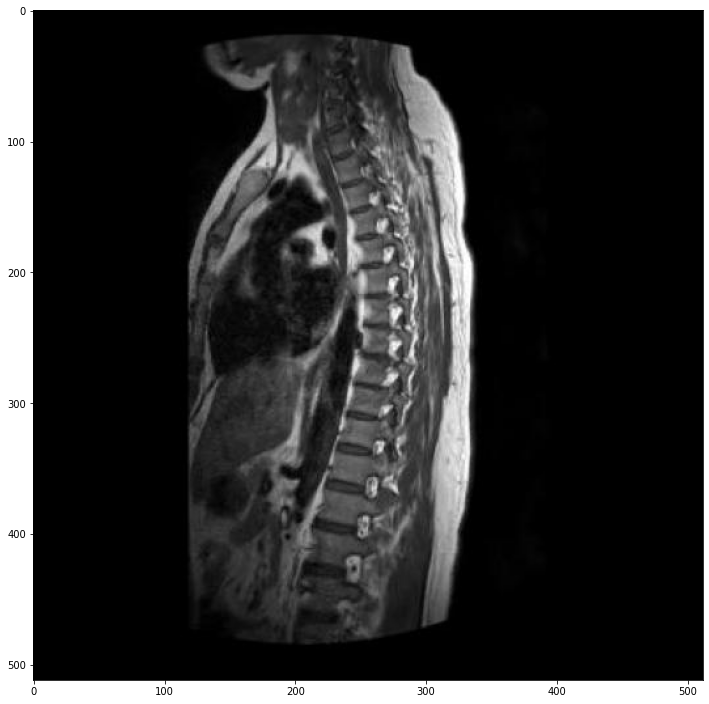

CervicalDiffuseDiscBulges-Unknown10--2-_jpg.rf.4bbce667b32ddcba3025d0edb5943fd5.jpg


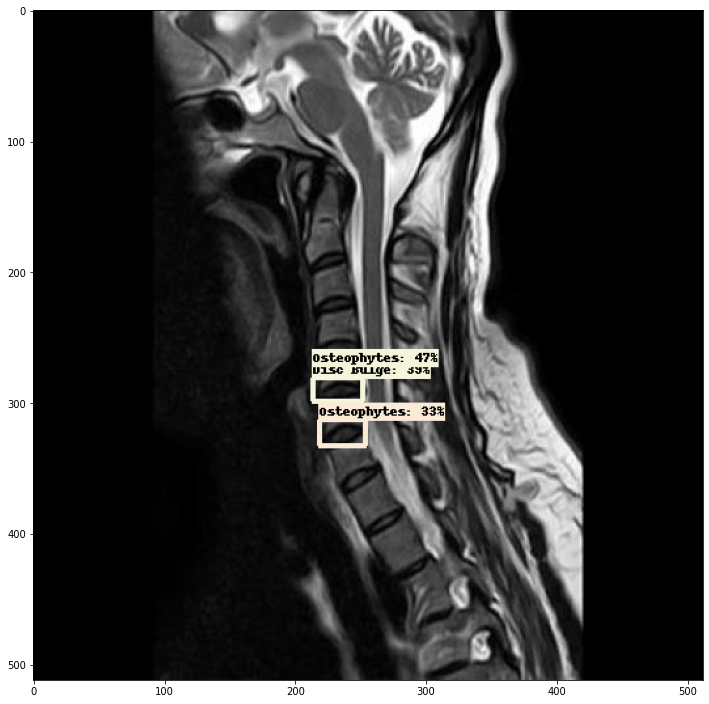

-54-_jpg.rf.13e91ab740a706f3a9ea831a0e8d524a.jpg


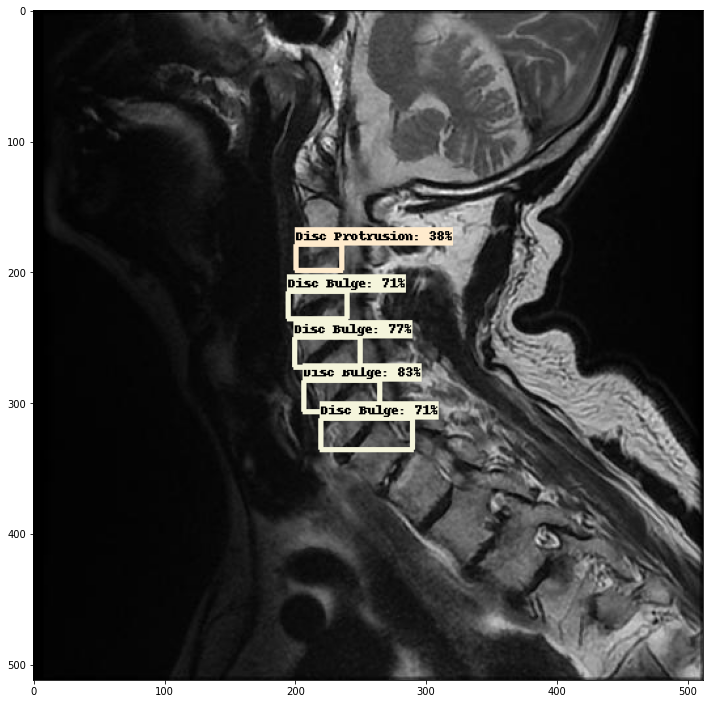

DegenerativeDiscDisease-Unknown1Unknown1--27-_jpg.rf.308f38461115b6df7ad0b56270504af7.jpg


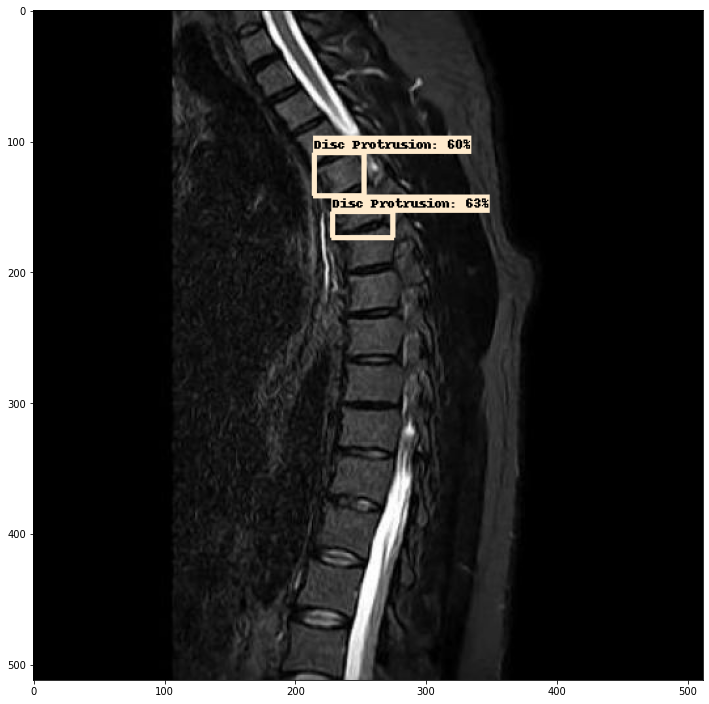

AMAL-RABEA-ALKELANY-IBRAHIM-SAKAR-6-_jpg.rf.b913504a3d59f5d156c0307de10cbb5e.jpg


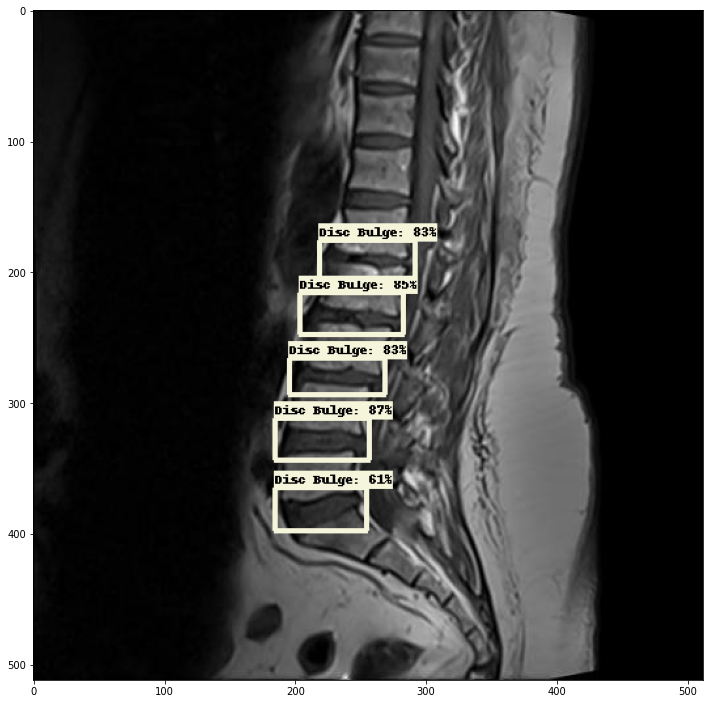

RABAB-ABD-alhmid--5-_jpg.rf.25dde64f6b8d89d51cbdbbabba0aa87a.jpg


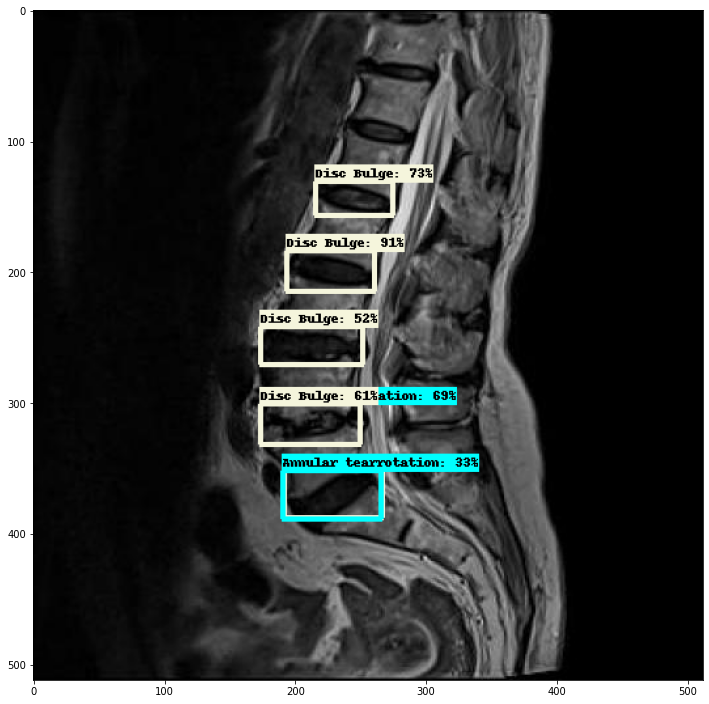

CervicalDiffuseDiscBulges-ABDALHLEM-MOHAMED-AHMAD-aboubasha--8-_jpg.rf.4baa8b1faf094c4ac5d126dd67bdf0f2.jpg


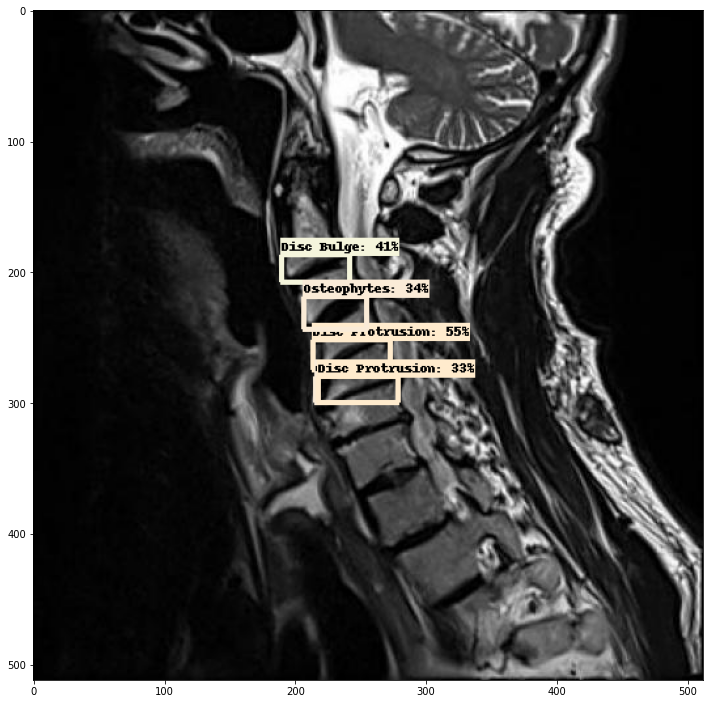

-22-_jpg.rf.6467fb89b76f9408bf437894fffa8568.jpg


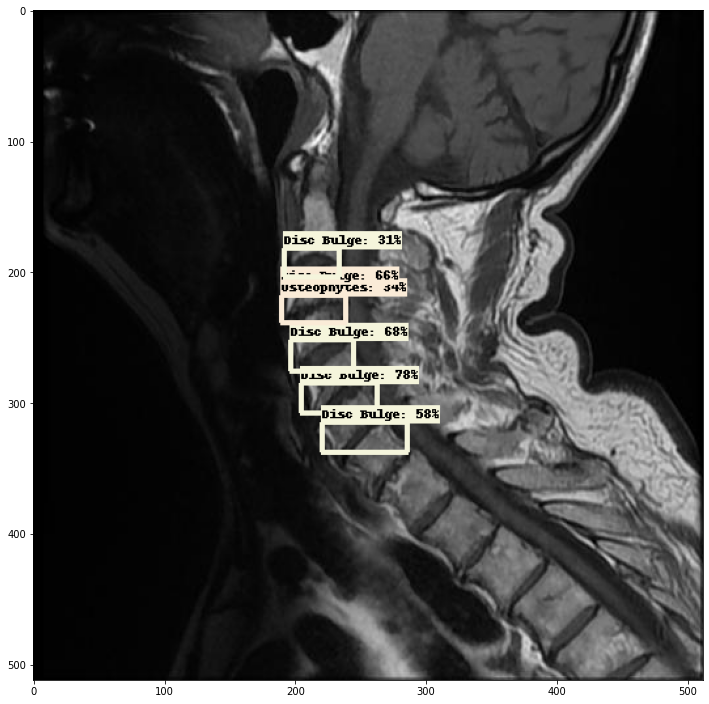

Unknown16-Unknown16-10-_jpg.rf.e9defb619923eb0d51a14d38af2fd653.jpg


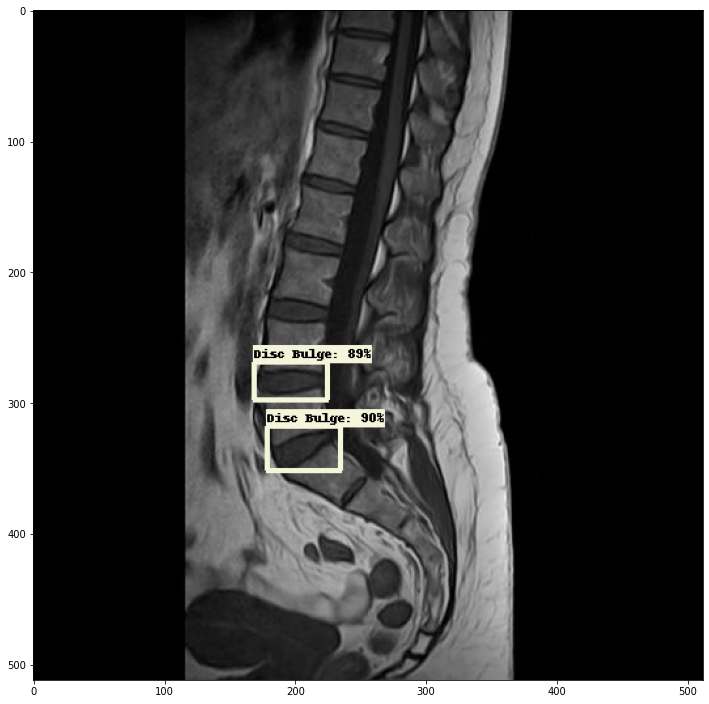

Unknown15-Unknown15-8-_jpg.rf.fbee33691edf75b4dd7272c0cc7ba503.jpg


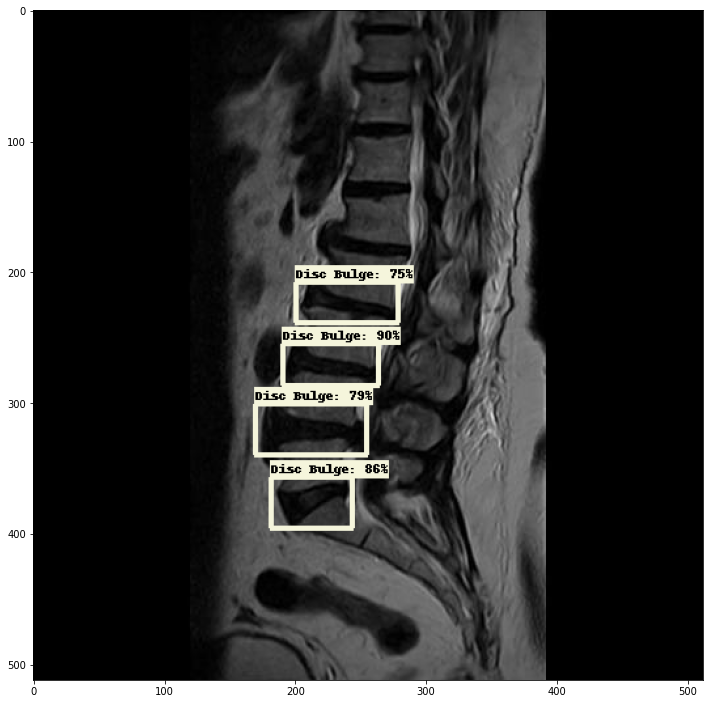

CervicalDegenerativeDiscDisease-Unknown5--23-_jpg.rf.5c62d893d9d832b25f84b523ce09a501.jpg


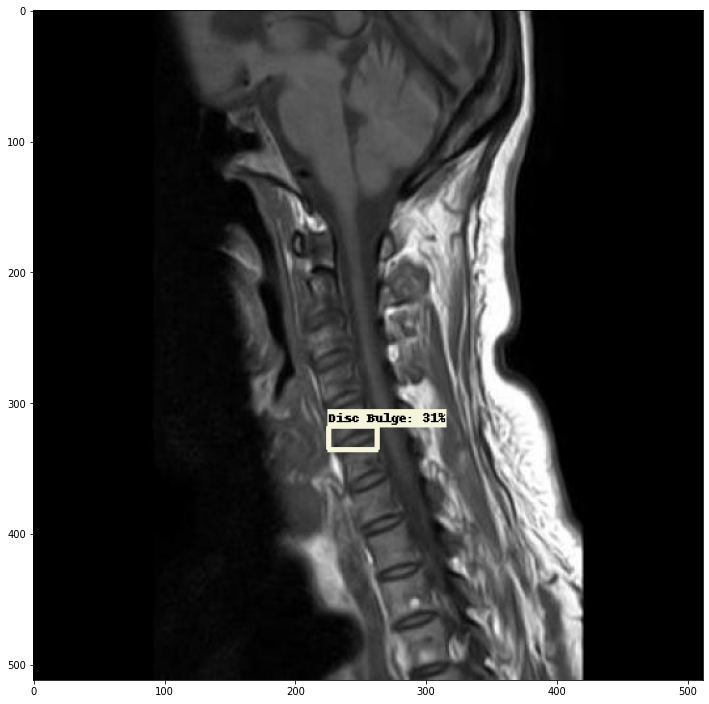

Multilevel-Degenerative-Disc-Disease-Unknown6--367-_jpg.rf.7c037822dd895db0c85cc88057055ab1.jpg


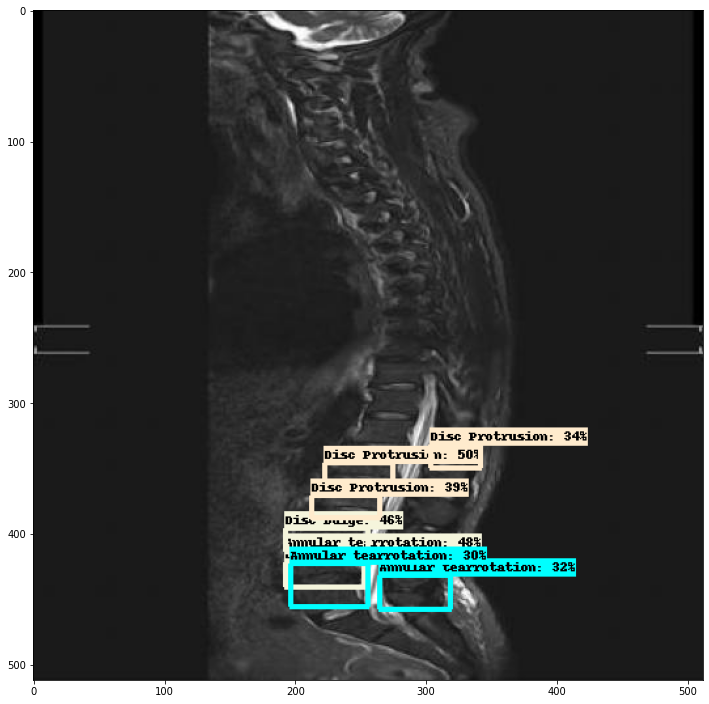

JAMAH-FATEHI-ALDISOUQI-KHODIR-14-_jpg.rf.5954840445737d98cdc6f4b51c06e7aa.jpg


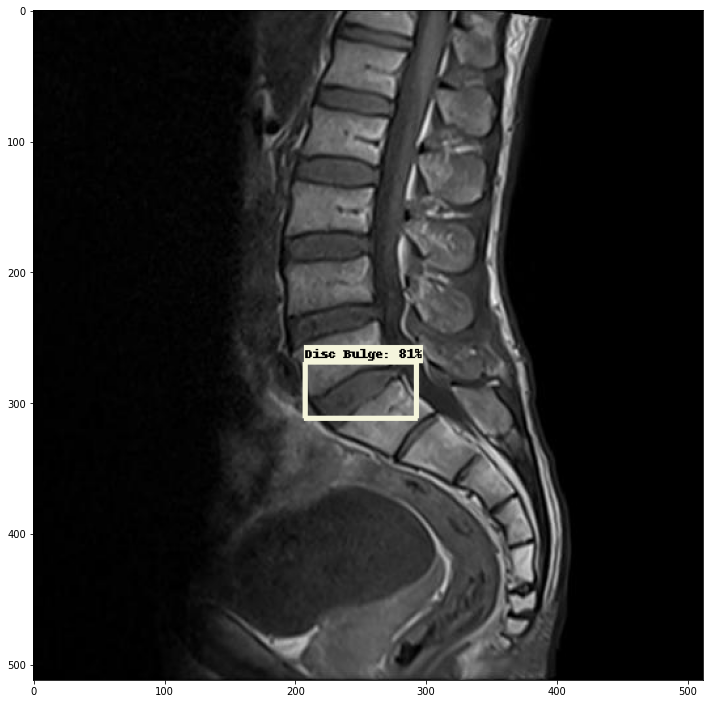

Unknown7--6-_jpg.rf.2080e27586996f7669664fa8547f6ec7.jpg


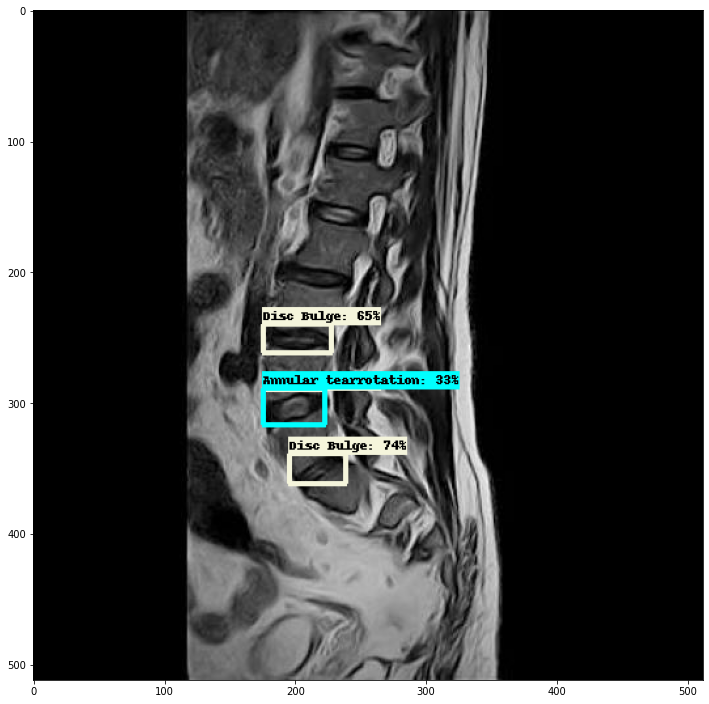

CervicalDegenerativeDiscDisease-Unknown13--18-_jpg.rf.b4cc8ee411f6c0a6e74aa808157ac66d.jpg


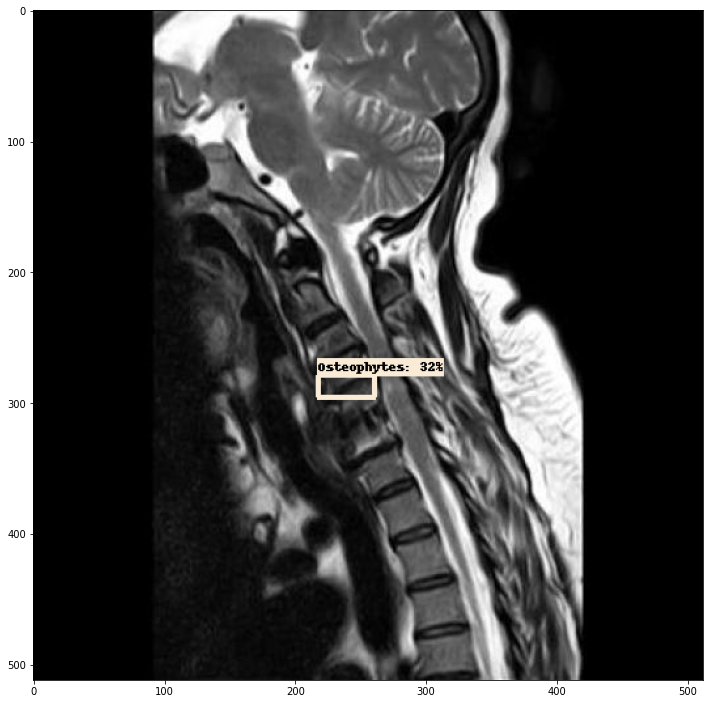

BAYAN-RASHEAD-AMR-4-_jpg.rf.28843162adaabbbe575d7590a68505c6.jpg


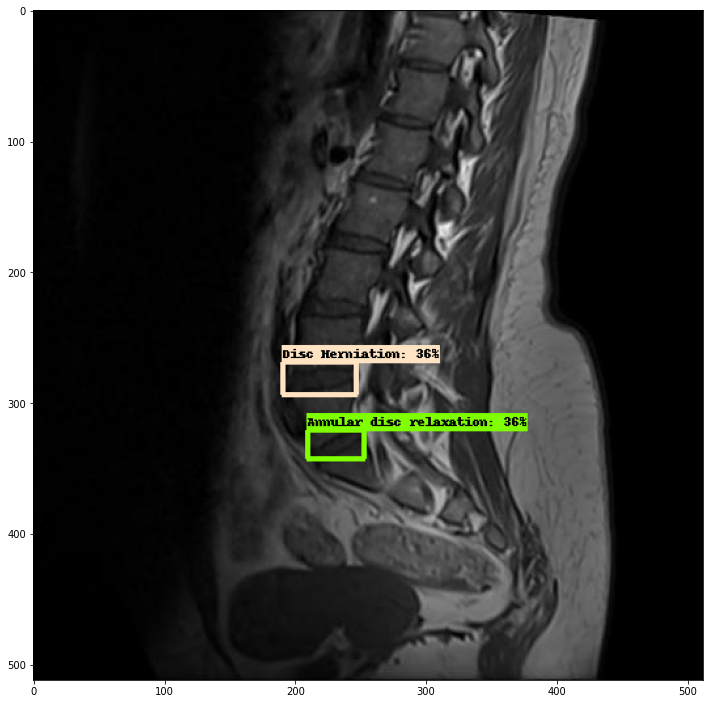

Unknown8--5-_jpg.rf.f2cda644c733b3bb5484836fe9ac54a2.jpg


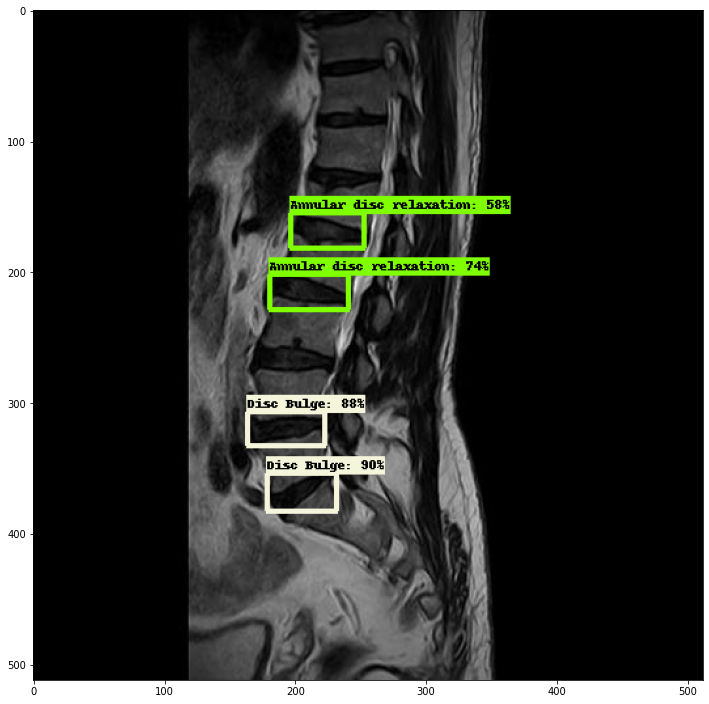

GAMAL-ABO-ELMAGD-HASANIN-ABD-alkadr-13-_jpg.rf.d094aaa788a4872e1465094d8103339c.jpg


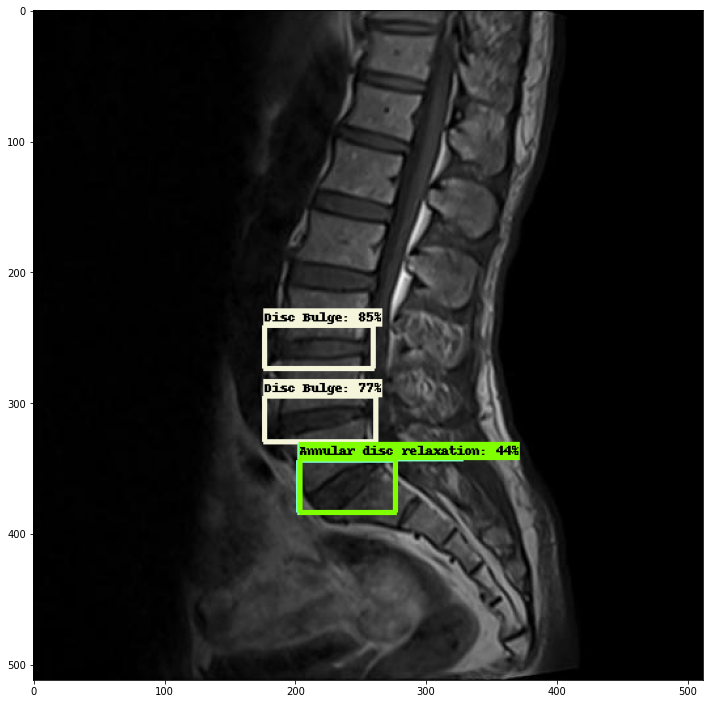

Unknown20-Unknown20-6-_jpg.rf.3d45e2b68078134534be6a9bb4d0d3c1.jpg


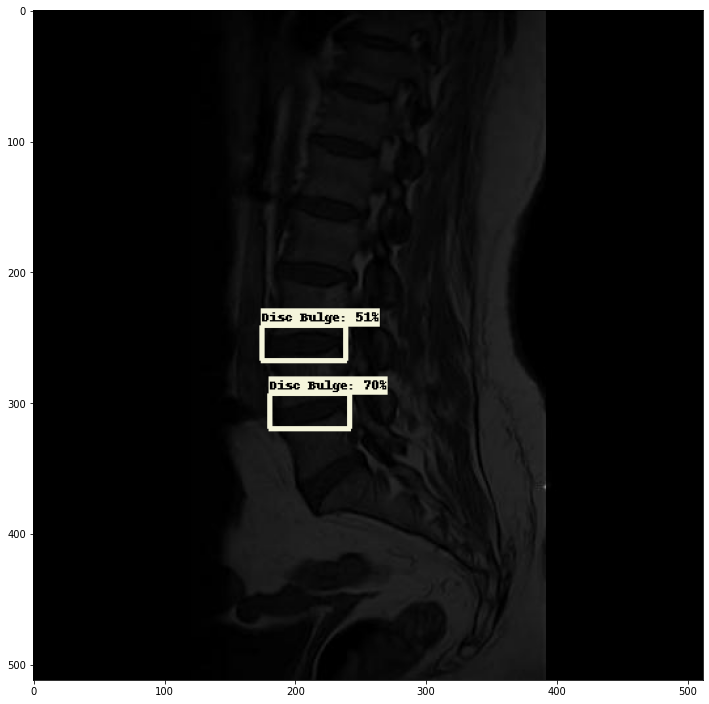

Unknown9--2-_jpg.rf.6d8838472d75b60cbde8337516cfd30f.jpg


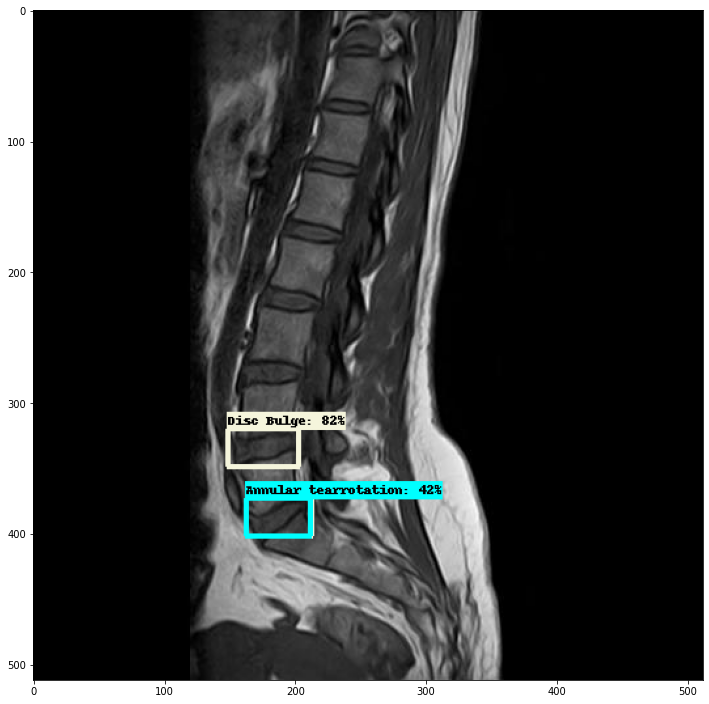

CervicalDegenerativeDiscDisease-EMAD-ABD-alhkm-ABD-ALHAKIM--3-_jpg.rf.86fbf5f1d62b0a3fac77f7d13c0fa584.jpg


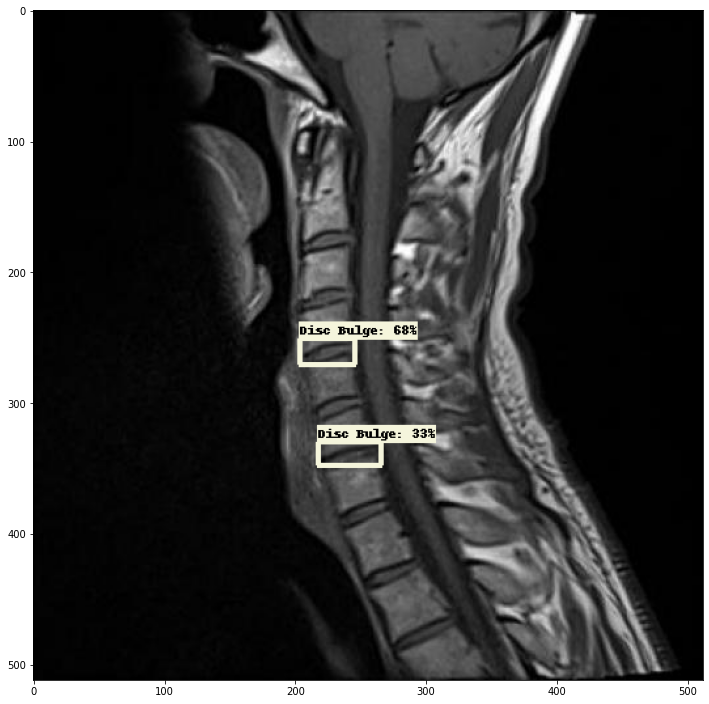

MONA-MAHMOUD-HASAN-MOHAMED-SHAABAN--14-_jpg.rf.7e58a8e37e8e881982a087d33383a7b6.jpg


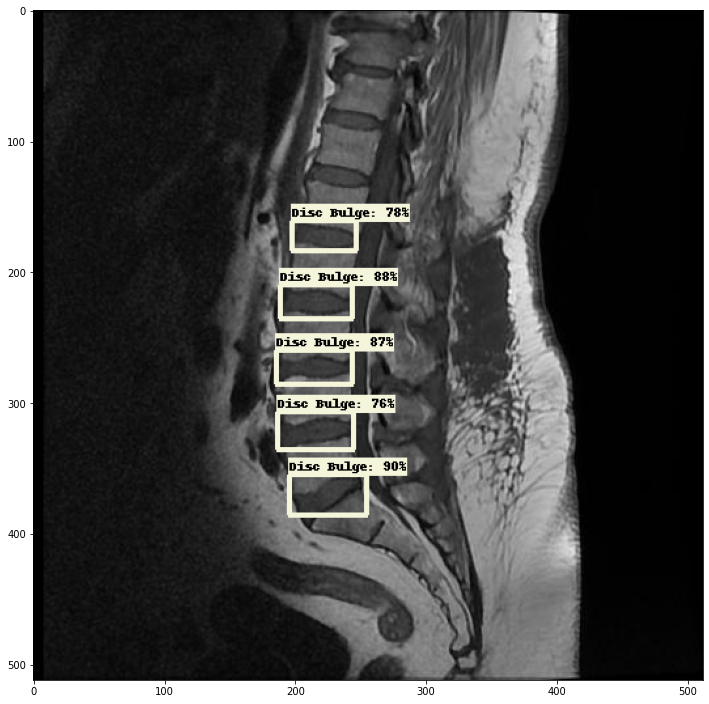

CervicalSpondylodegenerativeChanges-SAMMAH-MOSTAFA-KAMEL-MOHAMED--20-_jpg.rf.c4b30f08c3bf921143501cdcba69660a.jpg


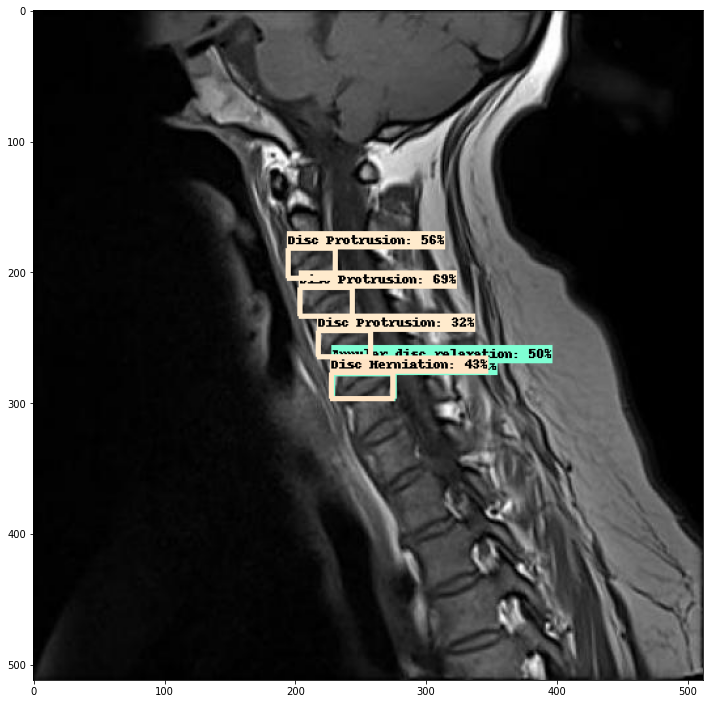

In [41]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
import random
from google.colab import files
TEST_IMAGE_PATHS = glob.glob('/content/test/test/*.jpg')
i=0
for image_path in TEST_IMAGE_PATHS:
  imName=image_path.rsplit('/')
  print(imName[4])
  image_np = load_image_into_numpy_array(image_path)

 # print(image_path)

  # Things to try:
  # Flip horizontally
  # image_np = np.fliplr(image_np).copy()

  # Convert image to grayscale
  # image_np = np.tile(
  #     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

  input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32) 
  detections, predictions_dict, shapes = detect_fn(input_tensor)  
  label_id_offset = 1 
  image_np_with_detections = image_np.copy()  
  # Use keypoints if available in detections 
  keypoints, keypoint_scores = None, None 
  if 'detection_keypoints' in detections:
    keypoints = detections['detection_keypoints'][0].numpy()
    keypoint_scores = detections['detection_keypoint_scores'][0].numpy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.30,
        agnostic_mode=False,
        keypoints=keypoints,
        keypoint_scores=keypoint_scores,
        #keypoint_edges=get_keypoint_tuples(configs['eval_config'])
        )
  plt.figure(figsize=(12,16)) 
  plt.imshow(image_np_with_detections) 
  cv2.imwrite('/content/Pred2/' +imName[4], image_np_with_detections)
  
  #plt.savefig('/content/Pred/' +imName[4])
  plt.show()
  #plt.savefig('/content/test/test/'+imName[4])
  